# Introduction to Deep Learning
## Assignment 1, Part 3

### Generative Models

<img src="https://lilianweng.github.io/lil-log/assets/images/three-generative-models.png" width="500">


In this notebook we are going to cover two generative models for generating novel images:

1. Variational Autoencoders (VAEs)
2. Generative adversarial networks (GANs)

Your main goal will be to retrain these models on a dataset of your choice and do some experiments on the learned latent space.

You should first copy this notebook and enable GPU runtime in 'Runtime -> Change runtime type -> Hardware acceleration -> GPU **OR** TPU'.


In [1]:
from tqdm import tqdm
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import warnings

from google.colab import drive
drive.mount('/content/drive', force_remount=True)


Mounted at /content/drive


## Here we import our Pokemon dataset, consisting of 800 64x64x3 images of pokemons

dataset can be found here: https://www.kaggle.com/datasets/daemonspade/pokemon-images

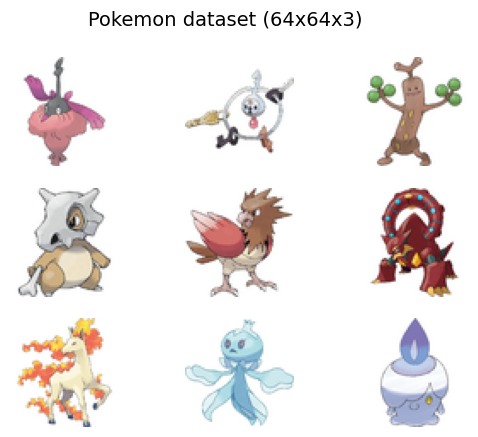

In [2]:
def load_real_samples(scale=False):
    # We load 20,000 samples only to avoid memory issues, you can  change this value
    X = np.load('/content/drive/My Drive/Colab Notebooks/pokemon_array.npy',  fix_imports=True,encoding='latin1')[:20000, :, :, :]
    # Scale samples in range [-127, 127]
    if scale:
        X = (X - 127.5) * 2
    return X / 255.

# We will use this function to display the output of our models throughout this notebook
def grid_plot(images, epoch='', name='', n=3, save=False, scale=False):
    if scale:
        images = (images + 1) / 2.0
    for index in range(n * n):
        plt.subplot(n, n, 1 + index)
        plt.axis('off')
        plt.imshow(images[index])
    fig = plt.gcf()
    fig.suptitle(name + '  '+ str(epoch), fontsize=14)
    if save:
        filename = 'results/generated_plot_e%03d_f.png' % (epoch+1)
        plt.savefig(filename)
        plt.close()
    plt.show()


dataset = load_real_samples()
grid_plot(dataset[np.random.randint(0, len(dataset), 9)], name='Pokemon dataset (64x64x3)', n=3)

## Data augmentation
We augmented the limited dataset with rotated and flipped versions of the original images to increase GAN convergence.

In [3]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(
    rotation_range=40,       # randomly rotate images in the range (degrees, 0 to 180)
    horizontal_flip=True,   # randomly flip images
    fill_mode='nearest'     # set mode for filling points outside the input boundaries
)

datagen.fit(dataset)

augmented_data = []
for _ in range(5):
    for x_batch in datagen.flow(dataset, batch_size=len(dataset), shuffle=False):
        augmented_data.extend(x_batch)
        break

augmented_data = np.array(augmented_data)



In [ ]:
len(augmented_data)

4095

## 2.1. Introduction

The generative models that we are going to cover both have the following components:

1. A downsampling architecture (encoder in case of VAE, and discriminator in case of GAN) to either extract features from the data or model its distribution.
2. An upsampling architecture (decoder for VAE, generator for GAN) that will use some kind of latent vector to generate new samples that resemble the data that it was trained on.

Since we are going to be dealing with images, we are going to use convolutional networks for upsampling and downsampling, similar to what you see below.

<img src="https://i2.wp.com/sefiks.com/wp-content/uploads/2018/03/convolutional-autoencoder.png" width="500">


#### Code for building these components:

In [4]:
from tensorflow.keras.layers import Dense, Flatten, Conv2D, Conv2DTranspose, Reshape

def build_conv_net(in_shape, out_shape, n_downsampling_layers=4, filters=128, out_activation='sigmoid'):
    """
    Build a basic convolutional network
    """
    model = tf.keras.Sequential()
    default_args=dict(kernel_size=(3,3), strides=(2,2), padding='same', activation='relu')

    model.add(Conv2D(input_shape=in_shape, **default_args, filters=filters))

    for _ in range(n_downsampling_layers):
        model.add(Conv2D(**default_args, filters=filters))

    model.add(Flatten())
    model.add(Dense(out_shape, activation=out_activation) )
    model.summary()
    return model


def build_deconv_net(latent_dim, n_upsampling_layers=4, filters=128, activation_out='sigmoid'):
    """
    Build a deconvolutional network for decoding/upscaling latent vectors

    When building the deconvolutional architecture, usually it is best to use the same layer sizes that
    were used in the downsampling network and the Conv2DTranspose layers are used instead of Conv2D layers.
    Using identical layers and hyperparameters ensures that the dimensionality of our output matches the
    shape of our input images.
    """

    model = tf.keras.Sequential()
    model.add(Dense(4 * 4 * 64, input_dim=latent_dim))
    model.add(Reshape((4, 4, 64))) # This matches the output size of the downsampling architecture
    default_args=dict(kernel_size=(3,3), strides=(2,2), padding='same', activation='relu')

    for i in range(n_upsampling_layers):
        model.add(Conv2DTranspose(**default_args, filters=filters))

    # This last convolutional layer converts back to 3 channel RGB image
    model.add(Conv2D(filters=3, kernel_size=(3,3), activation=activation_out, padding='same'))
    model.summary()
    return model

### Convolutional Autoencoder example

Using these two basic building blocks we can now build a Convolutional Autoencoder (CAE).

<img src="https://lilianweng.github.io/lil-log/assets/images/autoencoder-architecture.png" width="500">



Even though it's not a generative model, CAE is a great way to illustrate how these two components (convolutional and deconvolutional networks) can be used together to reconstruct images.

You can view such model as a compression/dimensionality reduction method as each image gets compressed to a vector of 256 numbers by the encoder and gets decompressed back into an image using the decoder network.

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 32, 32, 128)       3584      
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 128)       147584    
                                                                 
 conv2d_2 (Conv2D)           (None, 8, 8, 128)         147584    
                                                                 
 conv2d_3 (Conv2D)           (None, 4, 4, 128)         147584    
                                                                 
 conv2d_4 (Conv2D)           (None, 2, 2, 128)         147584    
                                                                 
 flatten (Flatten)           (None, 512)               0         
                                                                 
 dense (Dense)               (None, 512)               2

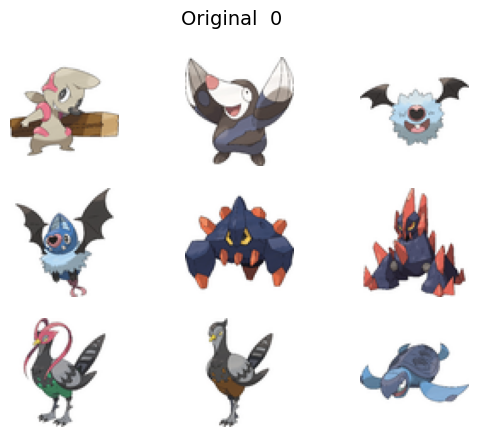

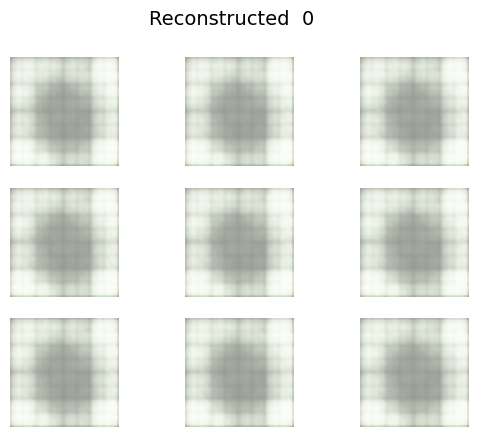


Epoch:  1
1/1 [==============================] - 0s 93ms/step


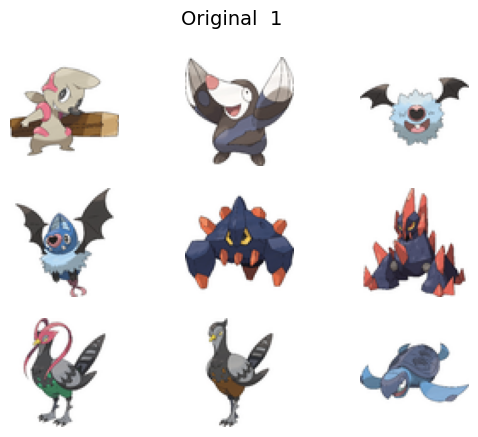

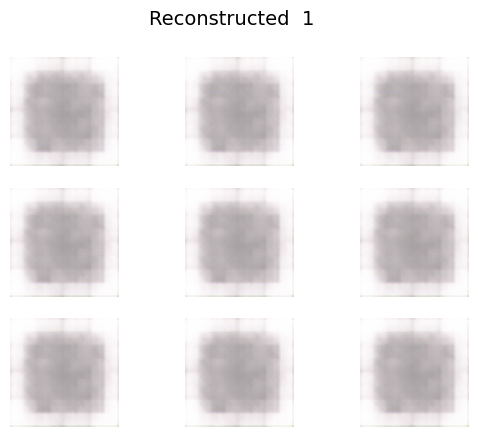


Epoch:  2
1/1 [==============================] - 0s 195ms/step


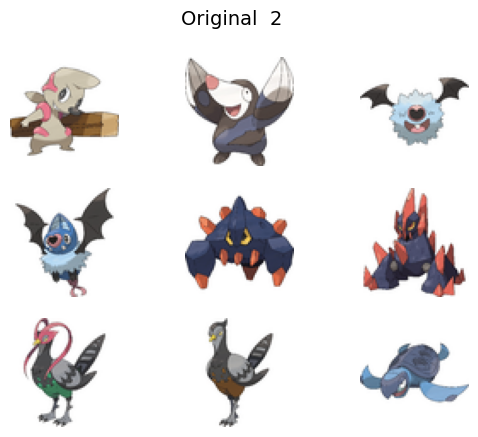

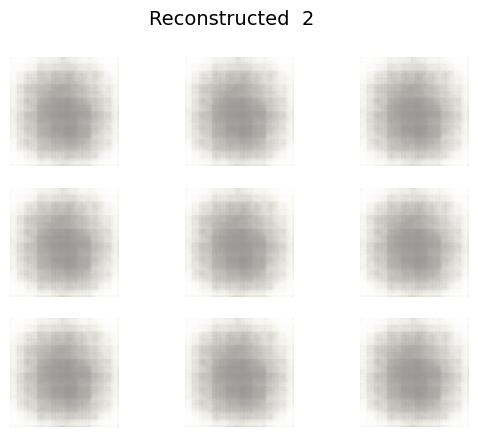


Epoch:  3
1/1 [==============================] - 0s 40ms/step


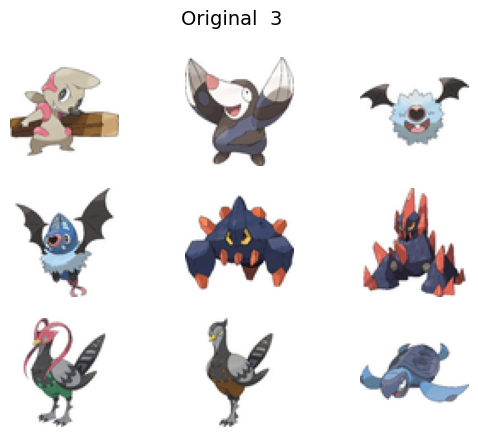

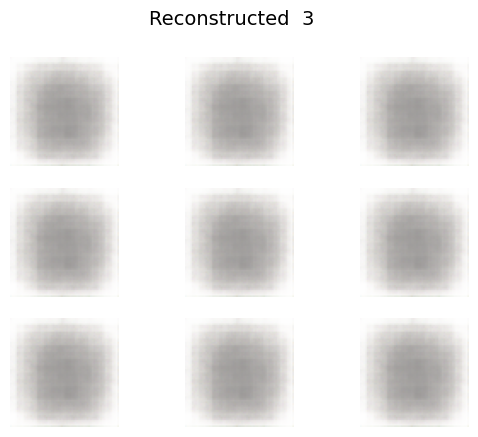


Epoch:  4
1/1 [==============================] - 0s 28ms/step


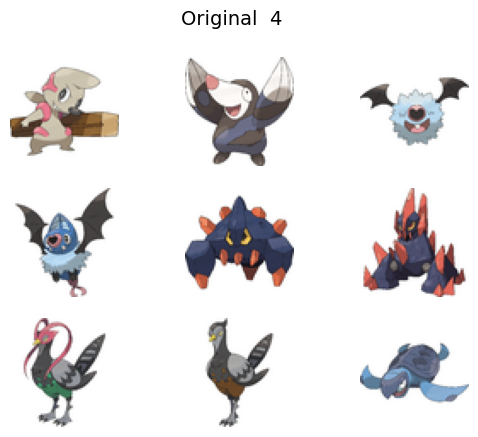

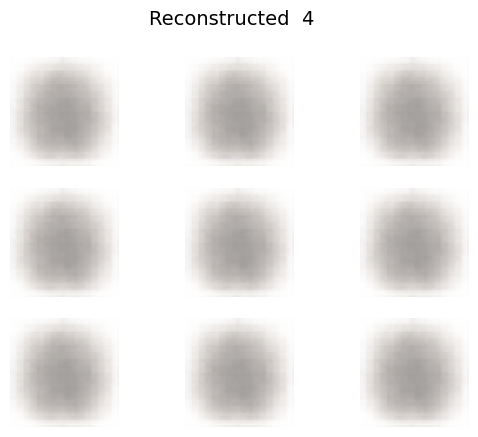


Epoch:  5
1/1 [==============================] - 0s 22ms/step


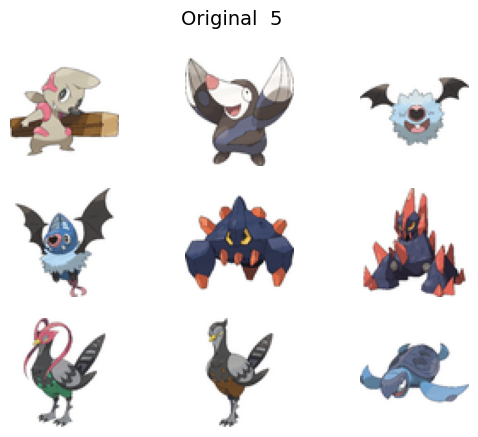

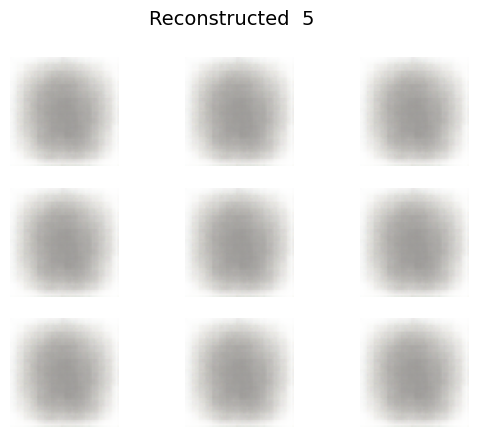


Epoch:  6
1/1 [==============================] - 0s 29ms/step


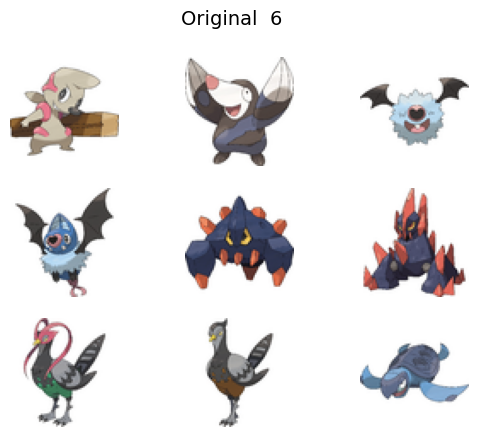

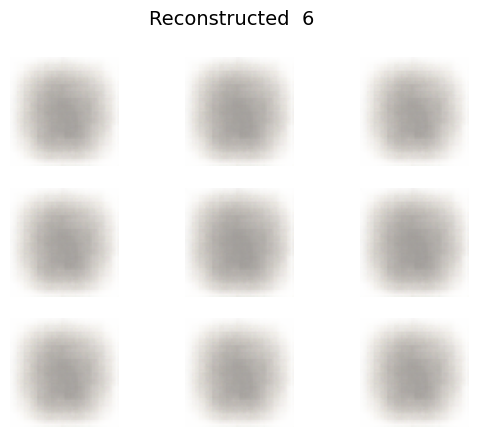


Epoch:  7
1/1 [==============================] - 0s 60ms/step


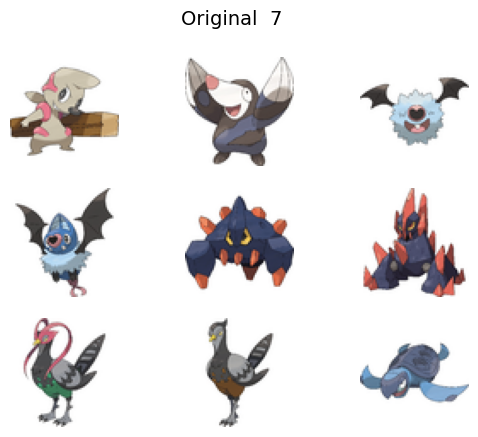

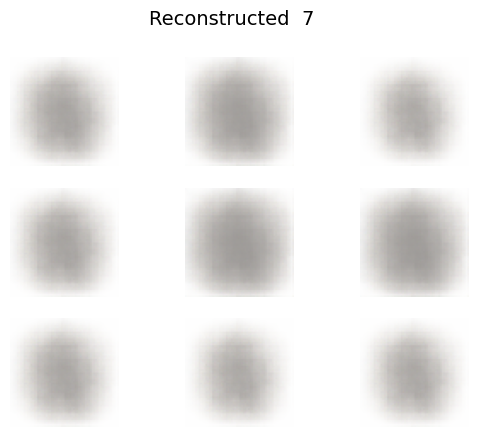


Epoch:  8
1/1 [==============================] - 0s 20ms/step


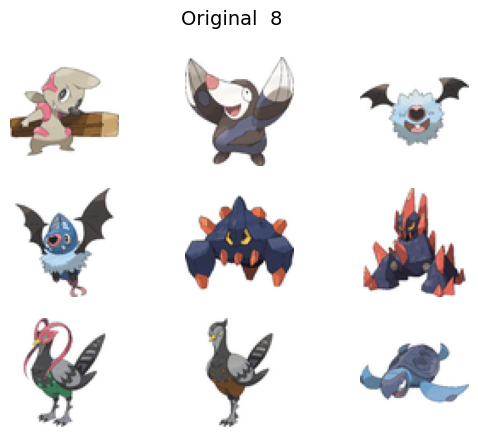

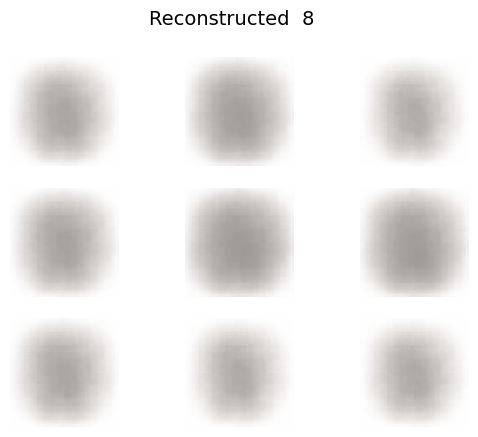


Epoch:  9
1/1 [==============================] - 0s 28ms/step


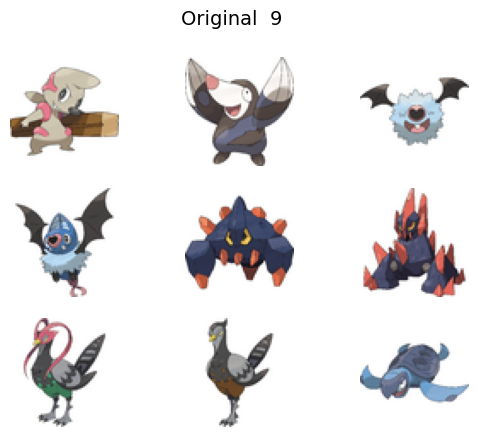

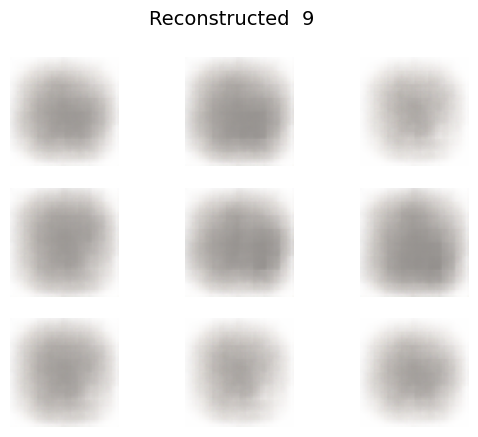


Epoch:  10
1/1 [==============================] - 0s 19ms/step


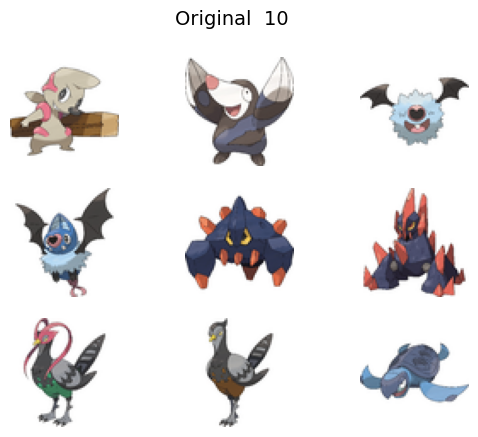

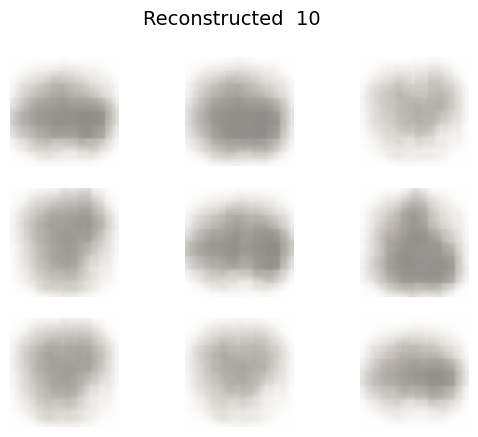


Epoch:  11
1/1 [==============================] - 0s 21ms/step


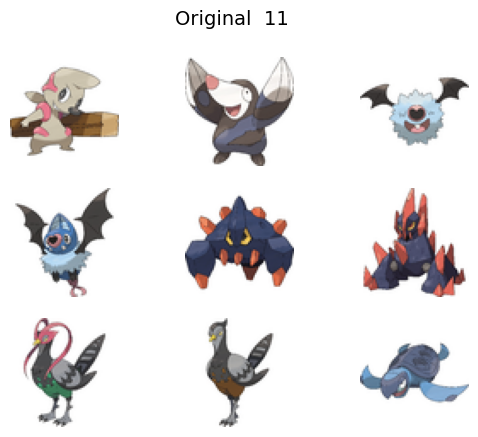

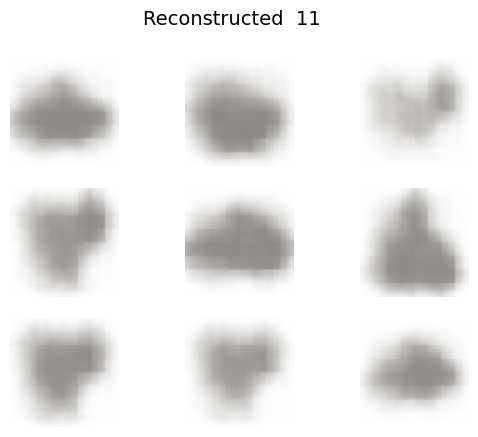


Epoch:  12
1/1 [==============================] - 0s 44ms/step


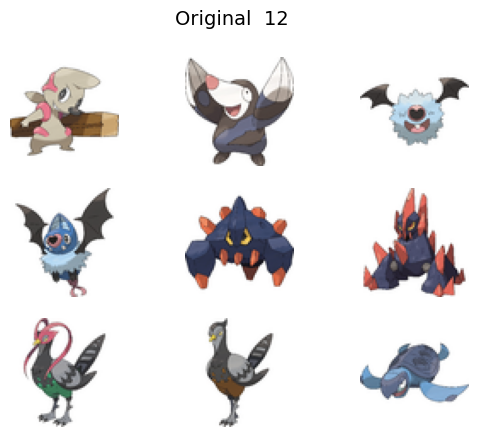

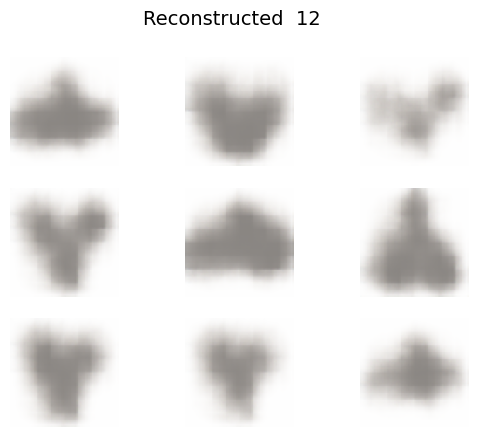


Epoch:  13
1/1 [==============================] - 0s 28ms/step


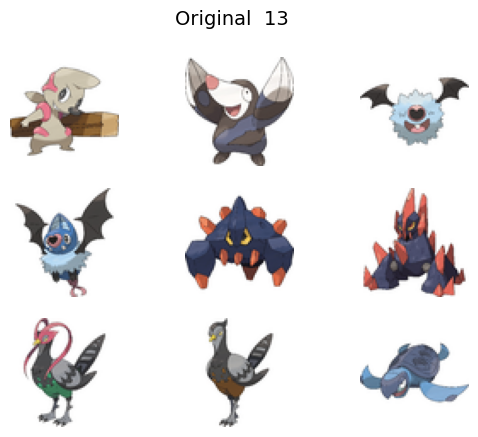

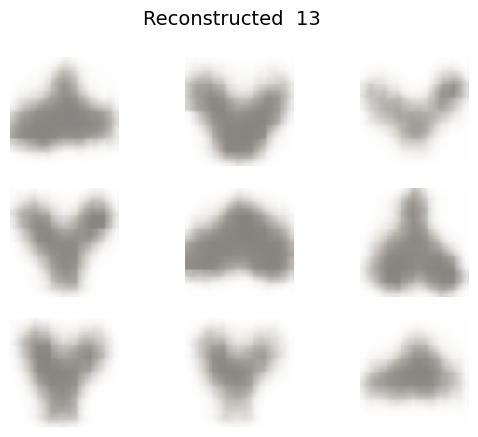


Epoch:  14
1/1 [==============================] - 0s 33ms/step


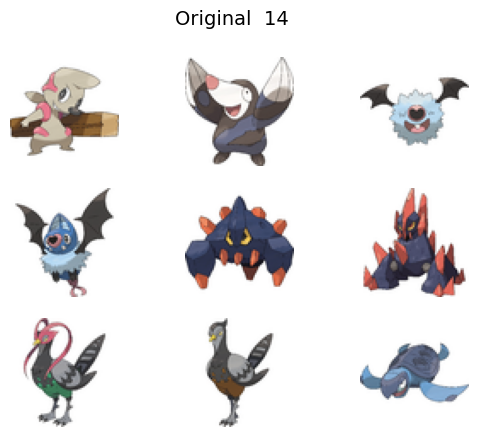

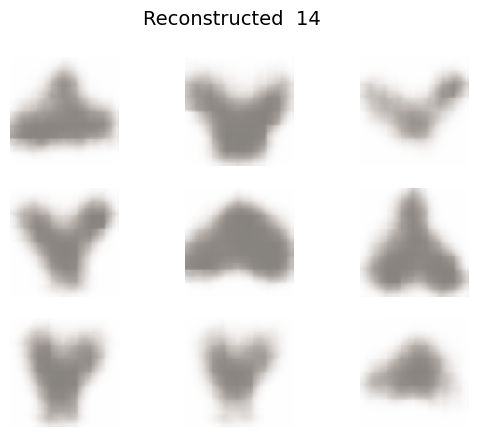


Epoch:  15
1/1 [==============================] - 0s 30ms/step


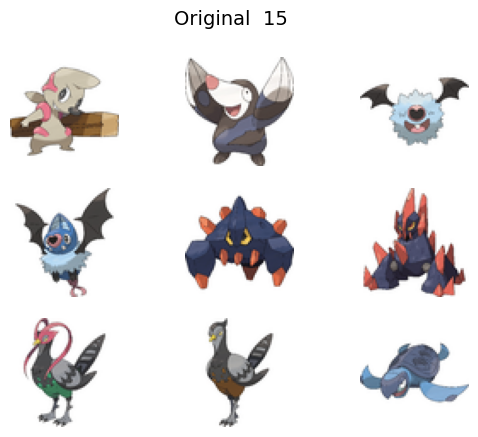

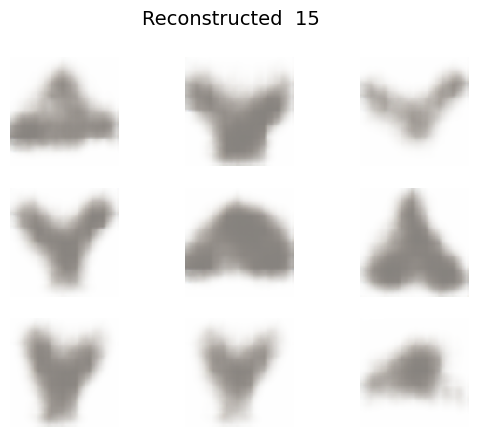


Epoch:  16
1/1 [==============================] - 0s 19ms/step


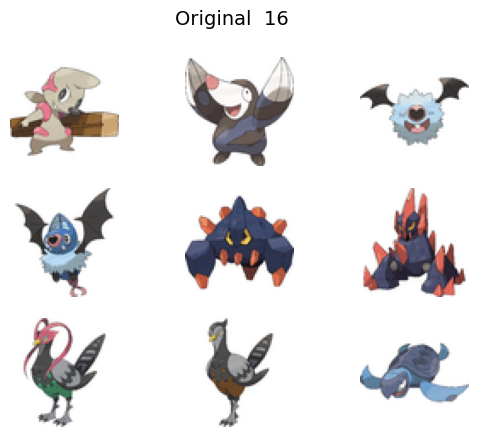

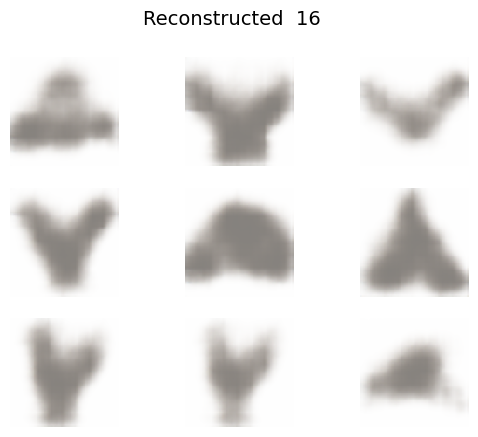


Epoch:  17
1/1 [==============================] - 0s 30ms/step


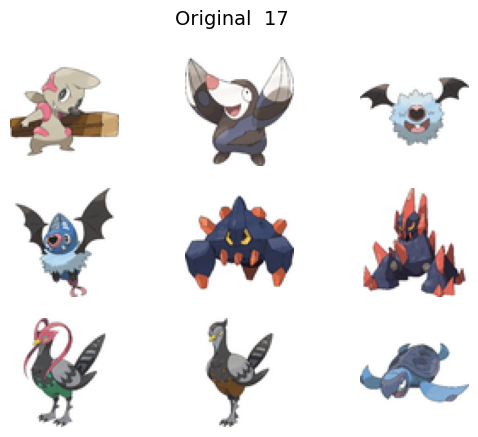

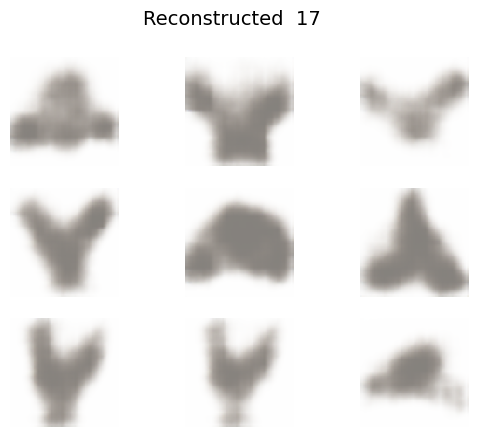


Epoch:  18
1/1 [==============================] - 0s 28ms/step


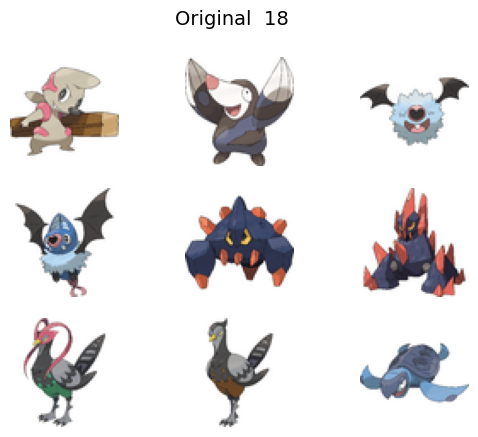

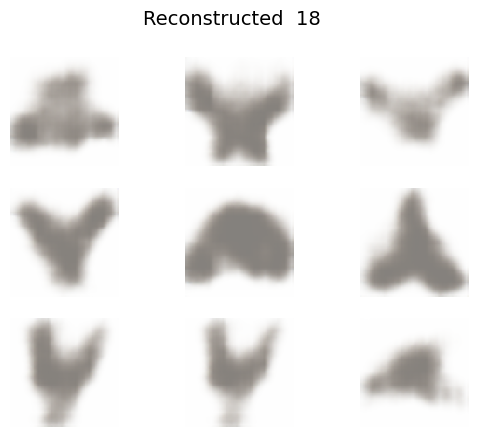


Epoch:  19
1/1 [==============================] - 0s 45ms/step


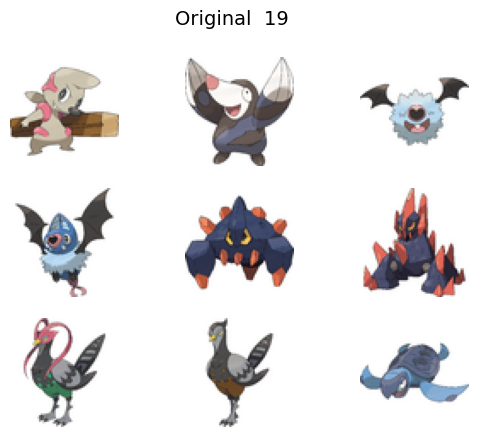

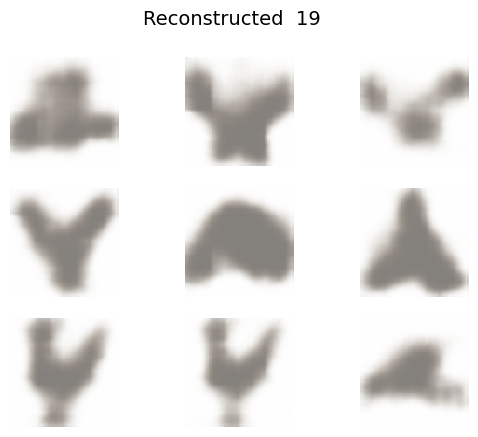


Epoch:  20
1/1 [==============================] - 0s 47ms/step


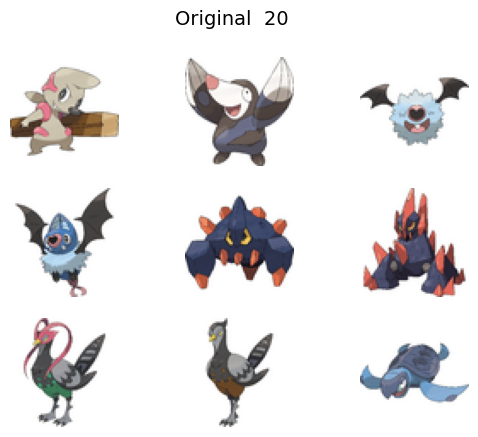

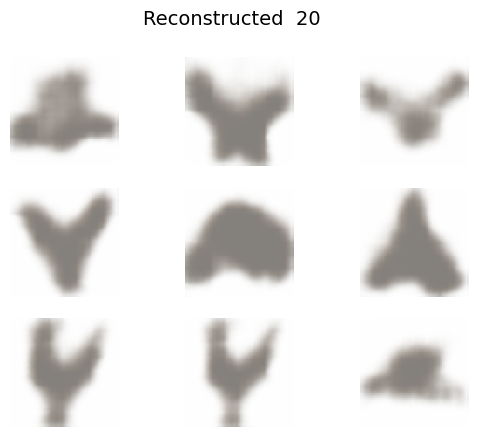


Epoch:  21
1/1 [==============================] - 0s 18ms/step


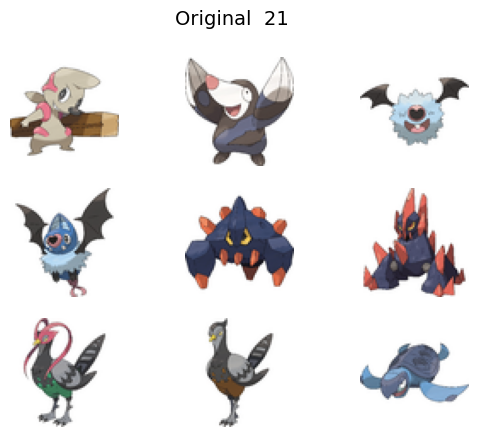

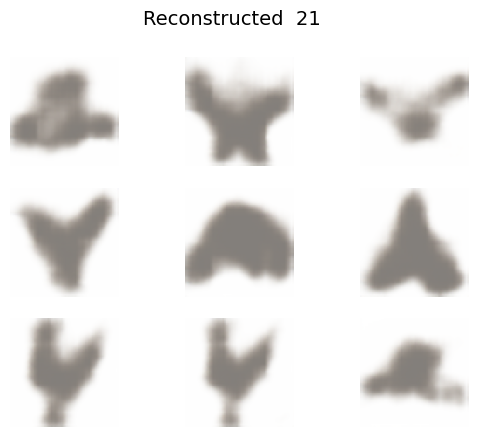


Epoch:  22
1/1 [==============================] - 0s 19ms/step


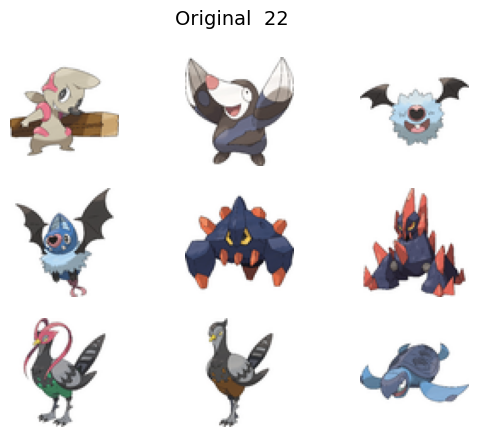

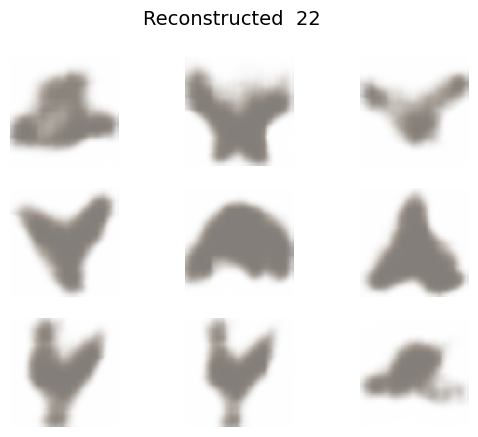


Epoch:  23
1/1 [==============================] - 0s 20ms/step


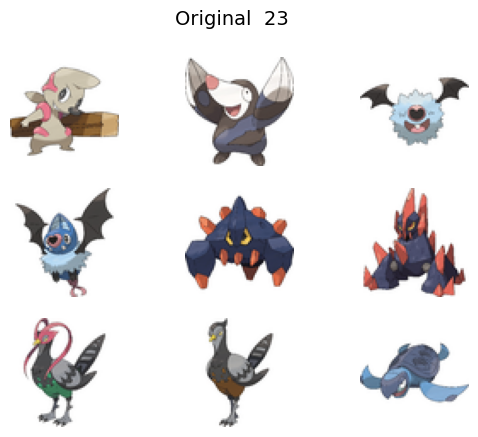

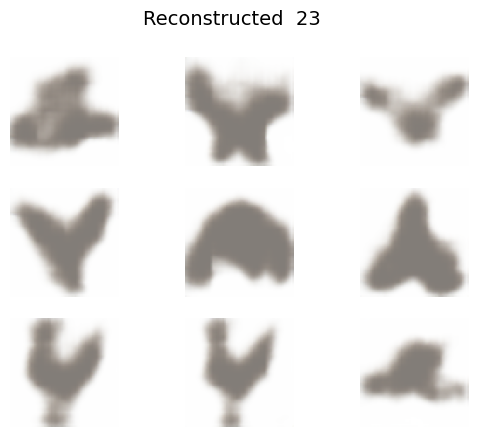


Epoch:  24
1/1 [==============================] - 0s 27ms/step


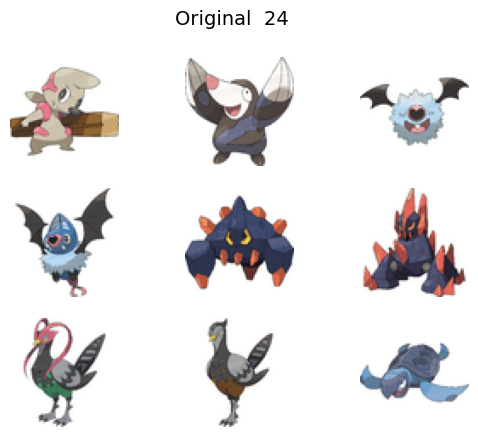

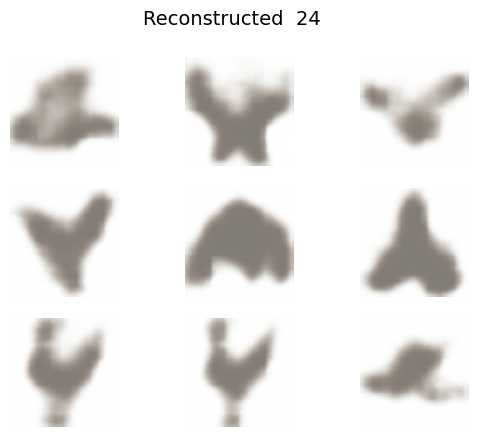


Epoch:  25
1/1 [==============================] - 0s 19ms/step


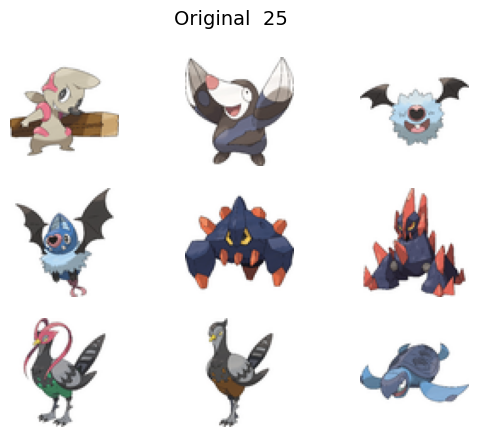

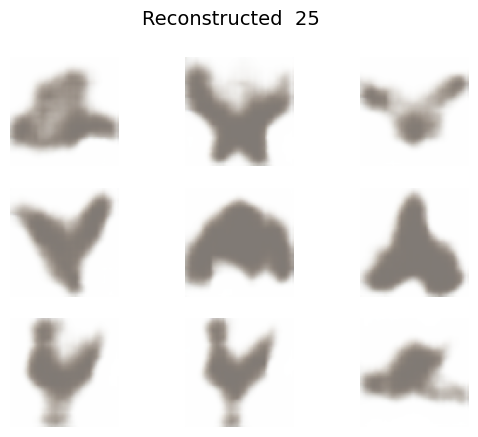


Epoch:  26
1/1 [==============================] - 0s 44ms/step


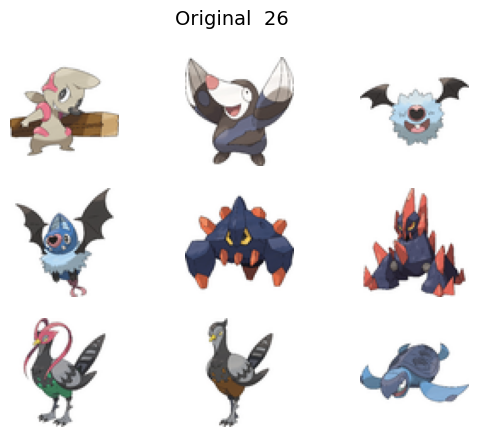

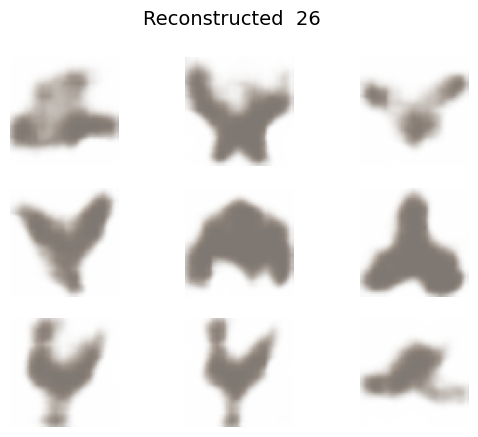


Epoch:  27
1/1 [==============================] - 0s 46ms/step


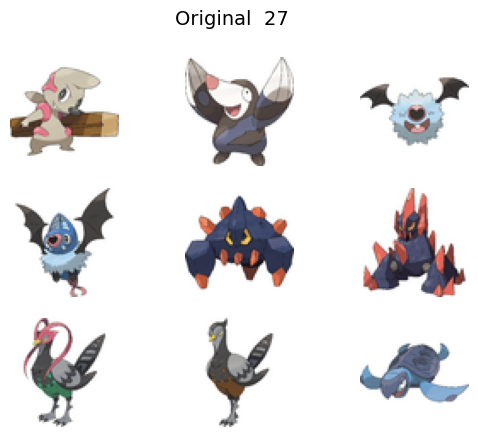

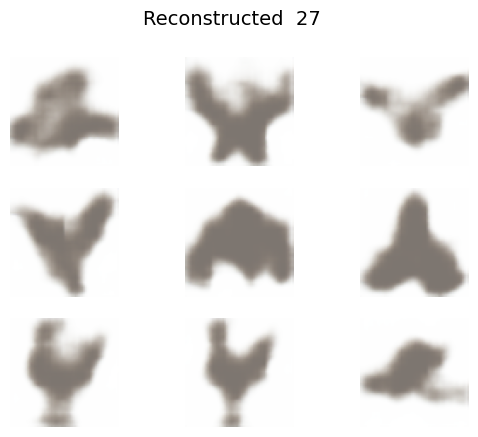


Epoch:  28
1/1 [==============================] - 0s 25ms/step


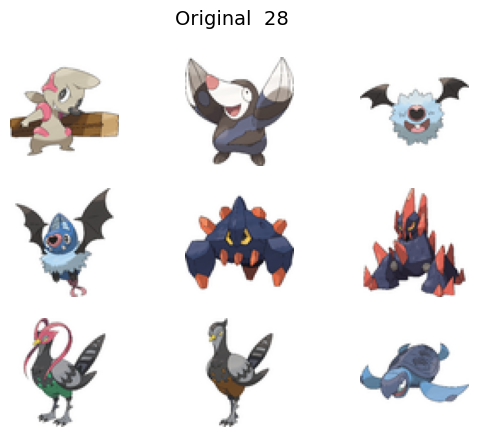

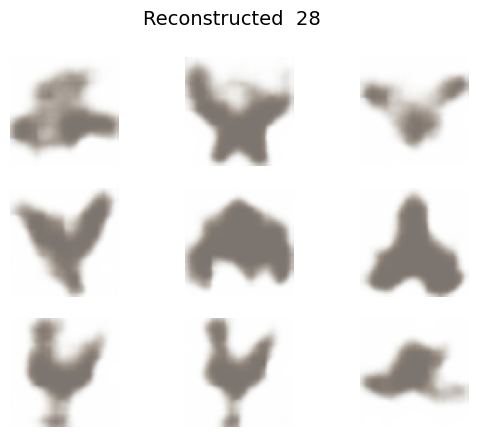


Epoch:  29
1/1 [==============================] - 0s 35ms/step


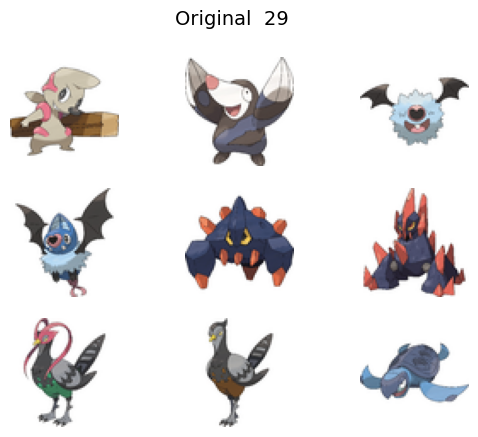

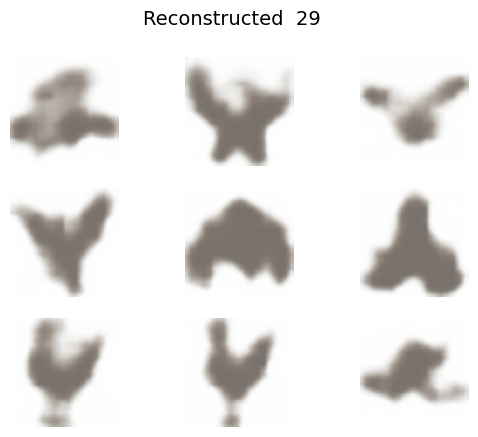


Epoch:  30
1/1 [==============================] - 0s 26ms/step


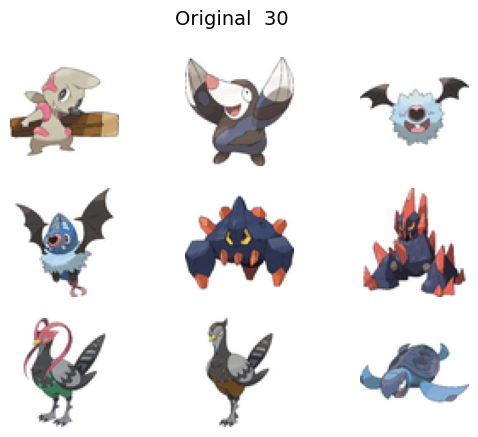

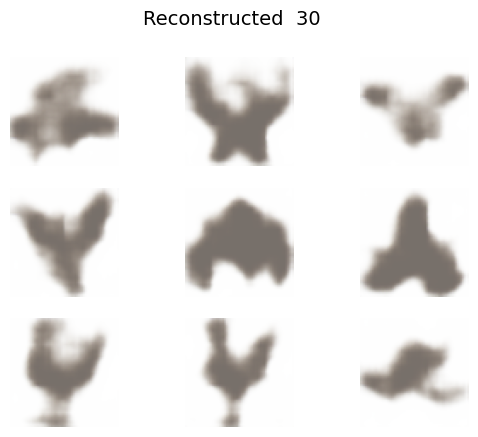


Epoch:  31
1/1 [==============================] - 0s 35ms/step


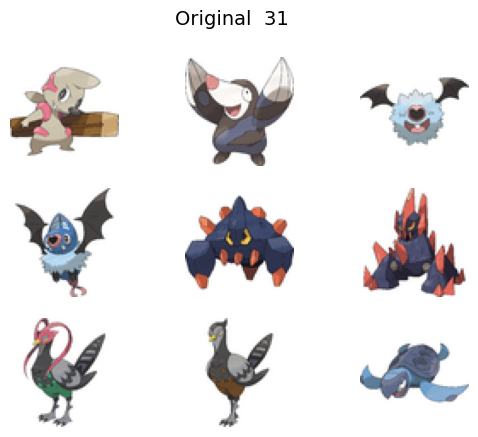

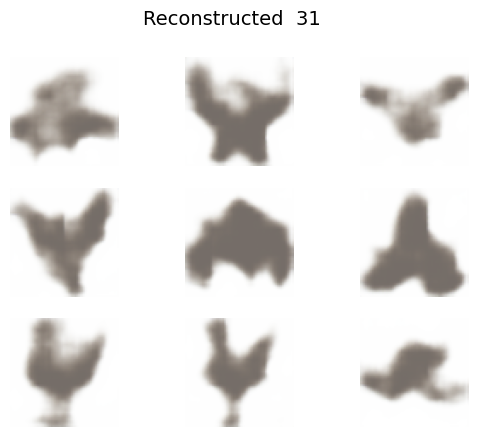


Epoch:  32
1/1 [==============================] - 0s 41ms/step


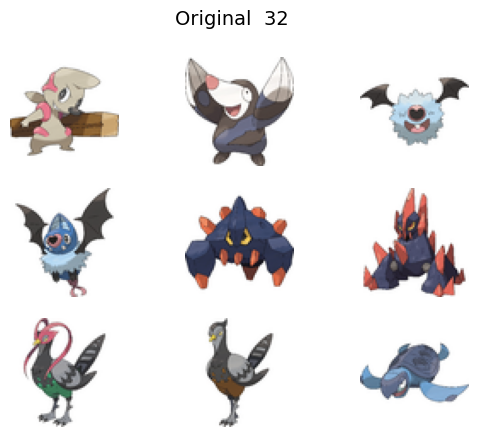

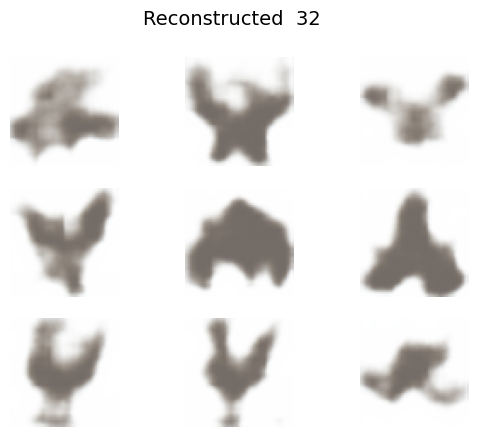


Epoch:  33
1/1 [==============================] - 0s 43ms/step


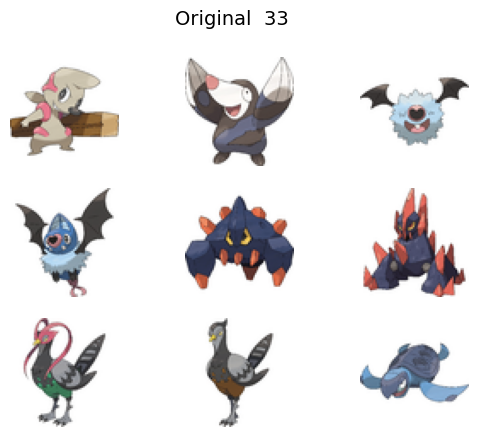

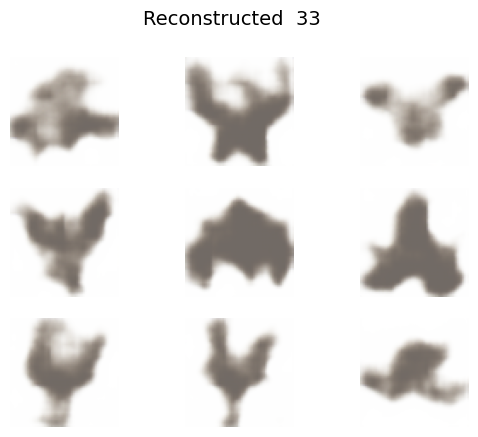


Epoch:  34
1/1 [==============================] - 0s 30ms/step


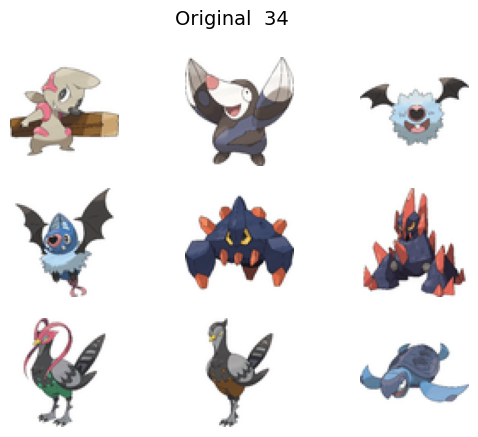

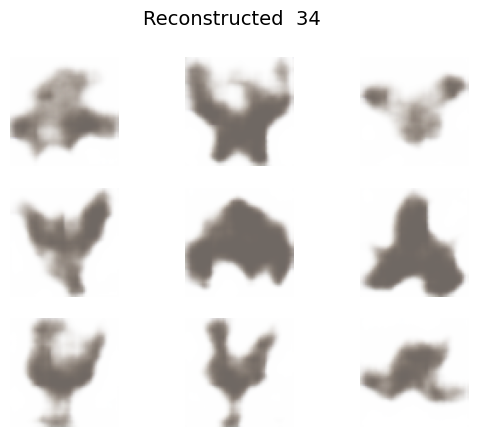


Epoch:  35
1/1 [==============================] - 0s 28ms/step


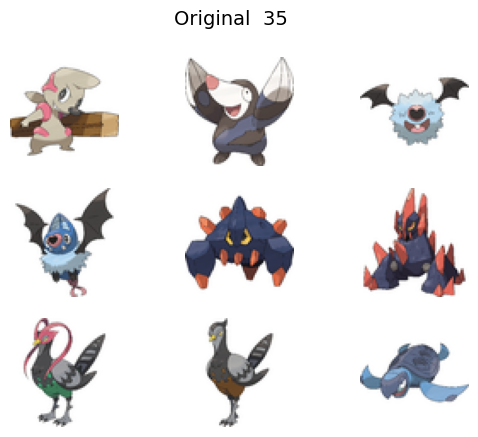

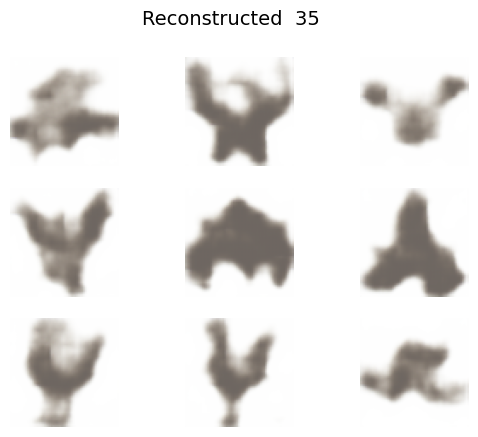


Epoch:  36
1/1 [==============================] - 0s 28ms/step


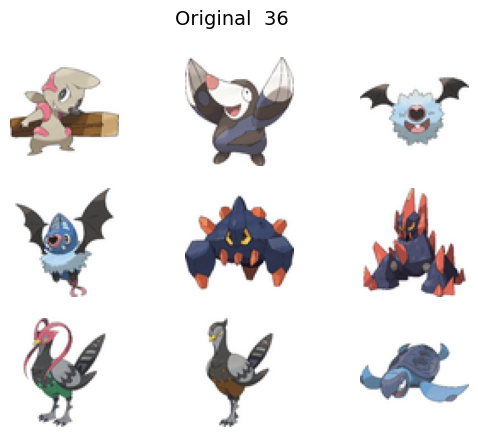

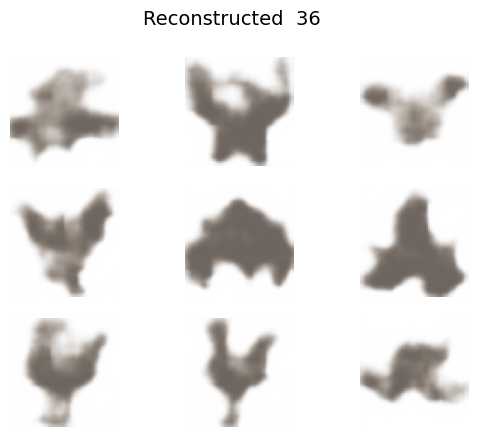


Epoch:  37
1/1 [==============================] - 0s 31ms/step


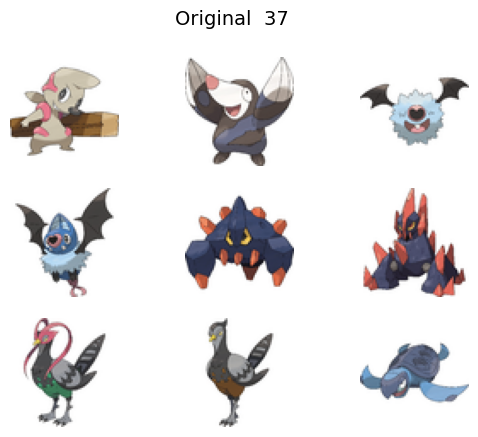

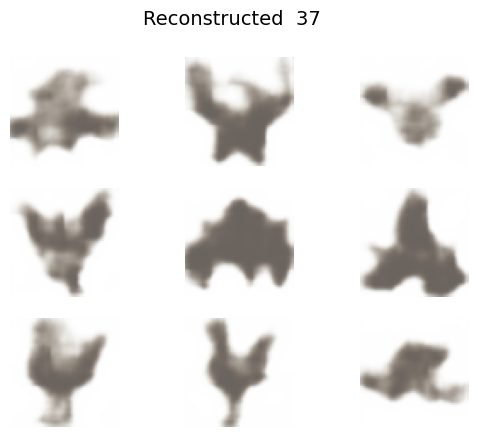


Epoch:  38
1/1 [==============================] - 0s 60ms/step


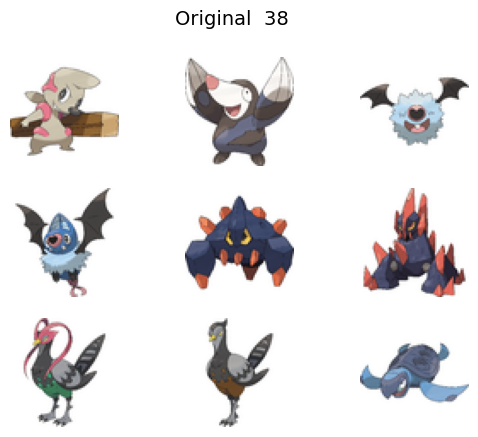

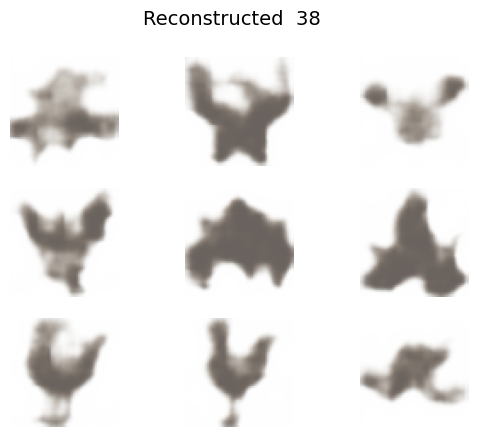


Epoch:  39
1/1 [==============================] - 0s 45ms/step


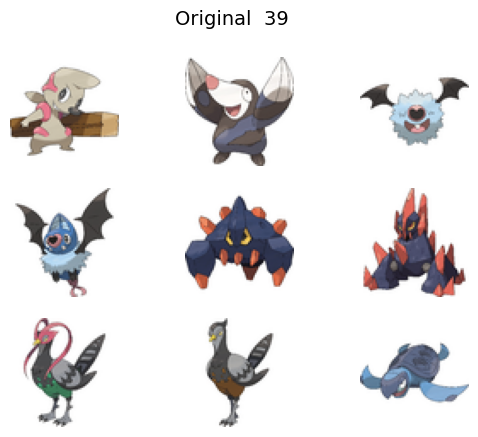

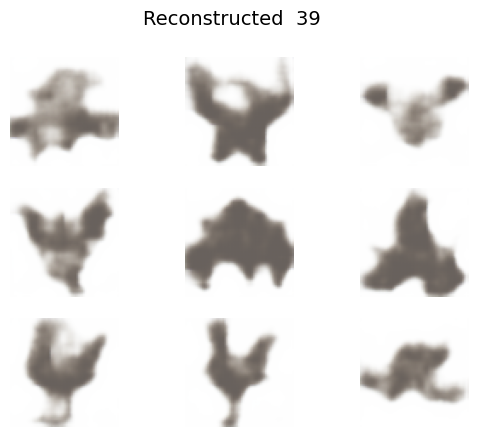


Epoch:  40
1/1 [==============================] - 0s 28ms/step


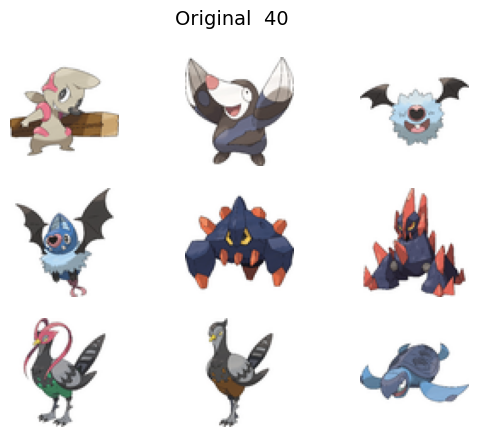

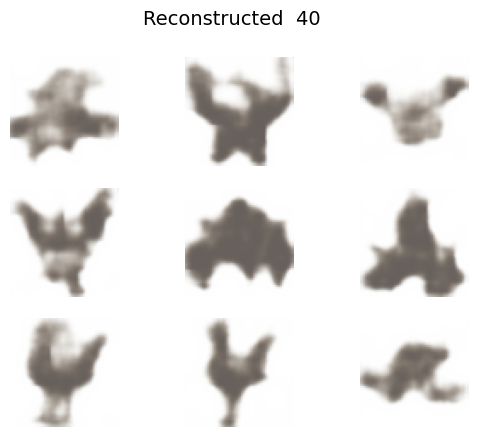


Epoch:  41
1/1 [==============================] - 0s 27ms/step


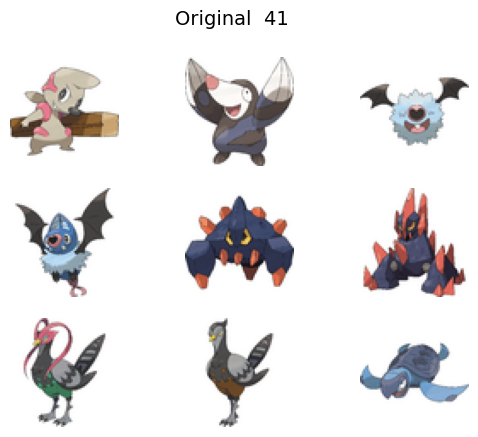

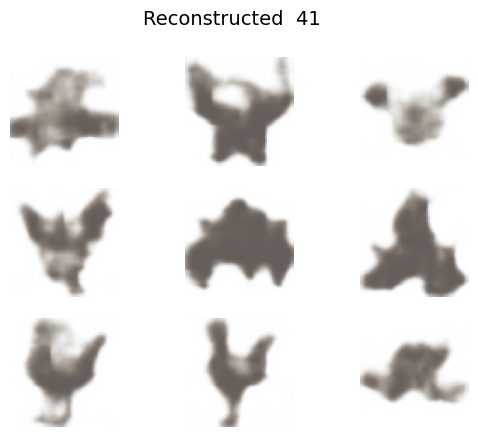


Epoch:  42
1/1 [==============================] - 0s 39ms/step


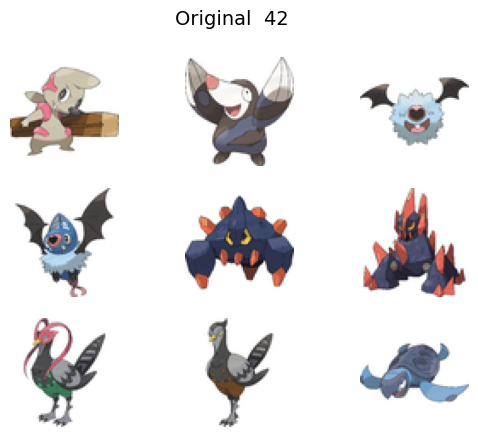

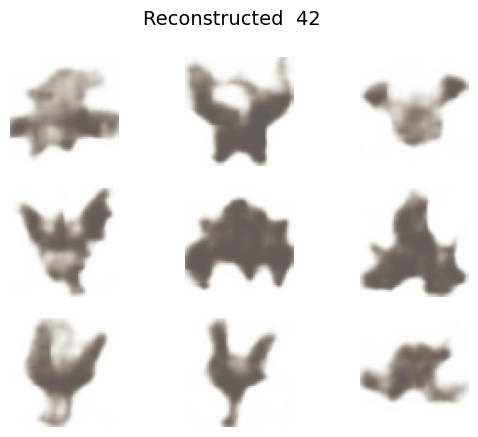


Epoch:  43
1/1 [==============================] - 0s 109ms/step


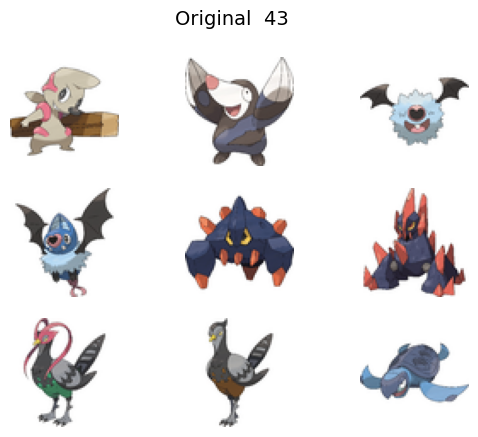

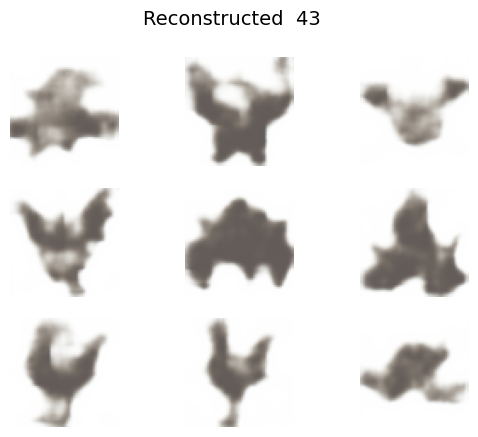


Epoch:  44
1/1 [==============================] - 0s 58ms/step


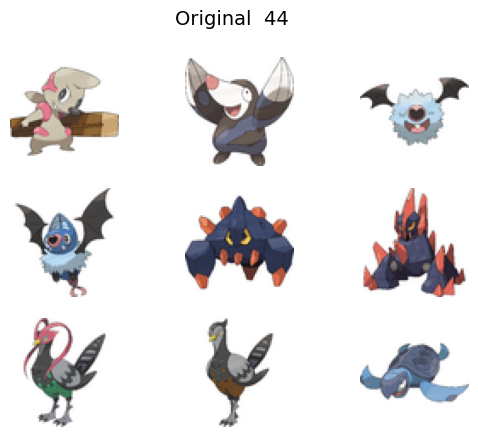

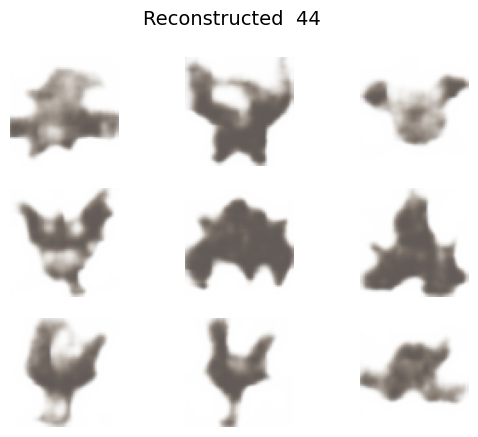


Epoch:  45
1/1 [==============================] - 0s 50ms/step


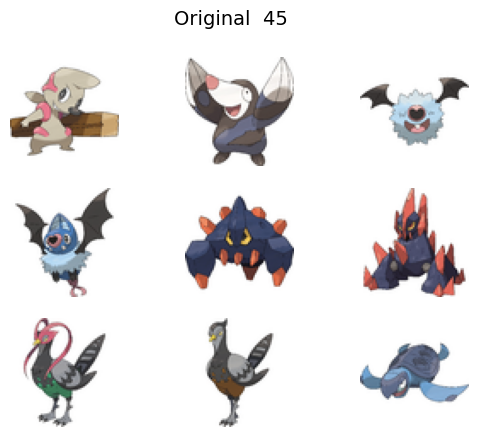

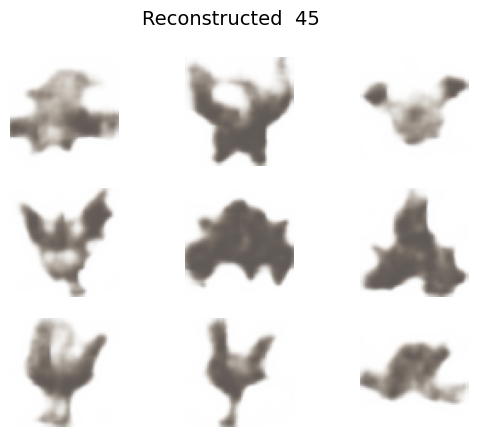


Epoch:  46
1/1 [==============================] - 0s 42ms/step


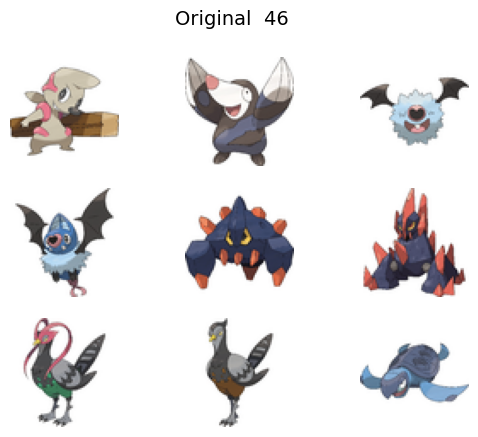

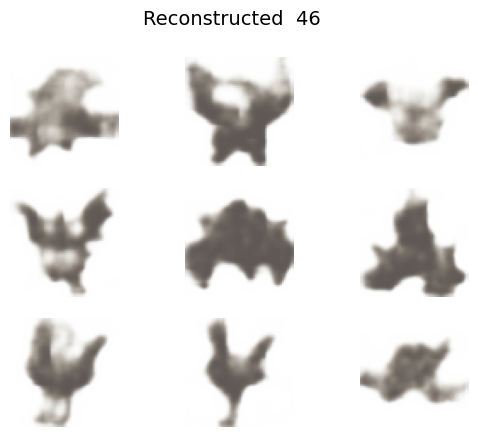


Epoch:  47
1/1 [==============================] - 0s 32ms/step


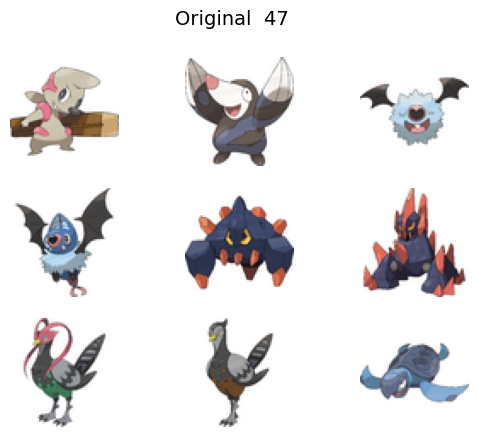

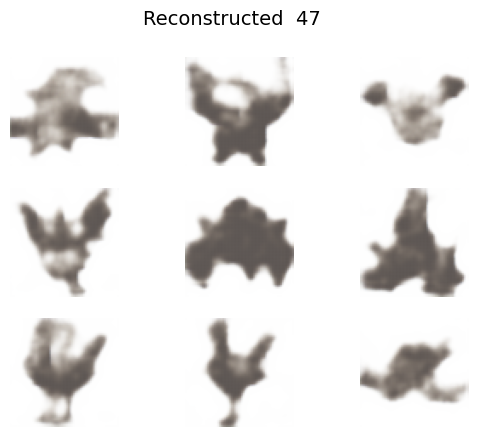


Epoch:  48
1/1 [==============================] - 0s 28ms/step


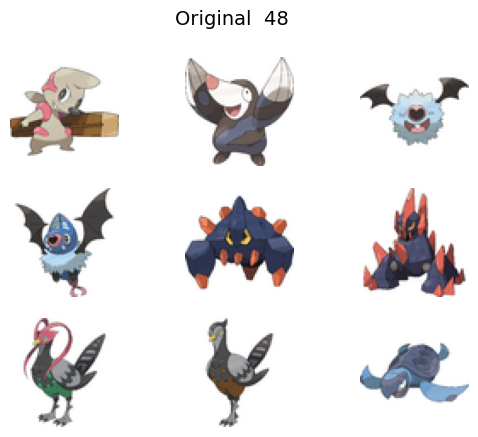

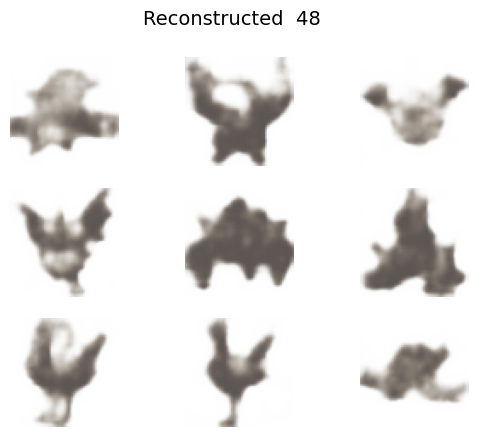


Epoch:  49
1/1 [==============================] - 0s 27ms/step


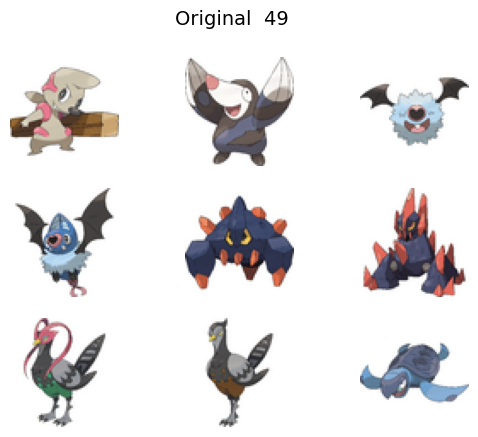

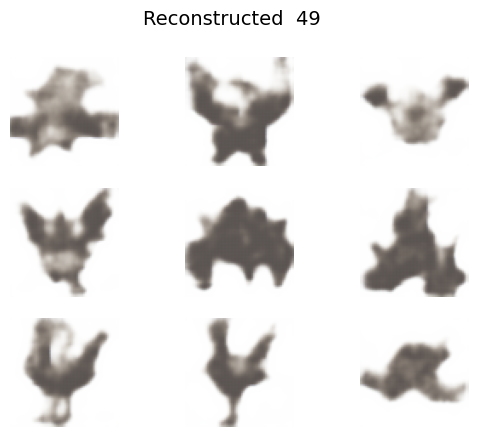

In [5]:
def build_convolutional_autoencoder(data_shape, latent_dim, filters=128):
    encoder = build_conv_net(in_shape=data_shape, out_shape=latent_dim, filters=filters)
    decoder = build_deconv_net(latent_dim, activation_out='sigmoid', filters=filters)

    # We connect encoder and decoder into a single model
    autoencoder = tf.keras.Sequential([encoder, decoder])

    # Binary crossentropy loss - pairwise comparison between input and output pixels
    autoencoder.compile(loss='binary_crossentropy', optimizer='adam')

    return autoencoder


# Defining the model dimensions and building it
image_size = dataset.shape[1:]
latent_dim = 512
num_filters = 128
cae = build_convolutional_autoencoder(image_size, latent_dim, num_filters)

for epoch in range(50):
    print('\nEpoch: ', epoch)

    # Note that (X=y) when training autoencoders!
    # In this case we only care about qualitative performance, we don't split into train/test sets
    cae.fit(x=dataset, y=dataset, epochs=1, batch_size=64)

    samples = dataset[:9]
    reconstructed = cae.predict(samples)
    grid_plot(samples, epoch, name='Original', n=3, save=False)
    grid_plot(reconstructed, epoch, name='Reconstructed', n=3, save=False)

---
---


## 2. 2. Variational Autoencoders (VAEs)

<img src="https://lilianweng.github.io/lil-log/assets/images/vae-gaussian.png" width="500">

#### Encoder network
This defines the approximate posterior distribution, which takes as input an observation and outputs a set of parameters for specifying the conditional distribution of the latent representation. In this example, we simply model the distribution as a diagonal Gaussian, and the network outputs the mean and log-variance parameters of a factorized Gaussian. We output log-variance instead of the variance directly for numerical stability.

#### Decoder network
This defines the conditional distribution of the observation $z$, which takes a latent sample $z$ as input and outputs the parameters for a conditional distribution of the observation. We model the latent distribution prior  as a unit Gaussian.

#### Reparameterization trick
To generate a sample  for the decoder during training, we can sample from the latent distribution defined by the parameters outputted by the encoder, given an input observation $z$. However, this sampling operation creates a bottleneck because backpropagation cannot flow through a random node.

To address this, we use a reparameterization trick. In our example, we approximate  using the decoder parameters and another parameter  as follows:

$$z = \mu + \sigma\epsilon$$

where $\mu$ and $\sigma$  represent the mean and standard deviation of a Gaussian distribution respectively. They can be derived from the decoder output. The  can be thought of as a random noise used to maintain stochasticity of $z$. We generate  from a standard normal distribution.

The latent variable  is now generated by a function of $\mu$ and $\sigma$ which would enable the model to backpropagate gradients in the encoder through $\mu$ and $\sigma$ respectively, while maintaining stochasticity through $\epsilon$.

#### Implementation

You can see how this trick is implemented below by creating a custom layer by sublassing tf.keras.layers.Layer.
It is then connected to the output of the original encoder architecture and an additional [KL](https://en.wikipedia.org/wiki/Kullback–Leibler_divergence) loss term is introduced.


In [6]:
class Sampling(tf.keras.layers.Layer):
    """
    Custom layer for the variational autoencoder
    It takes two vectors as input - one for means and other for variances of the latent variables described by a multimodal gaussian
    Its output is a latent vector randomly sampled from this distribution
    """
    def call(self, inputs):
        z_mean, z_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_var) * epsilon

def build_vae(data_shape, latent_dim, filters=128):

    # Building the encoder - starts with a simple downsampling convolutional network
    encoder = build_conv_net(data_shape, latent_dim*2, filters=filters)

    # Adding special sampling layer that uses the reparametrization trick
    z_mean = Dense(latent_dim)(encoder.output)
    z_var = Dense(latent_dim)(encoder.output)
    z = Sampling()([z_mean, z_var])

    # Connecting the two encoder parts
    encoder = tf.keras.Model(inputs=encoder.input, outputs=z)

    # Defining the decoder which is a regular upsampling deconvolutional network
    decoder = build_deconv_net(latent_dim, activation_out='sigmoid', filters=filters)
    vae = tf.keras.Model(inputs=encoder.input, outputs=decoder(z))

    # Adding the special loss term
    kl_loss = -0.5 * tf.reduce_sum(z_var - tf.square(z_mean) - tf.exp(z_var) + 1)
    vae.add_loss(kl_loss/tf.cast(tf.keras.backend.prod(data_shape), tf.float32))

    vae.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3), loss='binary_crossentropy')

    return encoder, decoder, vae


Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 32, 32, 128)       3584      
                                                                 
 conv2d_7 (Conv2D)           (None, 16, 16, 128)       147584    
                                                                 
 conv2d_8 (Conv2D)           (None, 8, 8, 128)         147584    
                                                                 
 conv2d_9 (Conv2D)           (None, 4, 4, 128)         147584    
                                                                 
 conv2d_10 (Conv2D)          (None, 2, 2, 128)         147584    
                                                                 
 flatten_1 (Flatten)         (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 64)               

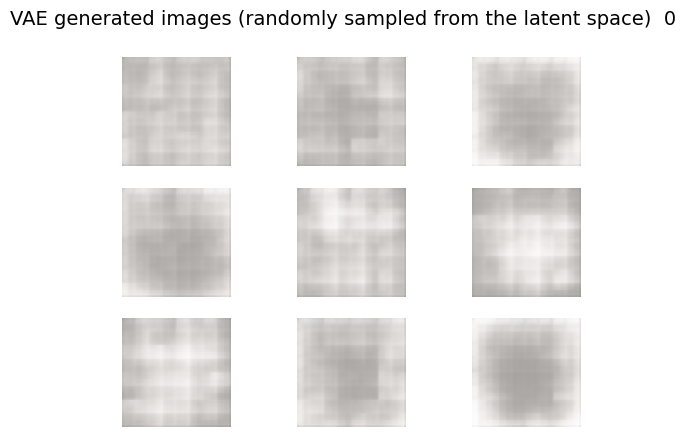

103/103 [==============================] - 1s 11ms/step - loss: 0.4170


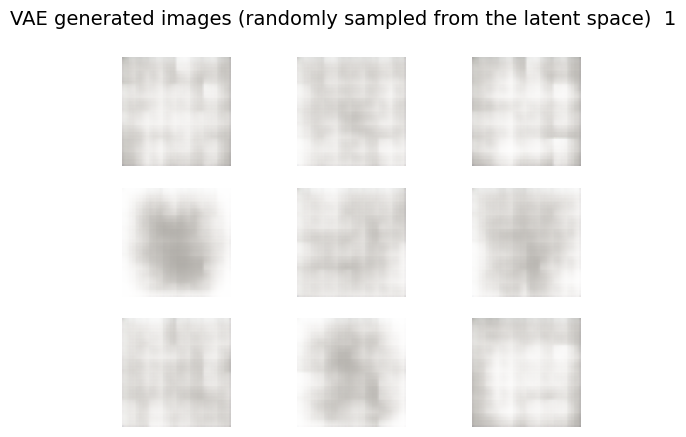

103/103 [==============================] - 1s 14ms/step - loss: 0.4172


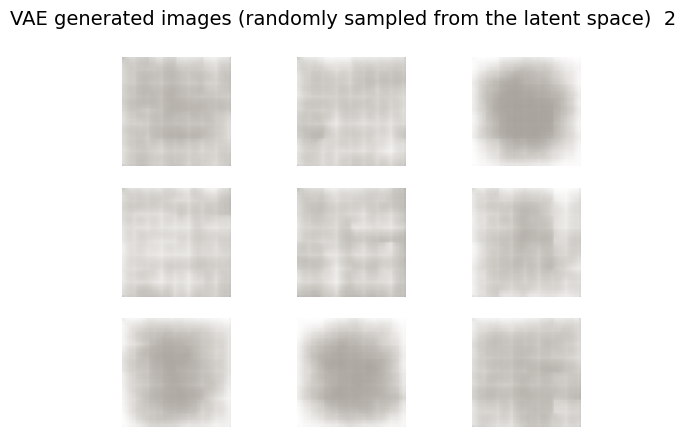

103/103 [==============================] - 1s 13ms/step - loss: 0.4138


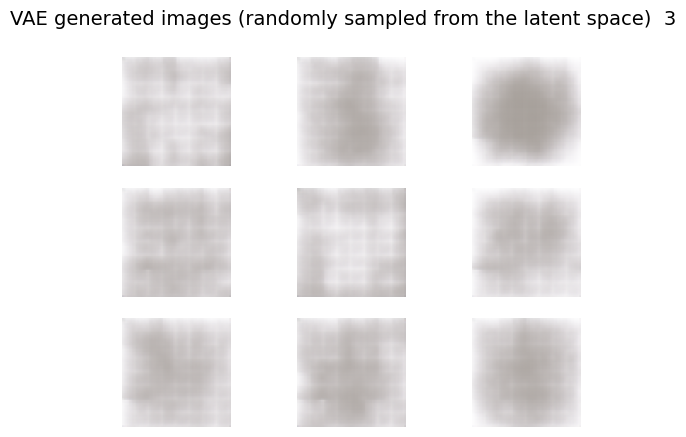

103/103 [==============================] - 1s 12ms/step - loss: 0.4097


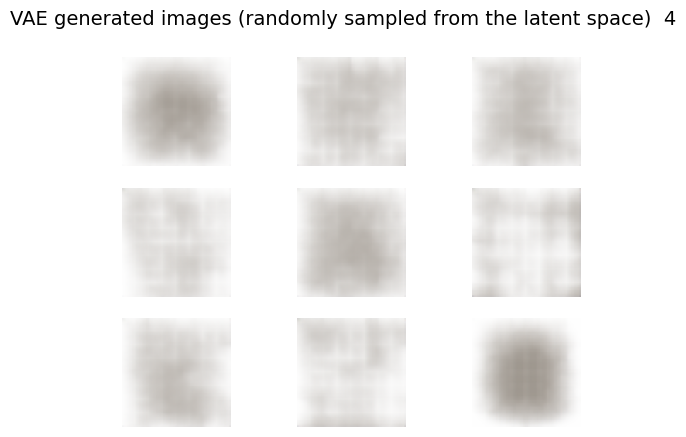

103/103 [==============================] - 1s 13ms/step - loss: 0.4013


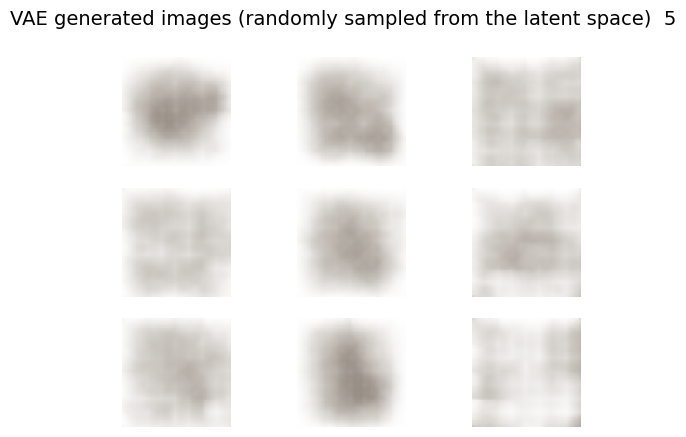

103/103 [==============================] - 1s 14ms/step - loss: 0.3915


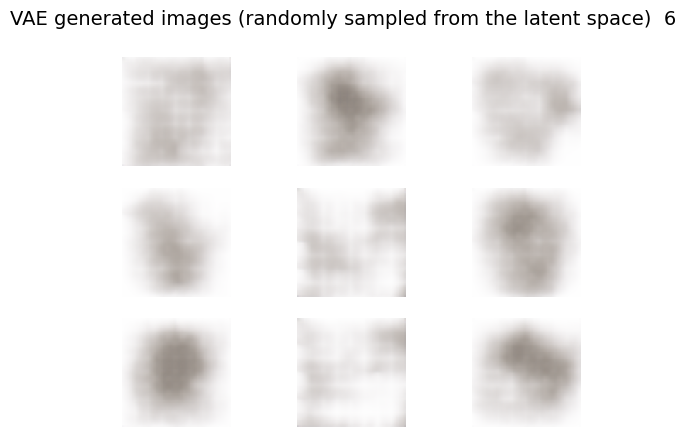

103/103 [==============================] - 1s 14ms/step - loss: 0.3823


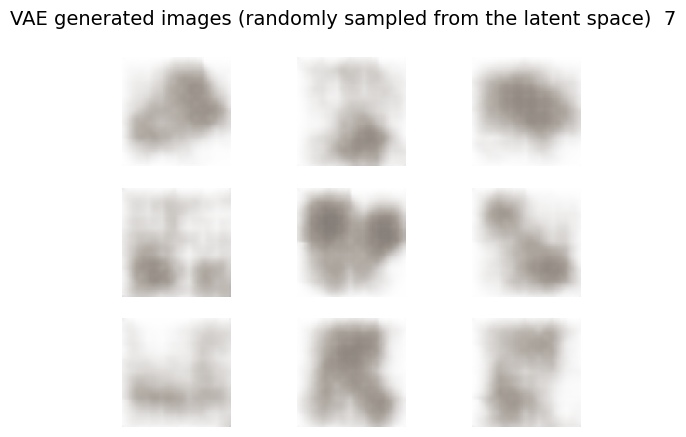

103/103 [==============================] - 1s 13ms/step - loss: 0.3752


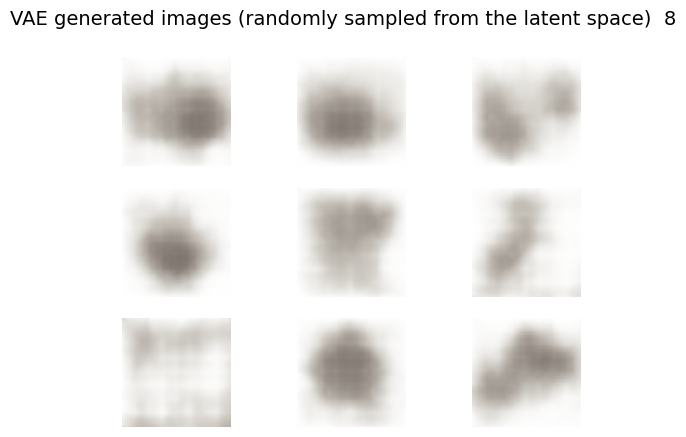

103/103 [==============================] - 1s 13ms/step - loss: 0.3717


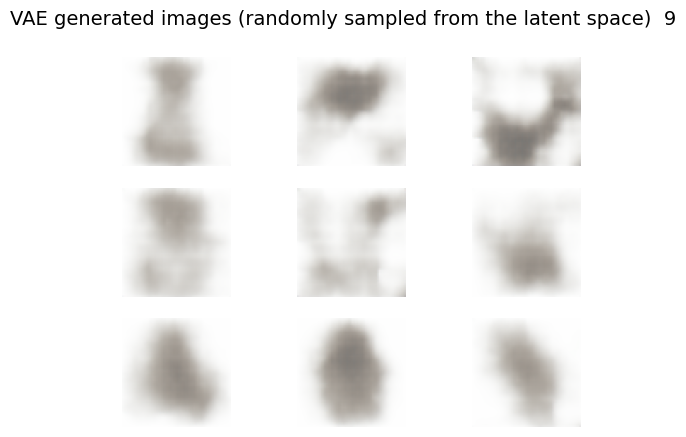

103/103 [==============================] - 1s 12ms/step - loss: 0.3708


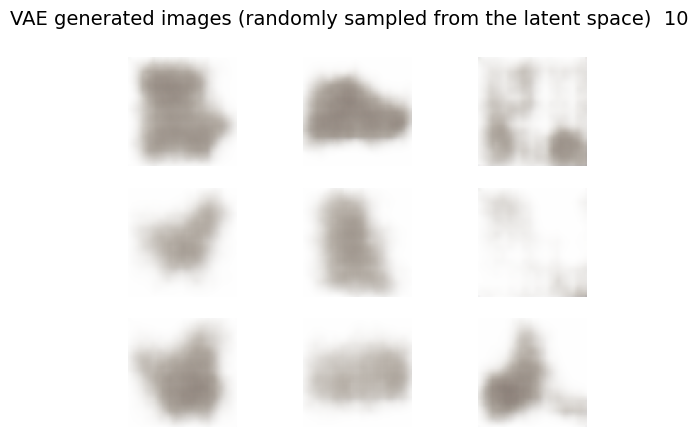

103/103 [==============================] - 1s 13ms/step - loss: 0.3678


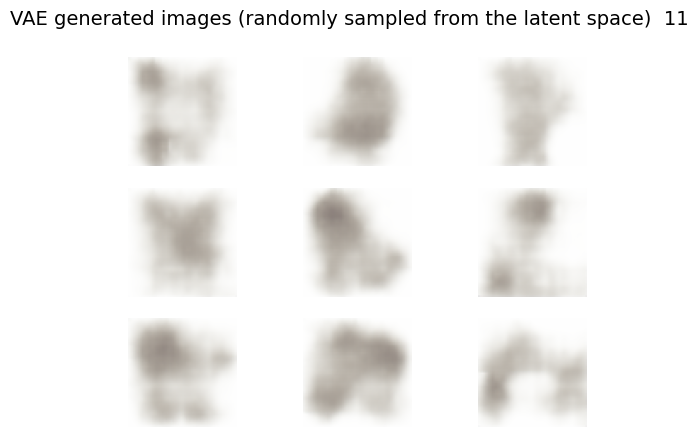

103/103 [==============================] - 2s 16ms/step - loss: 0.3664


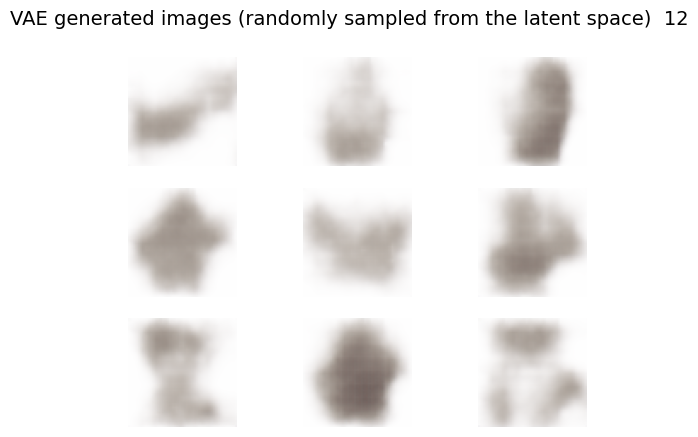

103/103 [==============================] - 1s 14ms/step - loss: 0.3643


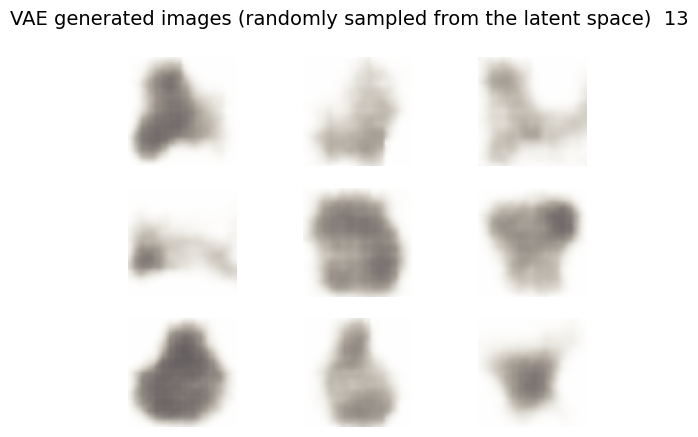

103/103 [==============================] - 1s 13ms/step - loss: 0.3622


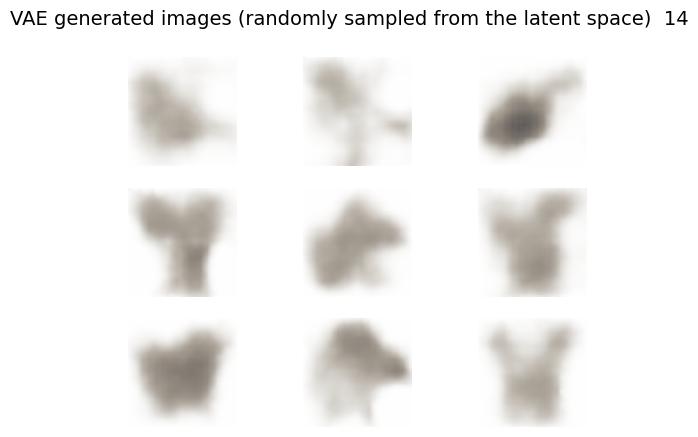

103/103 [==============================] - 1s 13ms/step - loss: 0.3609


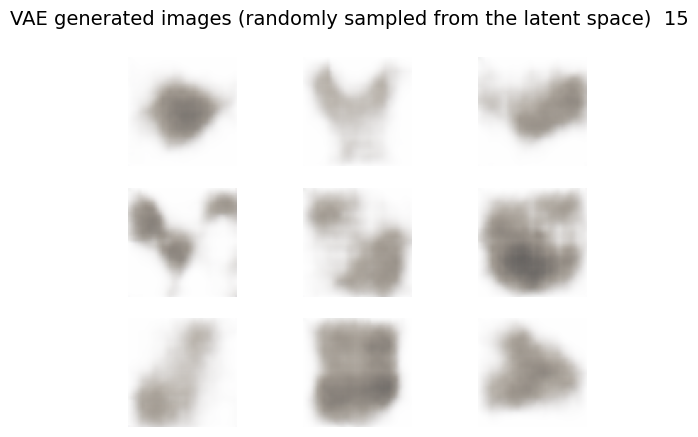

103/103 [==============================] - 2s 15ms/step - loss: 0.3604


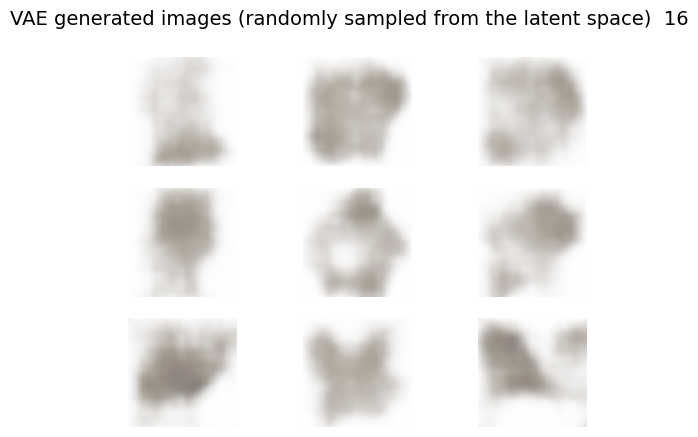

103/103 [==============================] - 2s 17ms/step - loss: 0.3586


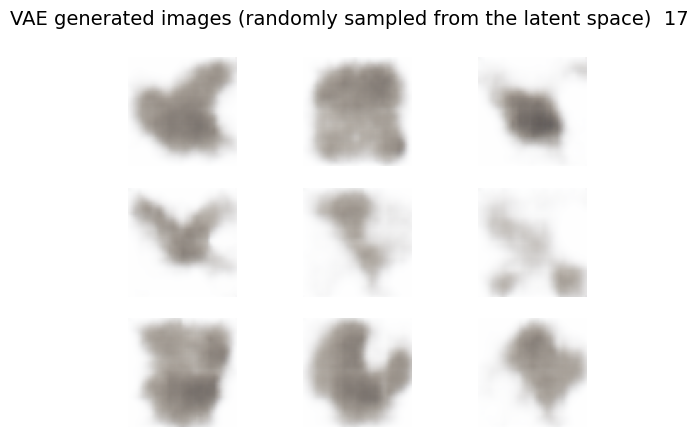

103/103 [==============================] - 1s 13ms/step - loss: 0.3575


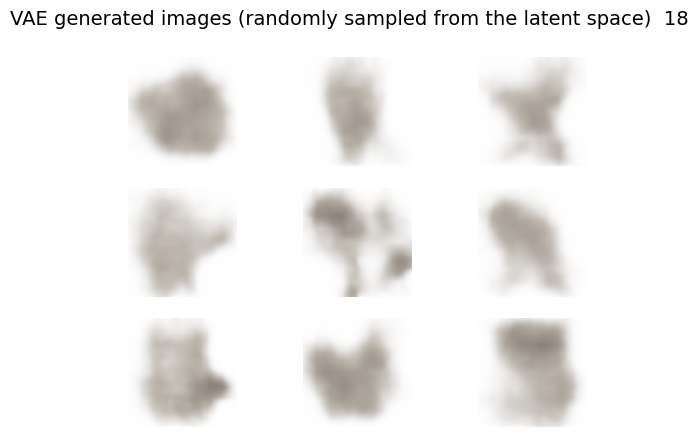

103/103 [==============================] - 1s 13ms/step - loss: 0.3563


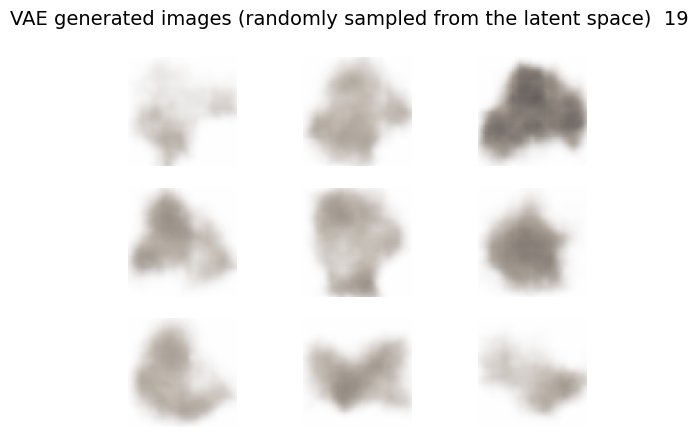

In [7]:
# Training the VAE model

latent_dim = 32
encoder, decoder, vae = build_vae(dataset.shape[1:], latent_dim, filters=128)

# Generate random vectors that we will use to sample our latent space
for epoch in range(20):
    latent_vectors = np.random.randn(9, latent_dim)
    vae.fit(x=dataset, y=dataset, epochs=1, batch_size=8)

    images = decoder(latent_vectors)
    grid_plot(images, epoch, name='VAE generated images (randomly sampled from the latent space)', n=3, save=False)

---

## 2.3 Generative Adversarial Networks (GANs)

### GAN architecture
Generative adversarial networks consist of two models: a generative model and a discriminative model.

<img src="https://media.springernature.com/original/springer-static/image/chp%3A10.1007%2F978-1-4842-3679-6_8/MediaObjects/463582_1_En_8_Fig1_HTML.jpg" width="500">

**The discriminator** model is a classifier that determines whether a given image looks like a real image from the dataset or like an artificially created image. This is basically a binary classifier that will take the form of a normal convolutional neural network (CNN).
As an input this network will get samples both from the dataset that it is trained on and on the samples generated by the **generator**.

The **generator** model takes random input values (noise) and transforms them into images through a deconvolutional neural network.

Over the course of many training iterations, the weights and biases in the discriminator and the generator are trained through backpropagation. The discriminator learns to tell "real" images of handwritten digits apart from "fake" images created by the generator. At the same time, the generator uses feedback from the discriminator to learn how to produce convincing images that the discriminator can't distinguish from real images.




# Our GAN code starts here:

### Specifying functions to train and build the GAN, generator and discriminator

In [ ]:
latent_dim = 256

def run_generator(generator, n_samples=100):
    """
    Run the generator model and generate n samples of synthetic images using random latent vectors
    """
    latent_dim = generator.layers[0].input_shape[-1]
    generator_input = np.random.randn(n_samples, latent_dim)

    return generator.predict(generator_input)


def get_batch(generator, dataset, batch_size=128):
    """
    Gets a single batch of samples (X) and labels (y) for the training the discriminator.
    One half from the real dataset (labeled as 1s), the other created by the generator model (labeled as 0s).
    """
    batch_size //= 2 # Split evenly among fake and real samples

    fake_data = run_generator(generator, n_samples=batch_size)
    real_data = dataset[np.random.randint(0, dataset.shape[0], batch_size)]

    X = np.concatenate([fake_data, real_data], axis=0)

    # Apply label smoothing to stabilize GAN training
    y_fake = np.zeros([batch_size, 1]) + 0.1  # smooth fake labels to 0.1
    y_real = np.ones([batch_size, 1]) - 0.1   # smooth real labels to 0.9
    y = np.concatenate([y_fake, y_real], axis=0)

    return X, y


import os
import sys

import matplotlib.pyplot as plt

def train_gan(generator, discriminator, gan, dataset, latent_dim, n_epochs=20, batch_size=128, gen_updates=3):
    batches_per_epoch = int(dataset.shape[0] / batch_size / 2)

    d_real_losses_epoch, d_fake_losses_epoch, gen_losses_epoch = [], [], []
    acc_real_epoch, acc_fake_epoch = [], []

    orig_stdout = sys.stdout

    for epoch in range(n_epochs):
        d_real_loss_sum, d_fake_loss_sum, gen_loss_sum = 0, 0, 0
        acc_real_sum, acc_fake_sum = 0, 0

        for batch in range(batches_per_epoch):
            sys.stdout = open(os.devnull, 'w')

            # Train discriminator on real and fake images
            X, y = get_batch(generator, dataset, batch_size=batch_size)
            half_batch = batch_size // 2
            d_real_loss = discriminator.train_on_batch(X[half_batch:], y[half_batch:])
            d_fake_loss = discriminator.train_on_batch(X[:half_batch], y[:half_batch])

            d_real_loss_sum += d_real_loss[0]
            acc_real_sum += d_real_loss[1]
            d_fake_loss_sum += d_fake_loss[0]
            acc_fake_sum += d_fake_loss[1]

            # 2) Train generator multiple times per discriminator update
            for _ in range(gen_updates):
                X_gan = np.random.randn(batch_size, latent_dim)
                y_gan = np.ones([batch_size, 1])
                generator_loss = gan.train_on_batch(X_gan, y_gan)
                gen_loss_sum += generator_loss[0]

            sys.stdout = orig_stdout

        d_real_losses_epoch.append(d_real_loss_sum / batches_per_epoch)
        acc_real_epoch.append(acc_real_sum / batches_per_epoch)
        d_fake_losses_epoch.append(d_fake_loss_sum / batches_per_epoch)
        acc_fake_epoch.append(acc_fake_sum / batches_per_epoch)
        gen_losses_epoch.append(gen_loss_sum / gen_updates / batches_per_epoch)

        if epoch % 10 == 0:
            noise = np.random.randn(16, latent_dim)
            images = generator.predict(noise)
            grid_plot(images, epoch, name='GAN generated images', n=3, save=False, scale=True)

    # Plotting the learning curves after training
    plt.figure(figsize=(12, 6))

    # Top subplot: Losses
    plt.subplot(2, 1, 1)
    plt.plot(d_real_losses_epoch, label="d-real", color='blue')
    plt.plot(d_fake_losses_epoch, label="d-fake", color='orange')
    plt.plot(gen_losses_epoch, label="gen", color='green')
    plt.title("Line Plots of Loss")
    plt.legend()

    # Bottom subplot: Accuracies
    plt.subplot(2, 1, 2)
    plt.plot(acc_real_epoch, label="acc-real", color='blue')
    plt.plot(acc_fake_epoch, label="acc-fake", color='orange')
    plt.title("Line Plots of Accuracy")
    plt.xlabel("Epochs")
    plt.legend()

    plt.tight_layout()
    plt.show()




In [ ]:
from tensorflow.keras.layers import Dense, Flatten, Conv2D, Conv2DTranspose, Reshape, BatchNormalization, Activation, Dropout, UpSampling2D, LeakyReLU

# Discriminator
def build_conv_net(in_shape, out_shape, filters=64, out_activation='sigmoid'):
    """
    Build a basic convolutional network
    """
    model = tf.keras.Sequential()

    # Initial Conv layer
    model.add(tf.keras.layers.Conv2D(filters, (5, 5), strides=2, input_shape=in_shape, padding='same'))
    model.add(tf.keras.layers.LeakyReLU(alpha=0.2))

    # Add more layers with increased filters
    for n_filters in [128, 256, 512]:
        model.add(tf.keras.layers.Conv2D(n_filters, (5, 5), strides=2, padding='same'))
        model.add(tf.keras.layers.LeakyReLU(alpha=0.2))
        model.add(tf.keras.layers.Dropout(0.4))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(out_shape, activation=out_activation))
    model.summary()

    return model

#Generator
def build_deconv_net(latent_dim, n_upsampling_layers=4, filters=128, activation_out='tanh'):
    """
    Build a deconvolutional network for decoding/upscaling latent vectors

    When building the deconvolutional architecture, usually it is best to use the same layer sizes that
    were used in the downsampling network and the Conv2DTranspose layers are used instead of Conv2D layers.
    Using identical layers and hyperparameters ensures that the dimensionality of our output matches the
    shape of our input images.
    """

    model = tf.keras.Sequential()
  # Beginning layers starting from a 4x4 spatial dimension
    model.add(Dense(4*4*256, input_dim=latent_dim))  # Adjusted dense layer size
    model.add(BatchNormalization(momentum=0.9))
    model.add(Activation('relu'))
    model.add(Reshape((4,4,256)))
    model.add(Dropout(0.4))

    # Upsampling layers with the provided structure
    for _ in range(n_upsampling_layers):
        model.add(UpSampling2D())
        model.add(Conv2D(filters=filters, kernel_size=5, padding='same'))
        model.add(BatchNormalization(momentum=0.9))
        model.add(Activation('relu'))

        # Halve the number of filters for the next layer
        filters //= 2
        if filters < 32:  # Make sure it doesn't go below a certain threshold
            filters = 32

    # End layers from build_generator
    model.add(Conv2D(32, 5, padding='same'))
    model.add(BatchNormalization(momentum=0.9))
    model.add(Activation('relu'))

    model.add(Conv2D(3, 5, padding='same'))
    model.add(Activation(activation_out))
    model.summary()
    return model

In [ ]:
from tensorflow.keras.optimizers import Adam, RMSprop

def build_gan(discriminator, generator):
    """
    Build a GAN by combining the discriminator and generator models.
    """
    discriminator.trainable = False  # Freeze the discriminator

    model = tf.keras.Sequential()
    model.add(generator)
    model.add(discriminator)

    return model

# Define optimizers
discriminator_optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=0.0002, clipvalue=1.0, decay=6e-8)
adversarial_optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=0.00001, clipvalue=1.0, decay=3e-8)

# Build the discriminator
discriminator = build_conv_net(in_shape=dataset.shape[1:], out_shape=1)
discriminator.compile(loss='binary_crossentropy',
                      optimizer=discriminator_optimizer,
                      metrics=['accuracy'])

# Build the generator
generator = build_deconv_net(latent_dim=latent_dim)

# Build the combined GAN model
gan = build_gan(discriminator, generator)
gan.compile(loss='binary_crossentropy',
            optimizer=adversarial_optimizer,
            metrics=['accuracy'])


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 32, 32, 64)        4864      
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 128)       204928    
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 dropout (Dropout)           (None, 16, 16, 128)       0         
                                                                 
 conv2d_2 (Conv2D)           (None, 8, 8, 256)         819456    
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 8, 8, 256)         0

### Setup and Results
We painstakenly tested a lot of different parameterizatoins until we finally started to get decent results with the current setup. We tried different learning rates for both generator and discriminator and also experimented with training the generator more often than the discriminator. We've seen either the discriminator overpowering the generator wich didn't allow the generator to learn enough, or the generator finding one image that tricks the discriminator and simply started to generate the same image over and over (mode collapse). Ultimately, we were able to balance the training of the two models and generate decent images.


We established consistent shape diveristy at 200 epochs, consistent color diversity at 400 epochs, and consistent Pokemon shape/color features around 800 epochs, at 1800 epochs we're starting to see more detailed features like faces, limbs, tails and shields.

RAM limitations didn't allow us to test more than 1800 epochs at once. But since we wanted to see how good the generated image quality could be with more epochs, we decided to train the model for 1000 epochs, save the weights, start a new session, load the weights, and continue to train the model for another 1000 epochs. This allowed us to push the epoch count to 5000.



### Generating new images
When we load the trained models, we can use it the generator to generate new unique images.

In [ ]:
generator.load_weights("/content/drive/My Drive/Colab Notebooks/best_model_6006epochs_gen_weights.h5")
discriminator.load_weights("/content/drive/My Drive/Colab Notebooks/best_model_6006epochs_disc_weights.h5")


4/4 [==============================] - 2s 382ms/step


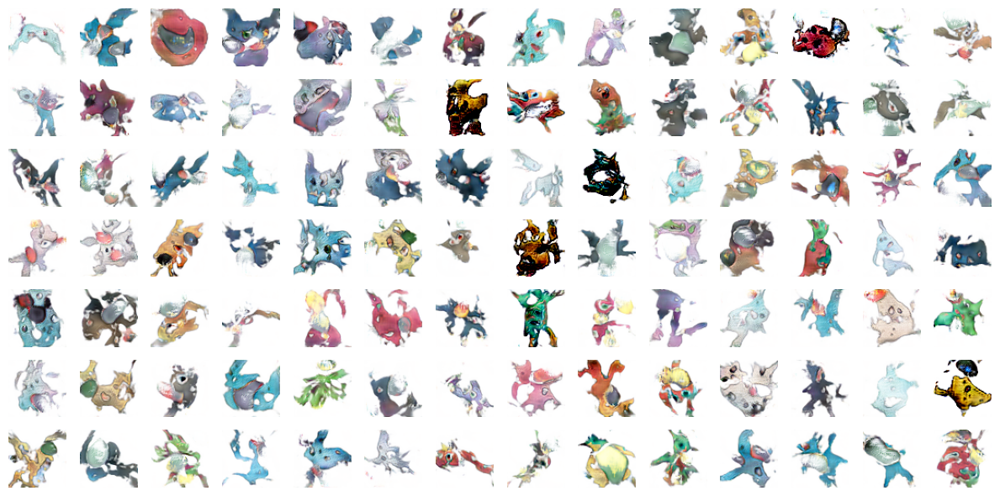

In [ ]:

def generate_batch_images(generator, latent_dim, n_samples=49):
    # Generate random noise as an input for the generator
    random_noise = np.random.randn(n_samples, latent_dim)

    # Generate images from the random noise
    generated_images = generator.predict(random_noise)


    return generated_images

def plot_images_in_grid(images, rows, cols, figsize=(12,6)):
    # Create a figure with specified rows and columns
    fig, axes = plt.subplots(rows, cols, figsize=figsize)

    for i in range(rows):
        for j in range(cols):
            # Extract the corresponding image
            img = images[i*cols + j]

            # Display the image on the corresponding axes
            axes[i, j].imshow(img)
            axes[i, j].axis('off')

    plt.tight_layout()
    plt.show()

# Generate a batch of images
gen_batch_images = generate_batch_images(generator, latent_dim, 98)

# Plot the images in a 6x6 grid
plot_images_in_grid(gen_batch_images, 7, 14)


### Some results of the training process from epoch 1 to 6000

1/1 [==============================] - 0s 493ms/step


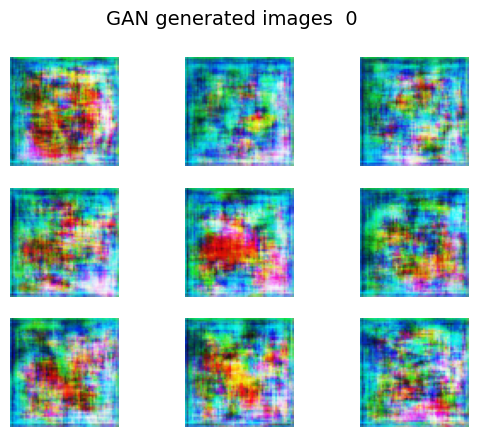

1/1 [==============================] - 0s 17ms/step


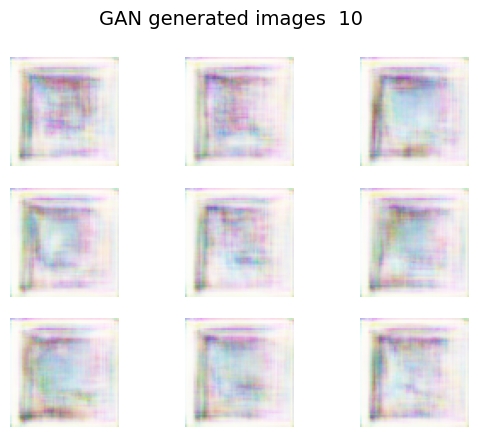

1/1 [==============================] - 0s 18ms/step


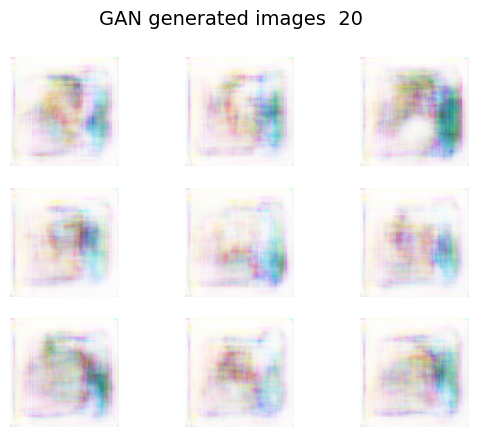

1/1 [==============================] - 0s 26ms/step


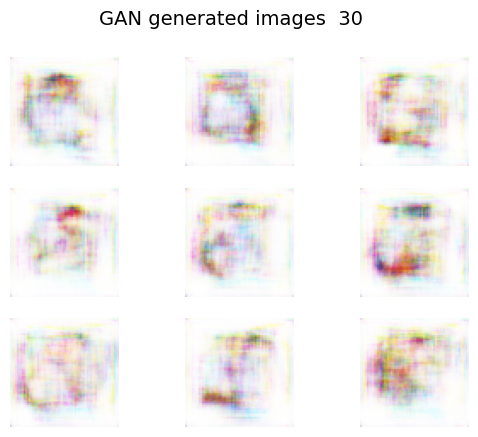

1/1 [==============================] - 0s 56ms/step


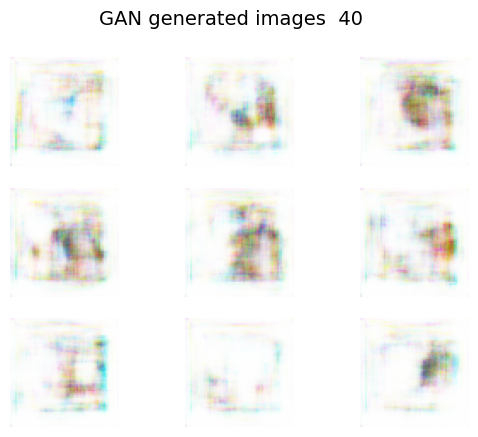

1/1 [==============================] - 0s 18ms/step


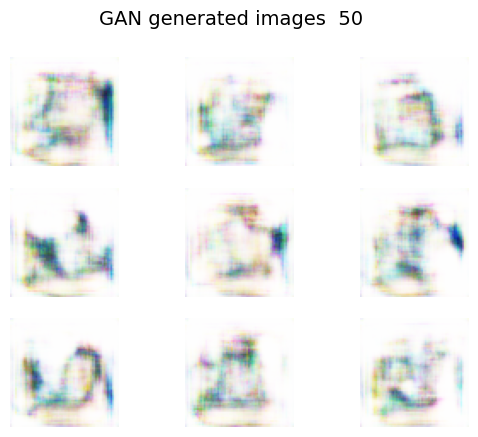

1/1 [==============================] - 0s 30ms/step


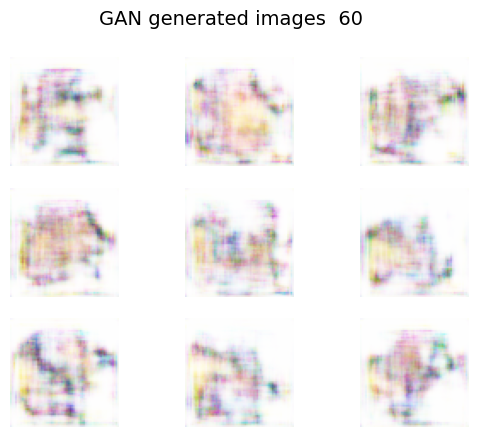

1/1 [==============================] - 0s 19ms/step


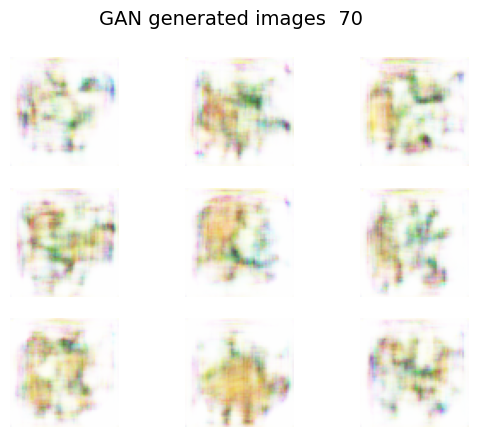

1/1 [==============================] - 0s 18ms/step


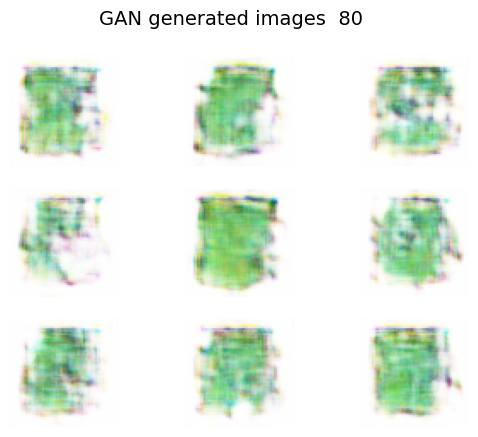

1/1 [==============================] - 0s 18ms/step


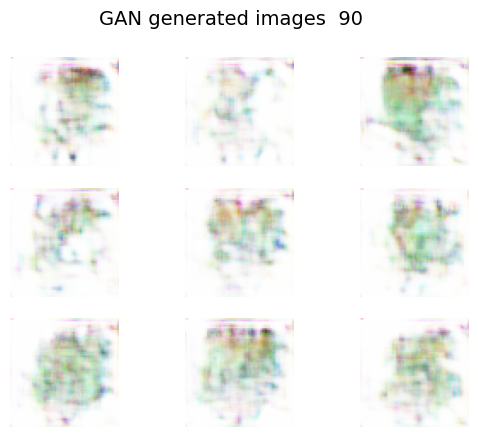

1/1 [==============================] - 0s 18ms/step


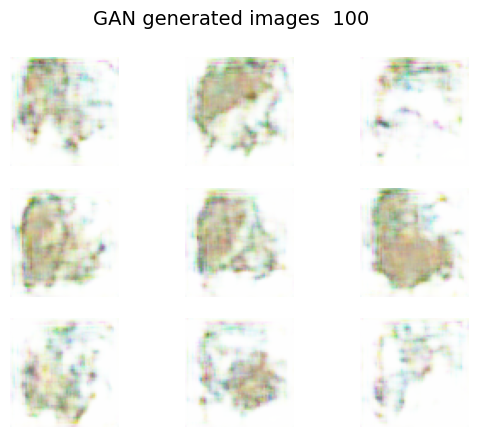

1/1 [==============================] - 0s 27ms/step


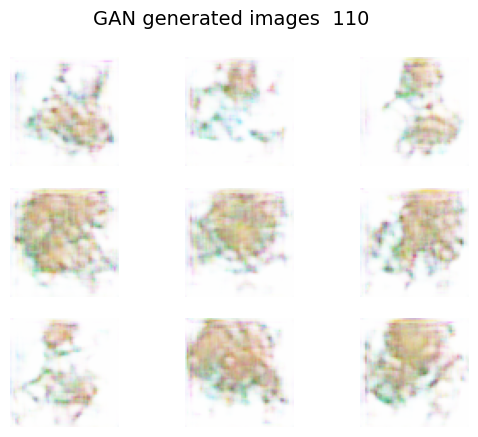

1/1 [==============================] - 0s 18ms/step


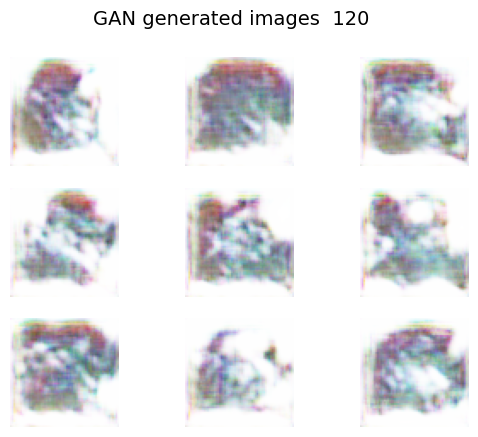

1/1 [==============================] - 0s 19ms/step


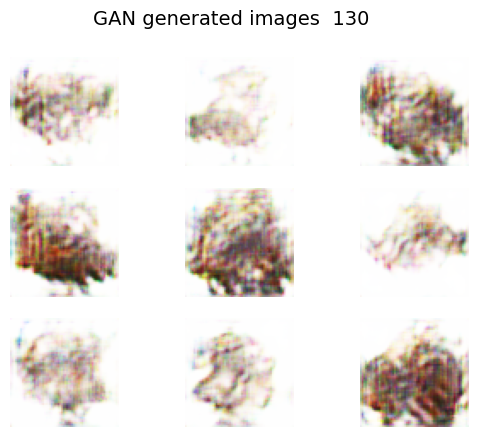

1/1 [==============================] - 0s 35ms/step


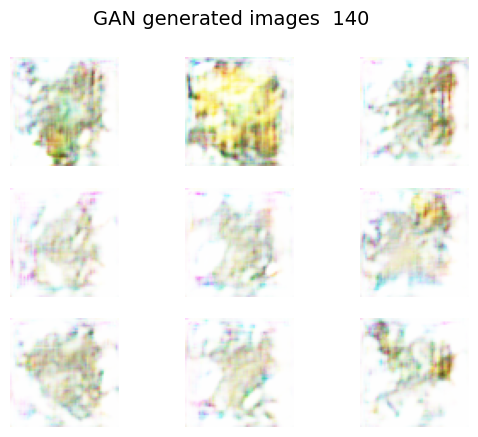

1/1 [==============================] - 0s 18ms/step


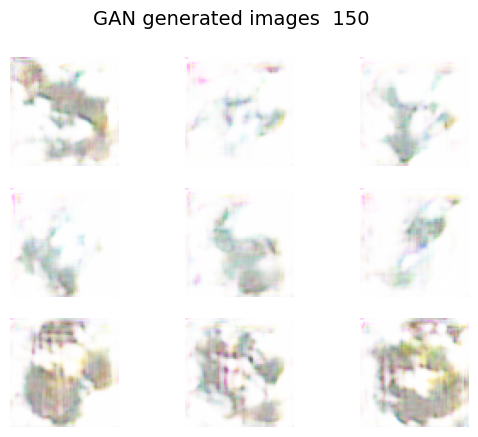

1/1 [==============================] - 0s 21ms/step


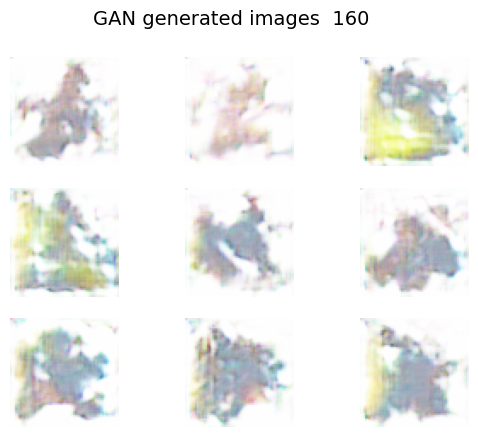

1/1 [==============================] - 0s 21ms/step


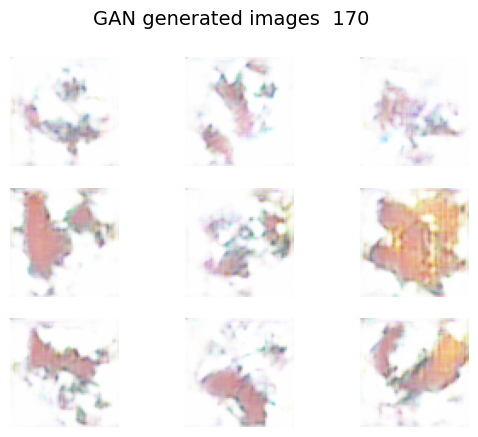

1/1 [==============================] - 0s 27ms/step


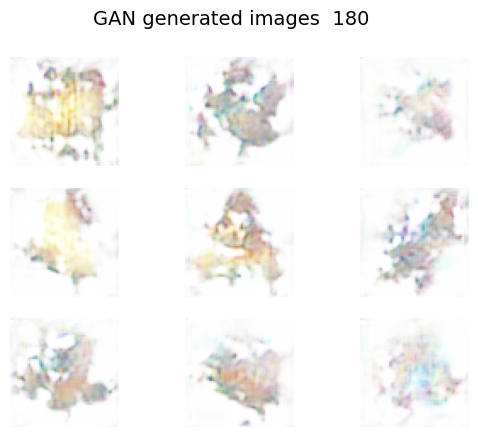

1/1 [==============================] - 0s 22ms/step


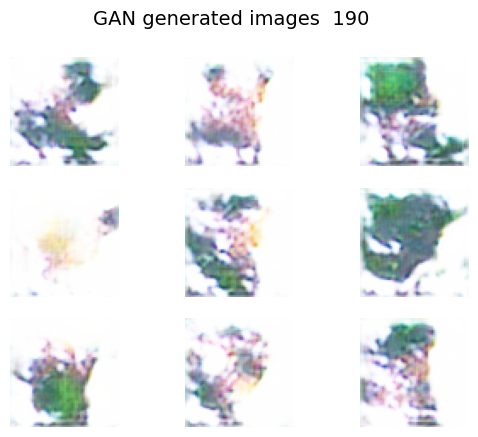

1/1 [==============================] - 0s 19ms/step


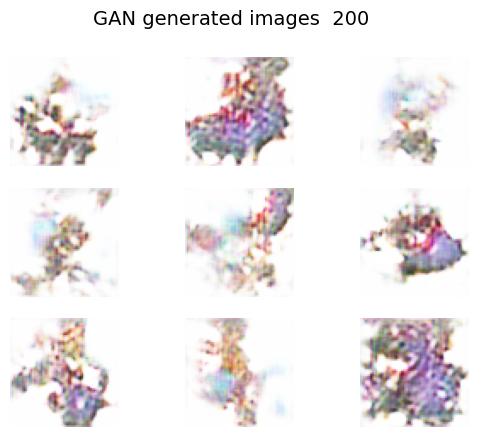

1/1 [==============================] - 0s 18ms/step


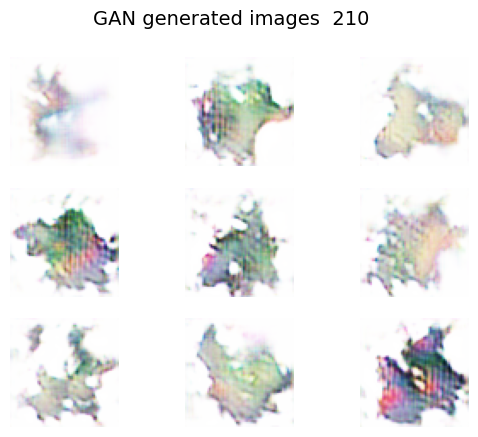

1/1 [==============================] - 0s 21ms/step


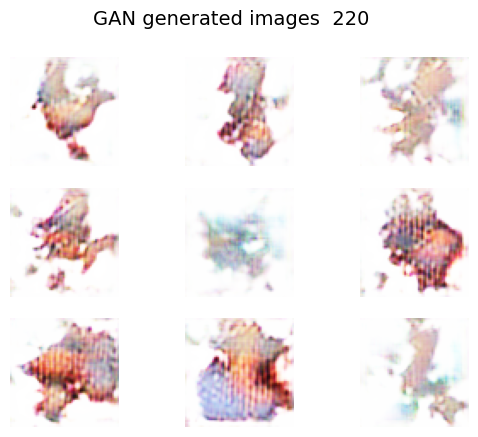

1/1 [==============================] - 0s 17ms/step


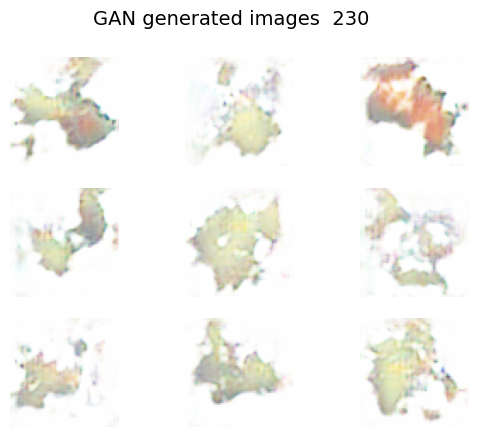

1/1 [==============================] - 0s 19ms/step


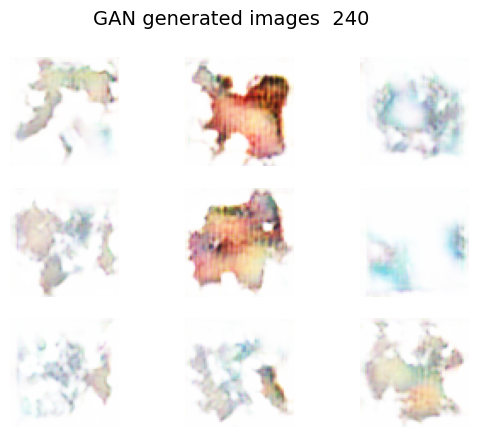

1/1 [==============================] - 0s 17ms/step


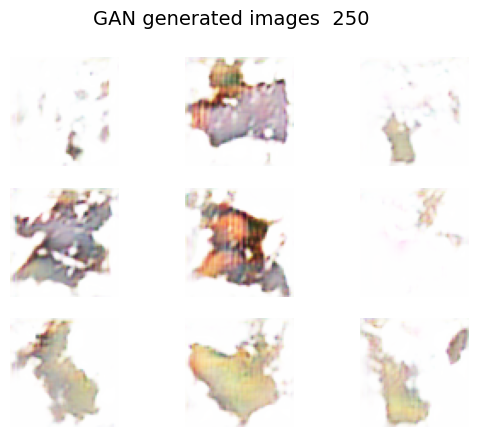

1/1 [==============================] - 0s 27ms/step


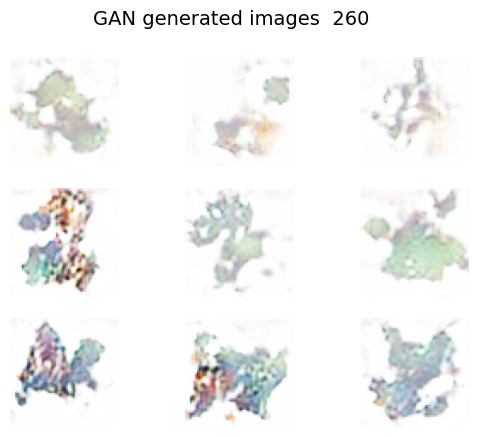

1/1 [==============================] - 0s 17ms/step


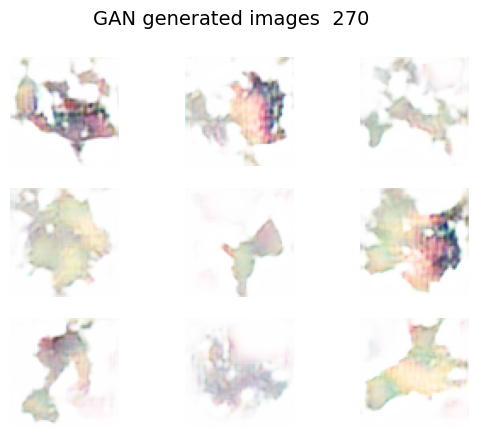

1/1 [==============================] - 0s 18ms/step


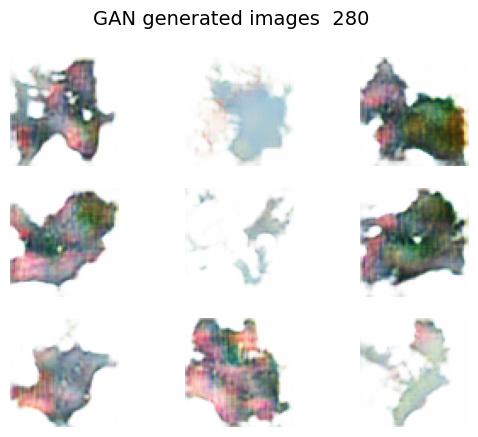

1/1 [==============================] - 0s 18ms/step


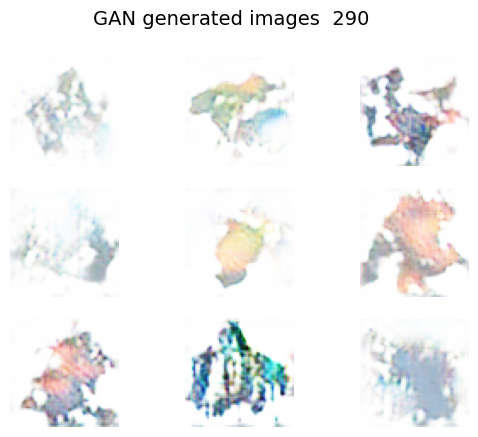

1/1 [==============================] - 0s 17ms/step


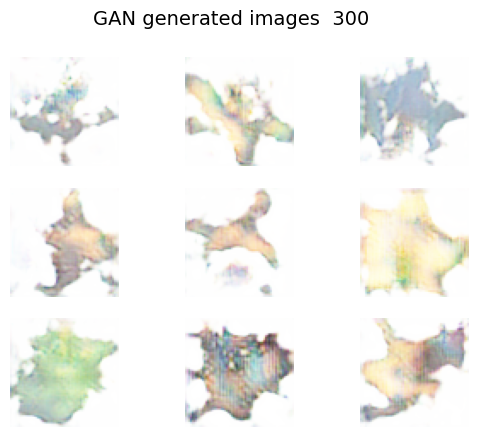

1/1 [==============================] - 0s 18ms/step


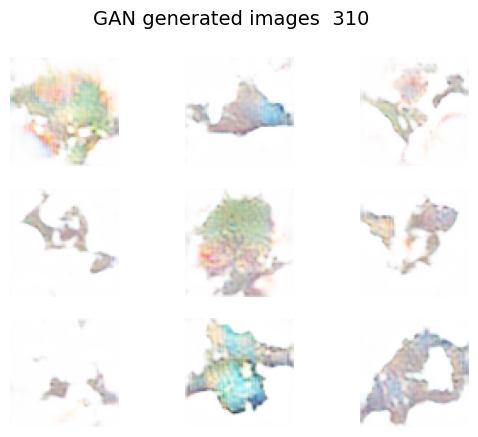

1/1 [==============================] - 0s 17ms/step


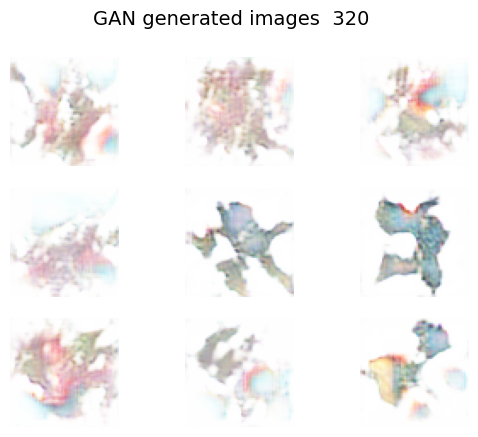

1/1 [==============================] - 0s 18ms/step


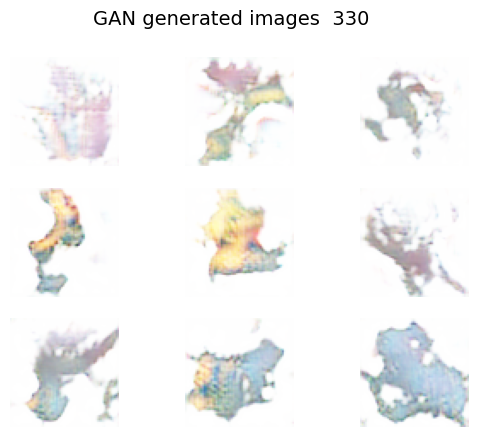

1/1 [==============================] - 0s 30ms/step


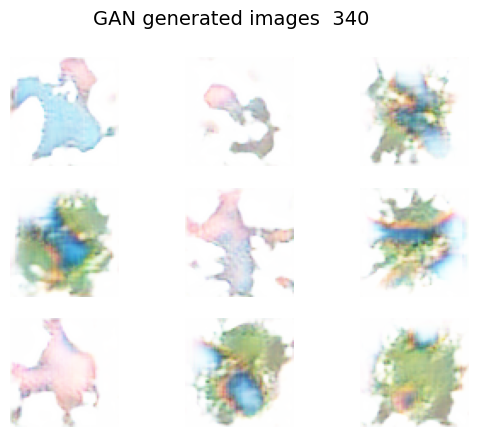

1/1 [==============================] - 0s 17ms/step


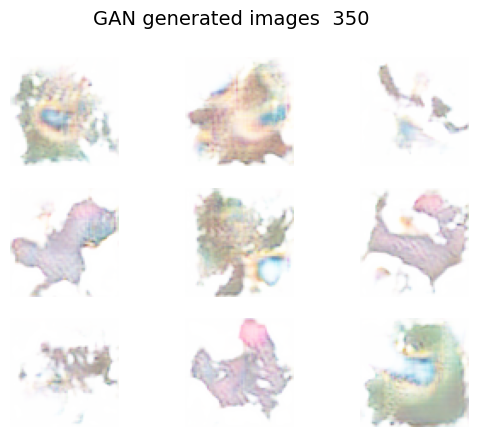

1/1 [==============================] - 0s 17ms/step


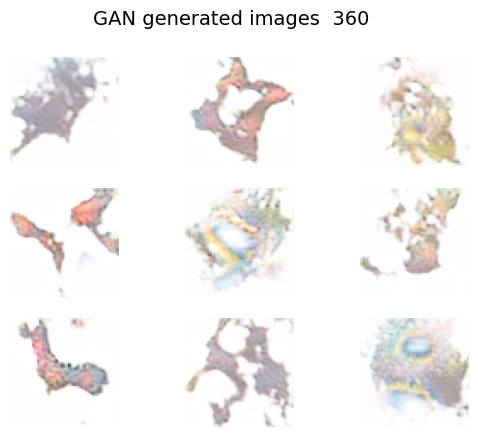

1/1 [==============================] - 0s 21ms/step


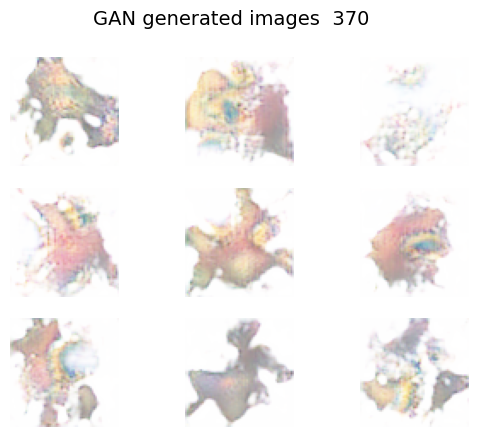

1/1 [==============================] - 0s 17ms/step


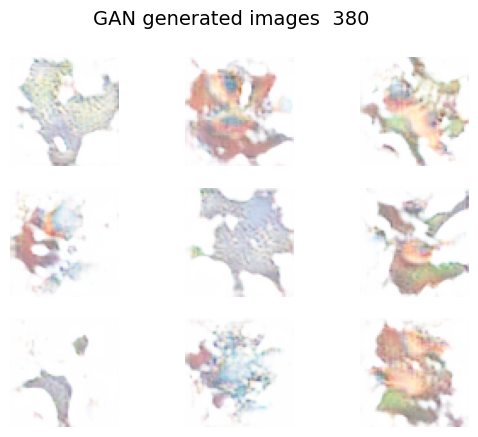

1/1 [==============================] - 0s 19ms/step


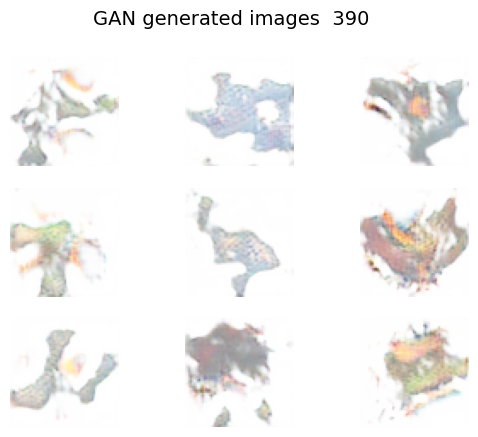

1/1 [==============================] - 0s 18ms/step


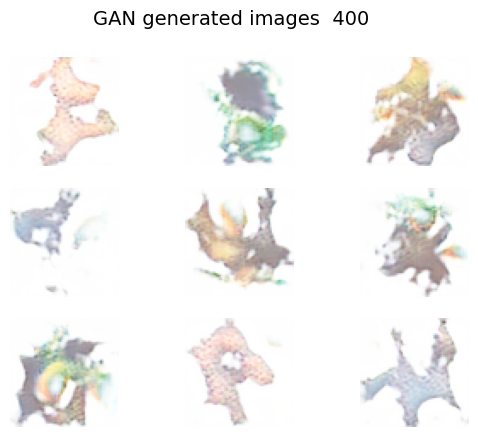

1/1 [==============================] - 0s 17ms/step


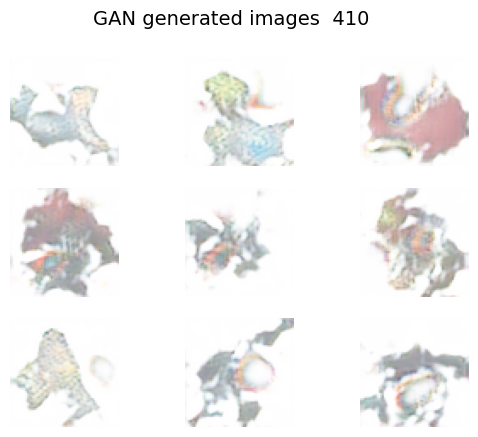

1/1 [==============================] - 0s 18ms/step


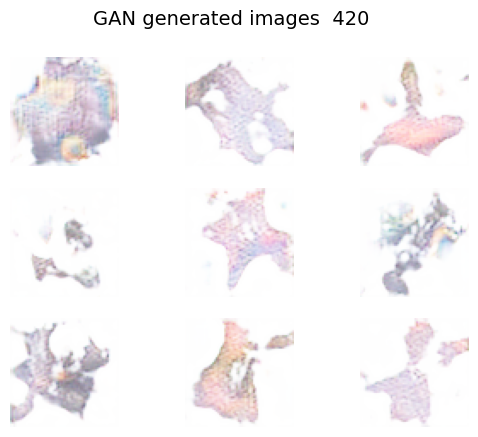

1/1 [==============================] - 0s 29ms/step


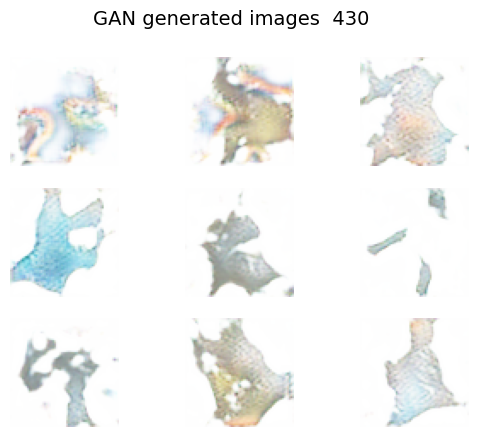

1/1 [==============================] - 0s 29ms/step


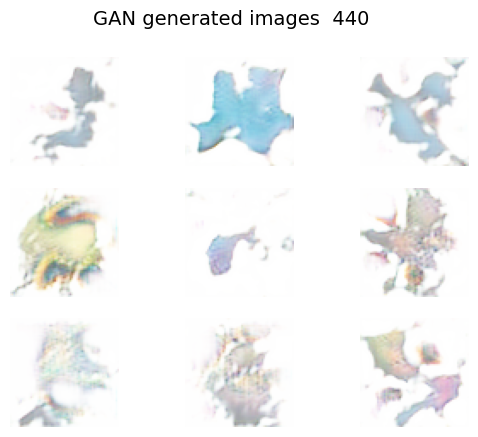

1/1 [==============================] - 0s 18ms/step


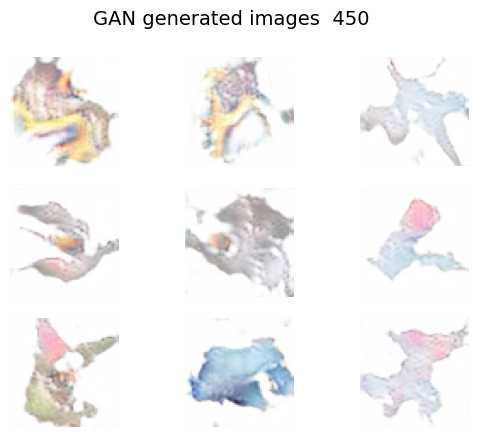

1/1 [==============================] - 0s 19ms/step


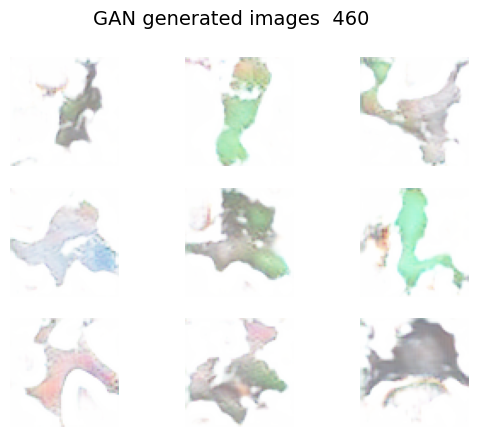

1/1 [==============================] - 0s 17ms/step


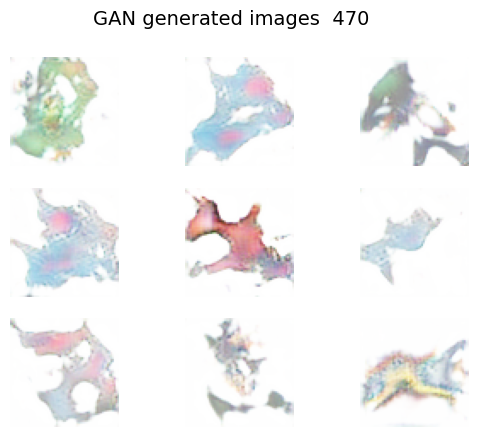

1/1 [==============================] - 0s 18ms/step


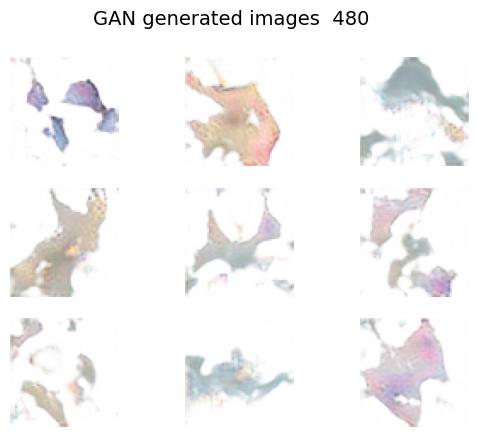

1/1 [==============================] - 0s 18ms/step


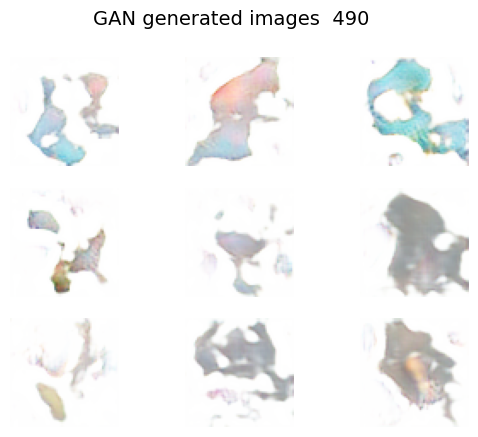

1/1 [==============================] - 0s 19ms/step


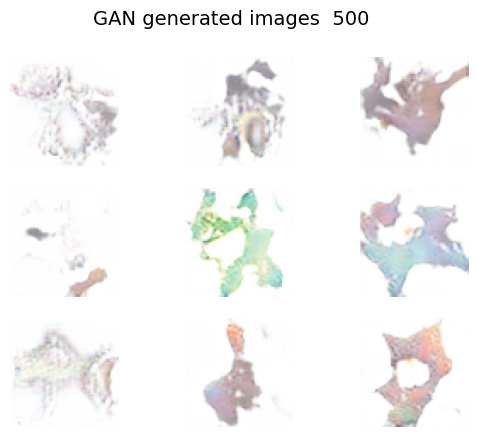

1/1 [==============================] - 0s 17ms/step


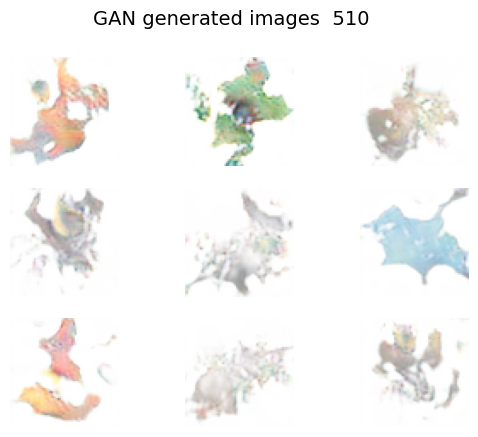

1/1 [==============================] - 0s 17ms/step


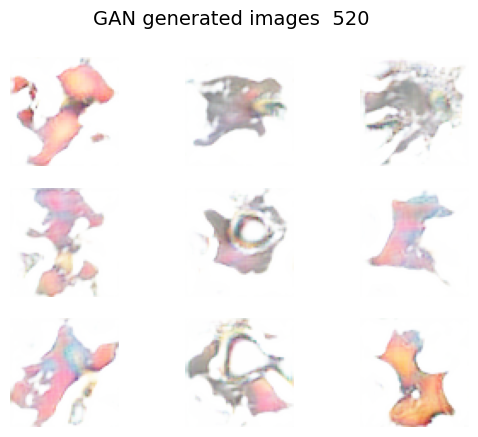

1/1 [==============================] - 0s 29ms/step


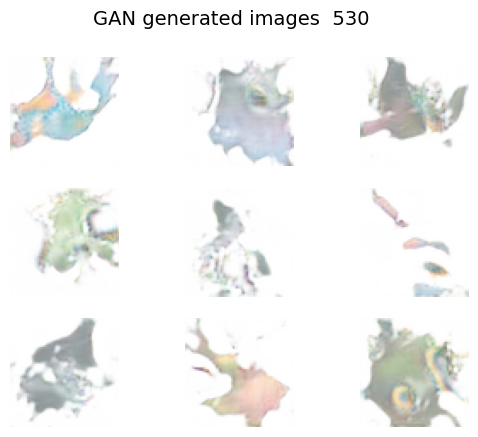

1/1 [==============================] - 0s 26ms/step


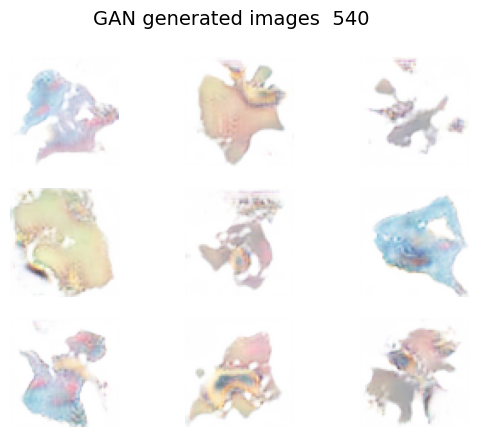

1/1 [==============================] - 0s 27ms/step


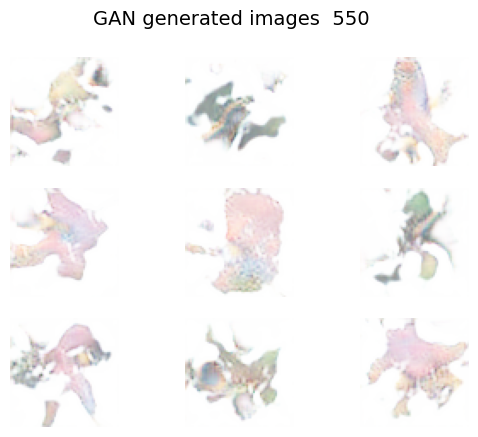

1/1 [==============================] - 0s 19ms/step


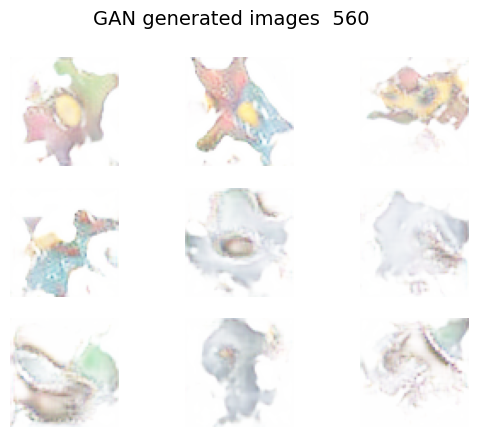

1/1 [==============================] - 0s 17ms/step


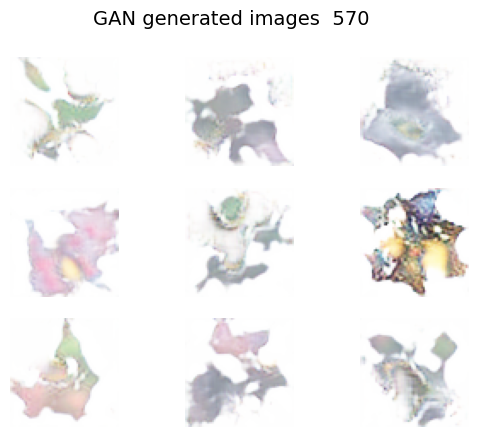

1/1 [==============================] - 0s 18ms/step


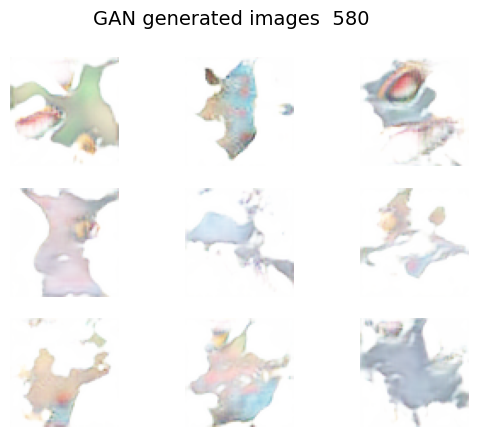

1/1 [==============================] - 0s 19ms/step


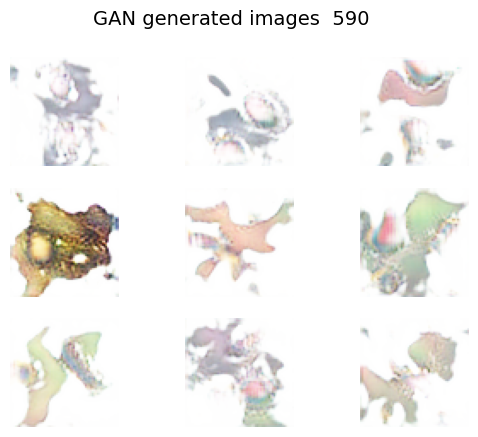

1/1 [==============================] - 0s 17ms/step


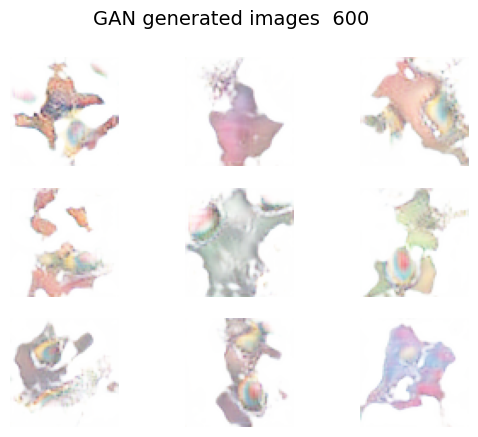

1/1 [==============================] - 0s 18ms/step


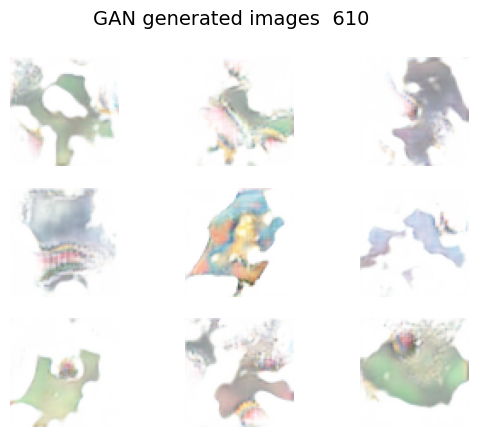

1/1 [==============================] - 0s 22ms/step


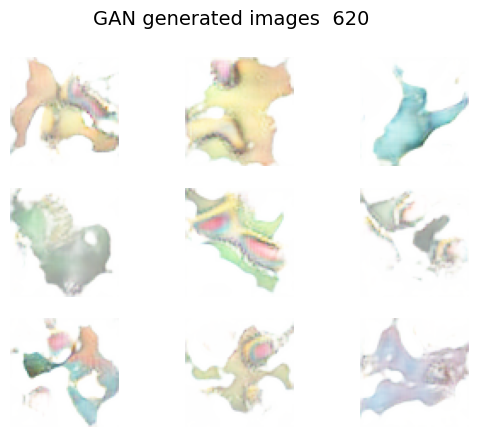

1/1 [==============================] - 0s 17ms/step


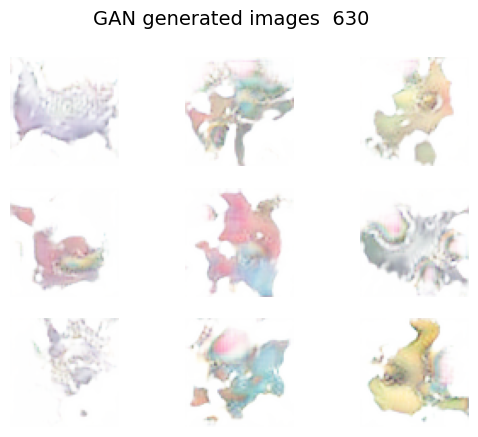

1/1 [==============================] - 0s 17ms/step


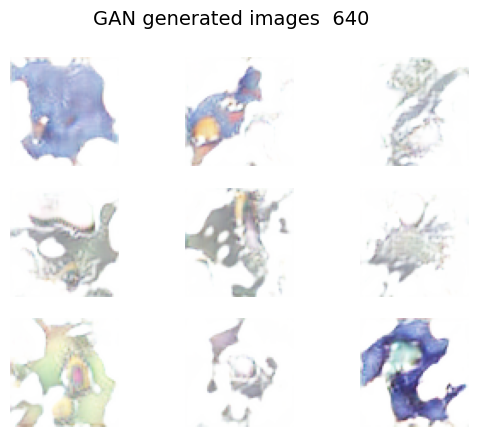

1/1 [==============================] - 0s 29ms/step


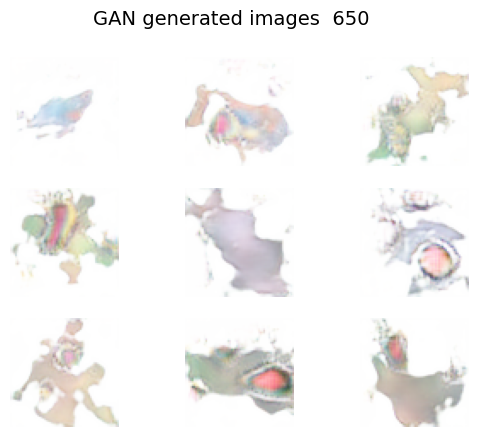

1/1 [==============================] - 0s 29ms/step


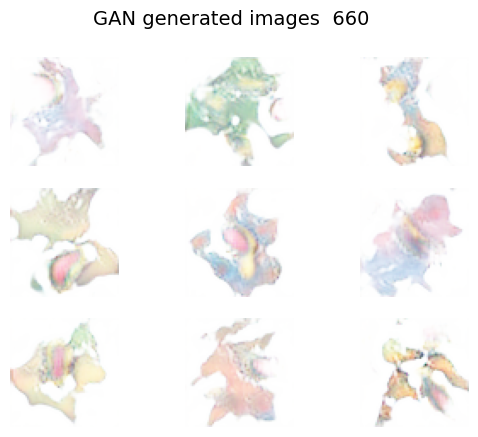

1/1 [==============================] - 0s 29ms/step


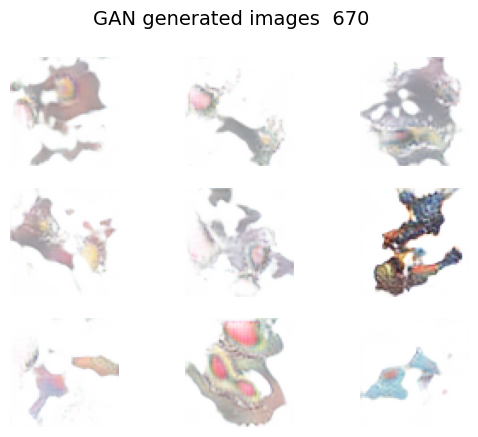

1/1 [==============================] - 0s 26ms/step


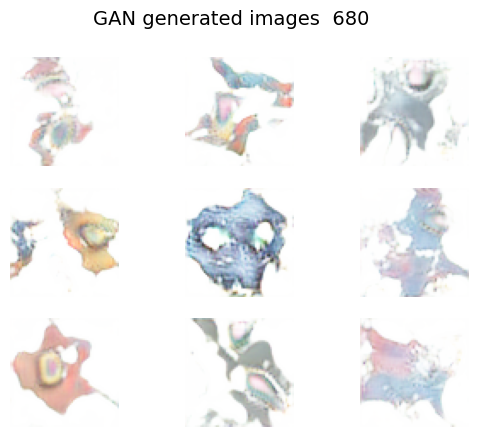

1/1 [==============================] - 0s 18ms/step


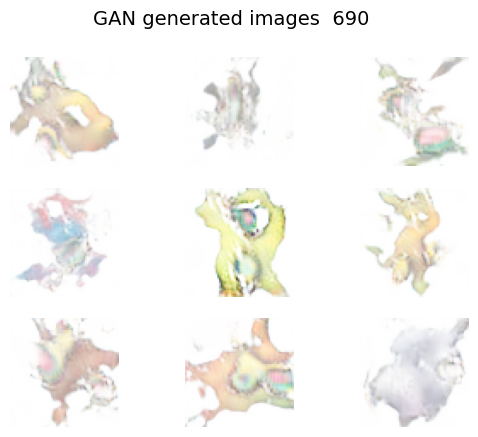

1/1 [==============================] - 0s 17ms/step


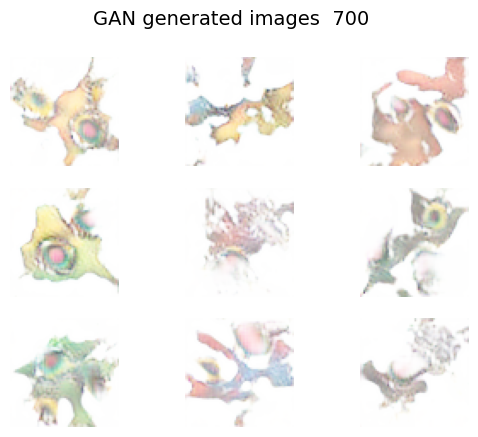

1/1 [==============================] - 0s 22ms/step


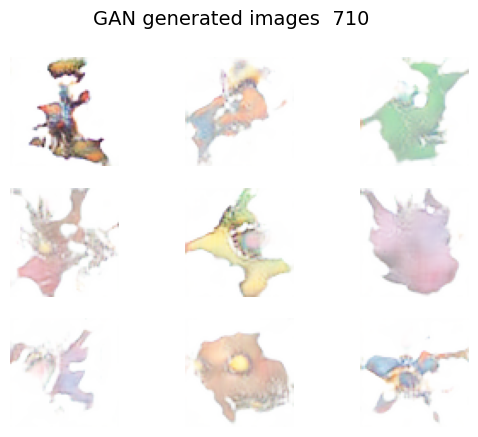

1/1 [==============================] - 0s 17ms/step


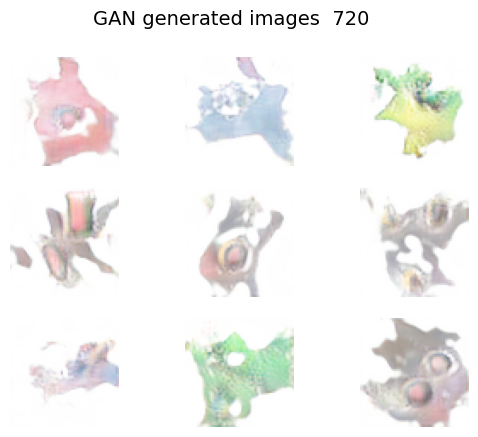

1/1 [==============================] - 0s 20ms/step


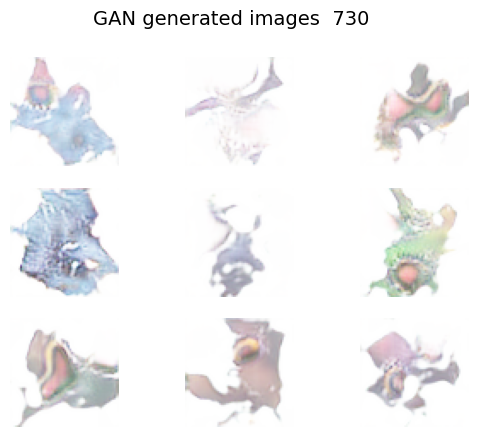

1/1 [==============================] - 0s 17ms/step


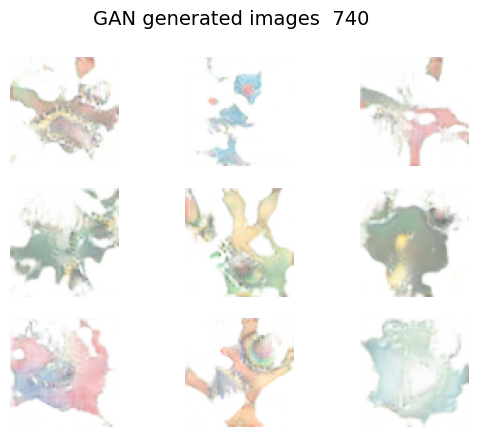

1/1 [==============================] - 0s 21ms/step


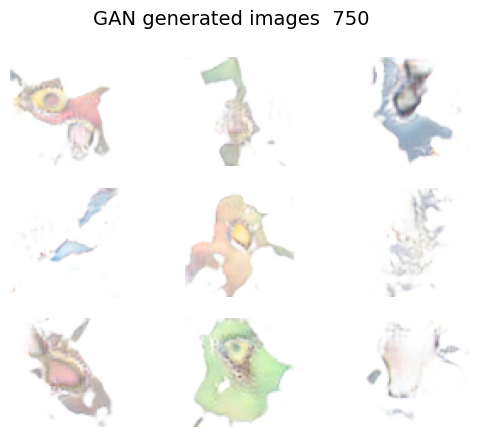

1/1 [==============================] - 0s 28ms/step


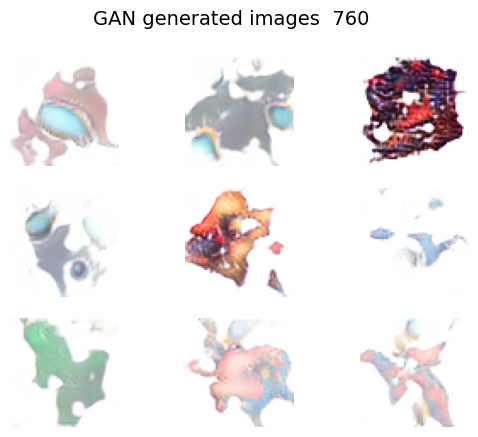

1/1 [==============================] - 0s 27ms/step


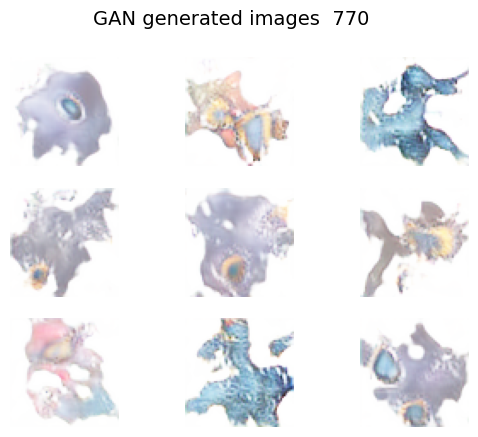

1/1 [==============================] - 0s 31ms/step


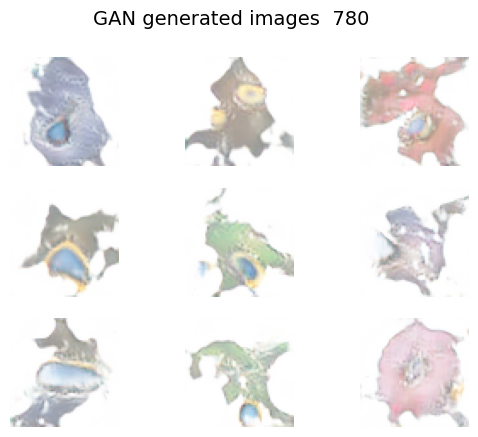

1/1 [==============================] - 0s 25ms/step


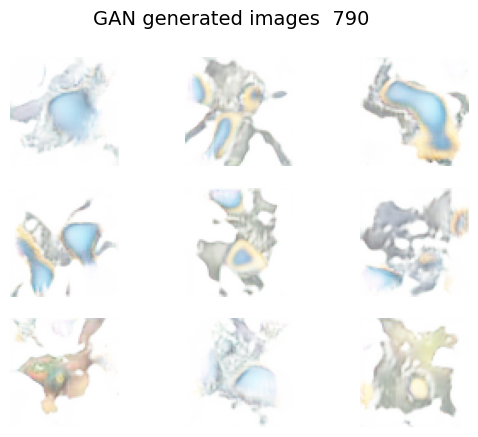

1/1 [==============================] - 0s 18ms/step


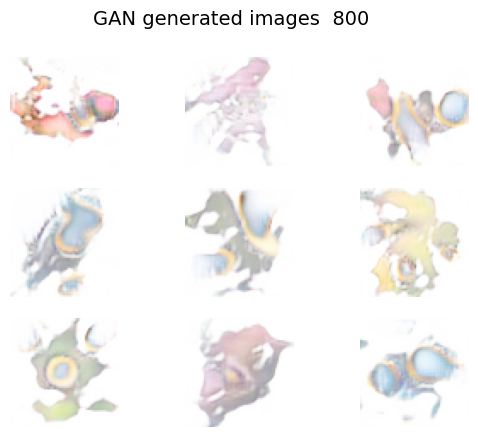

1/1 [==============================] - 0s 17ms/step


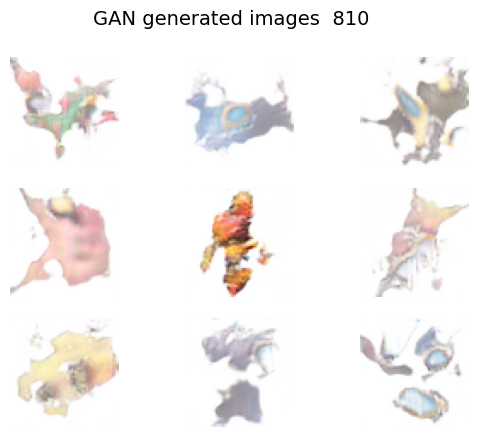

1/1 [==============================] - 0s 21ms/step


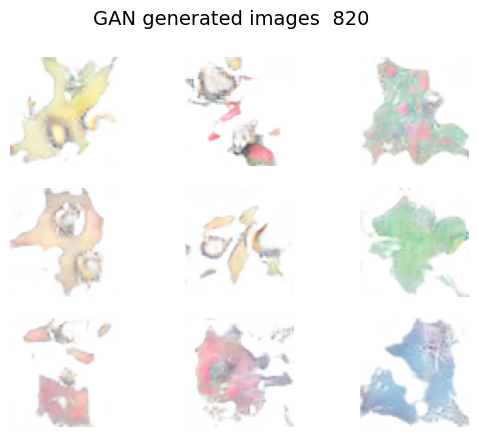

1/1 [==============================] - 0s 18ms/step


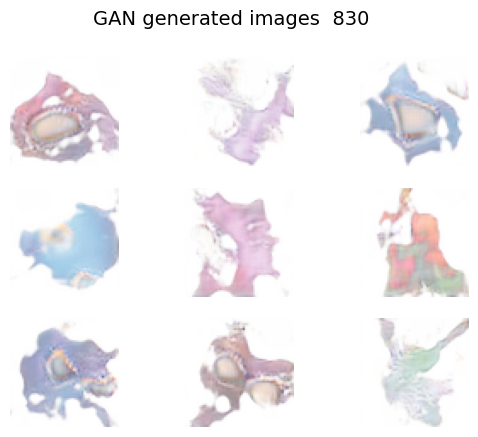

1/1 [==============================] - 0s 19ms/step


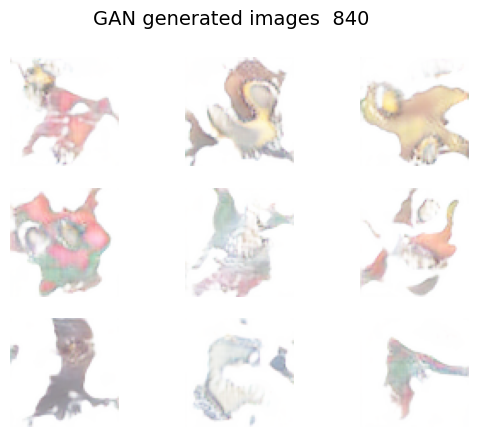

1/1 [==============================] - 0s 18ms/step


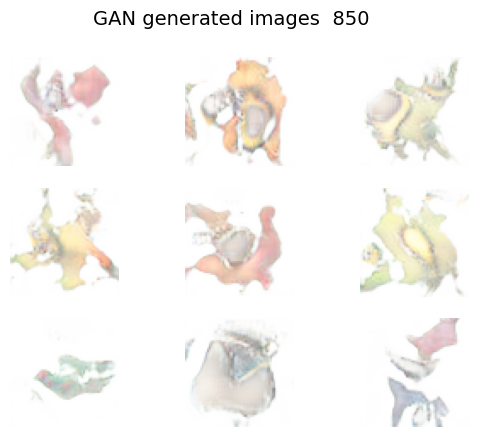

1/1 [==============================] - 0s 19ms/step


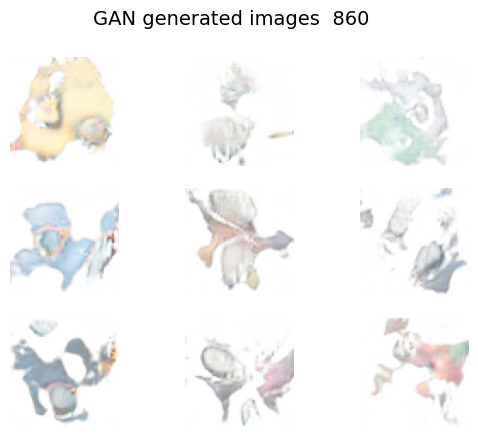

1/1 [==============================] - 0s 26ms/step


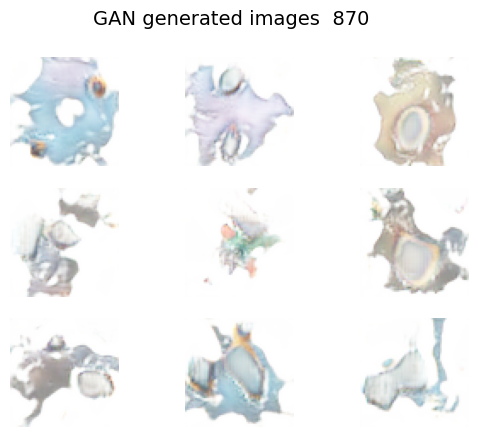

1/1 [==============================] - 0s 27ms/step


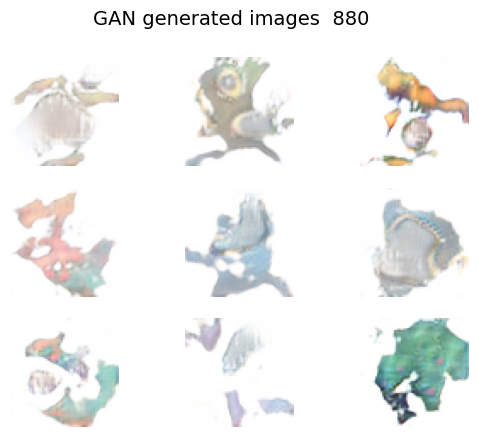

1/1 [==============================] - 0s 21ms/step


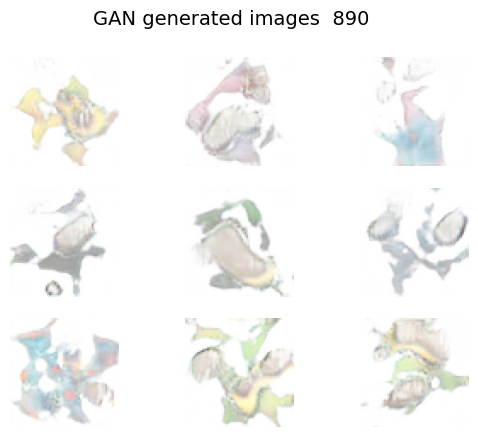

1/1 [==============================] - 0s 17ms/step


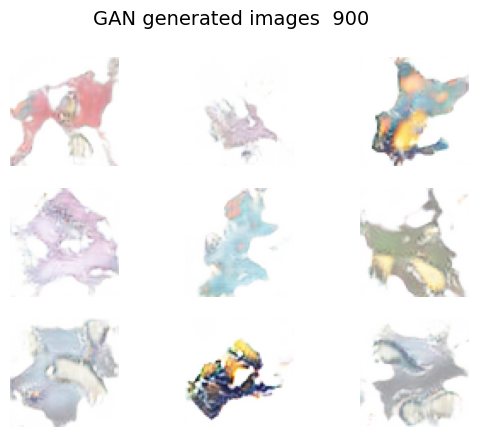

1/1 [==============================] - 0s 20ms/step


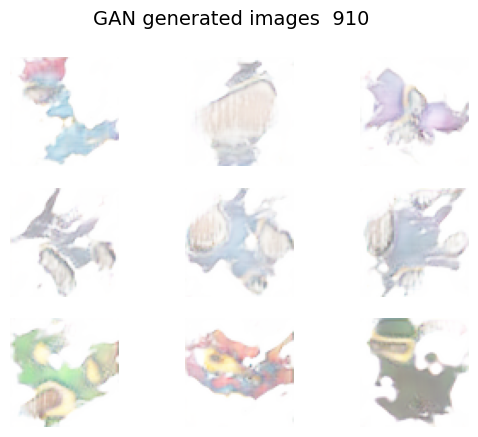

1/1 [==============================] - 0s 17ms/step


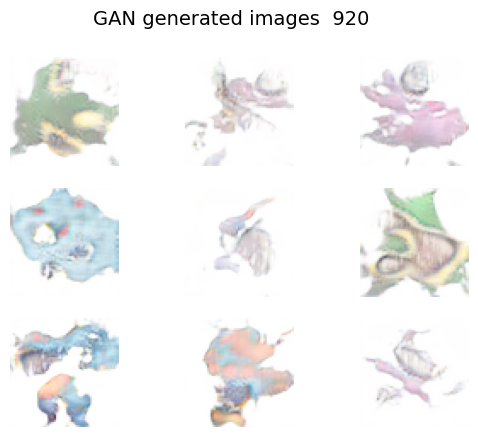

1/1 [==============================] - 0s 18ms/step


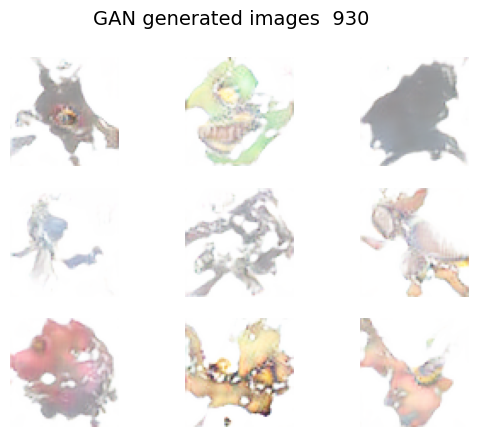

1/1 [==============================] - 0s 17ms/step


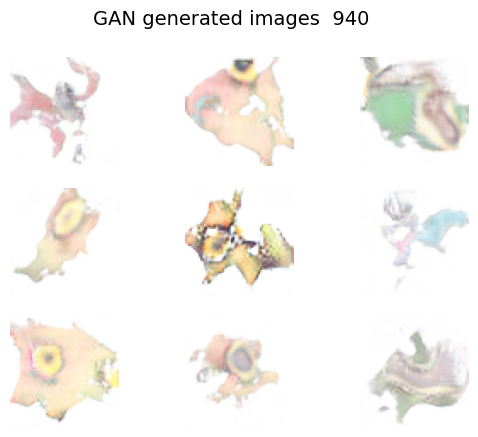

1/1 [==============================] - 0s 17ms/step


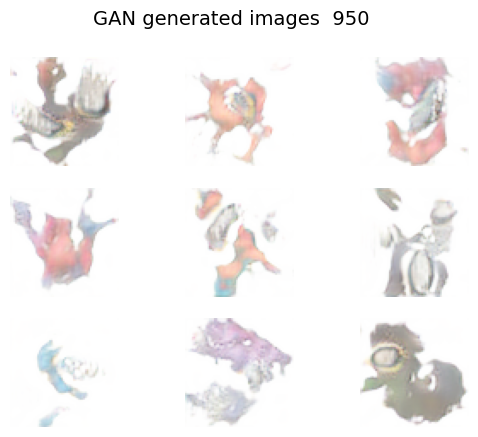

1/1 [==============================] - 0s 28ms/step


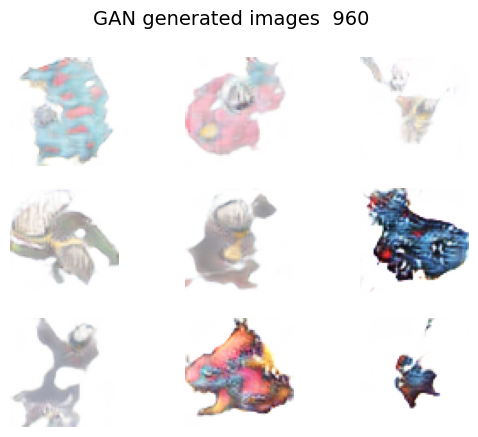

1/1 [==============================] - 0s 26ms/step


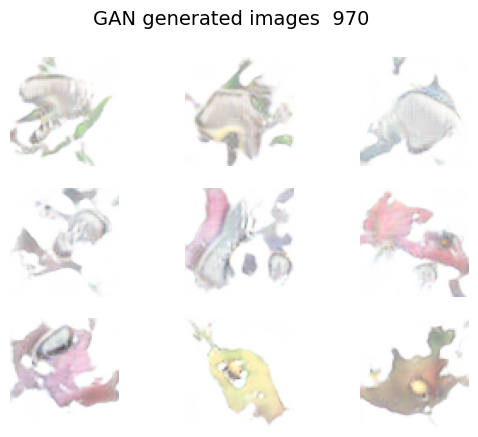

1/1 [==============================] - 0s 20ms/step


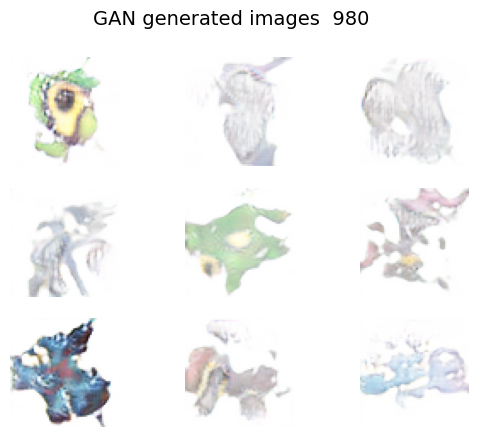

1/1 [==============================] - 0s 17ms/step


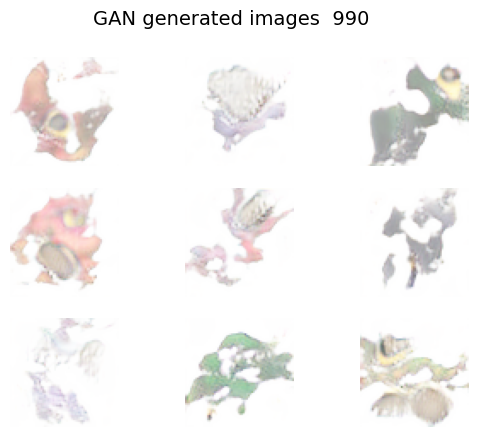

1/1 [==============================] - 0s 18ms/step


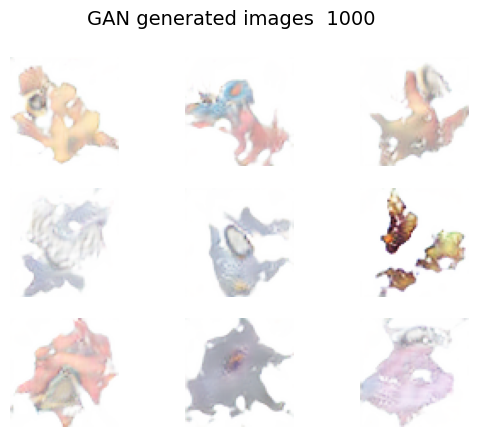

1/1 [==============================] - 0s 18ms/step


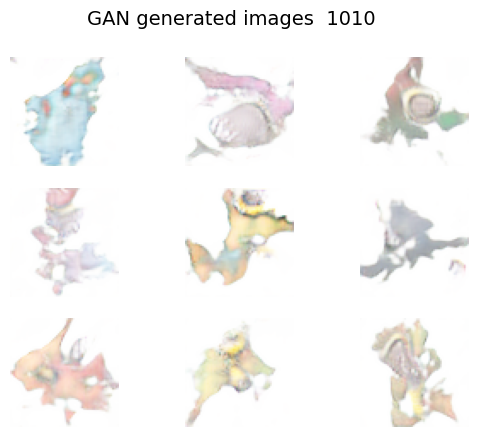

1/1 [==============================] - 0s 19ms/step


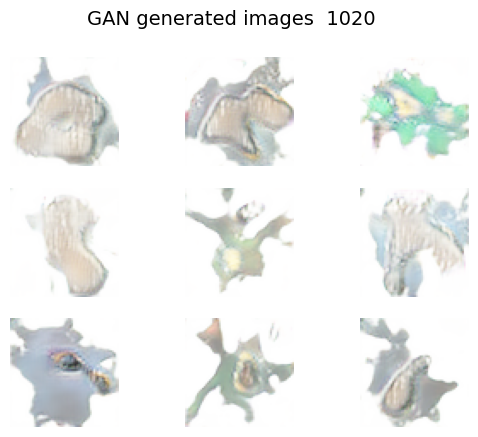

1/1 [==============================] - 0s 19ms/step


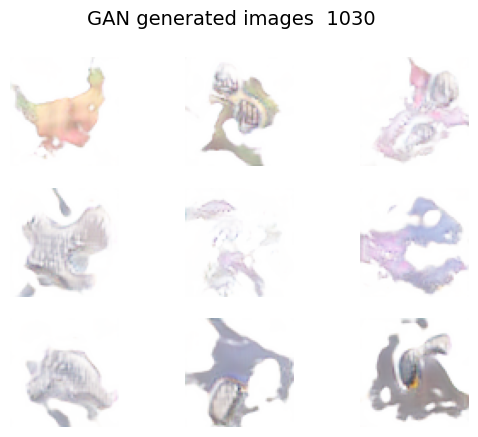

1/1 [==============================] - 0s 17ms/step


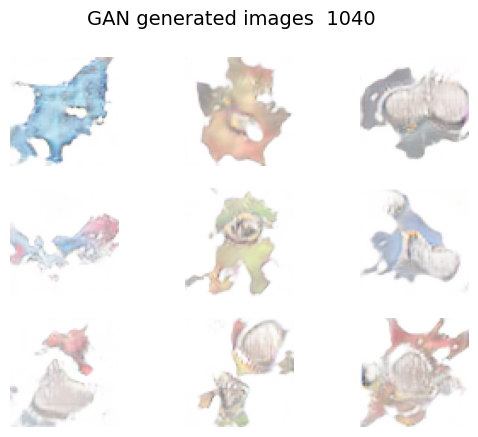

1/1 [==============================] - 0s 37ms/step


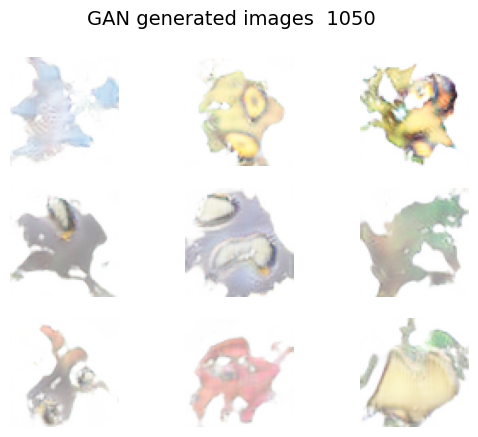

1/1 [==============================] - 0s 34ms/step


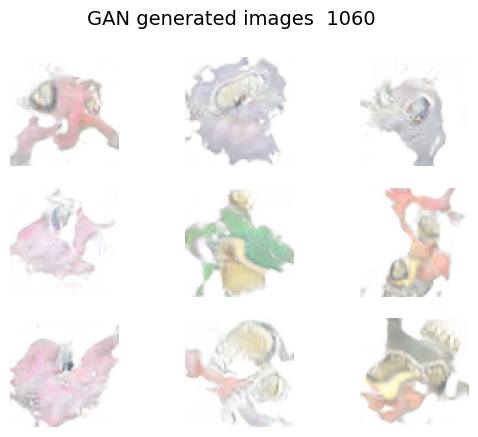

1/1 [==============================] - 0s 27ms/step


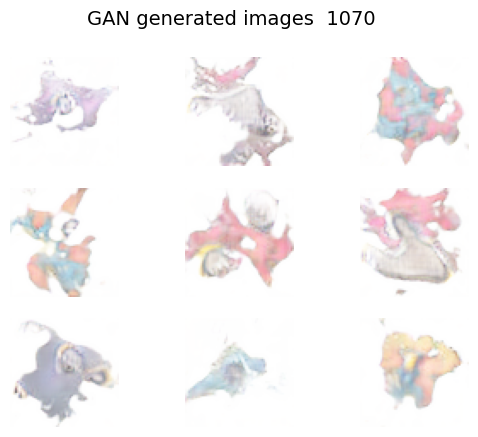

1/1 [==============================] - 0s 29ms/step


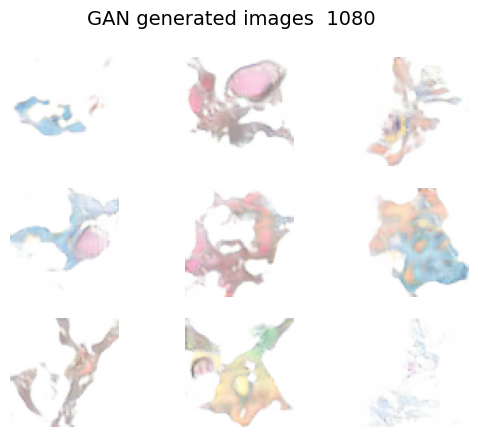

1/1 [==============================] - 0s 18ms/step


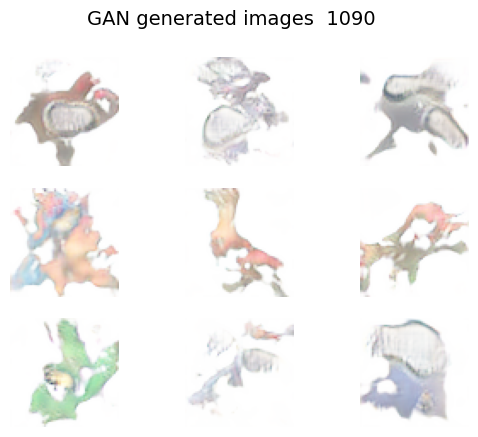

1/1 [==============================] - 0s 17ms/step


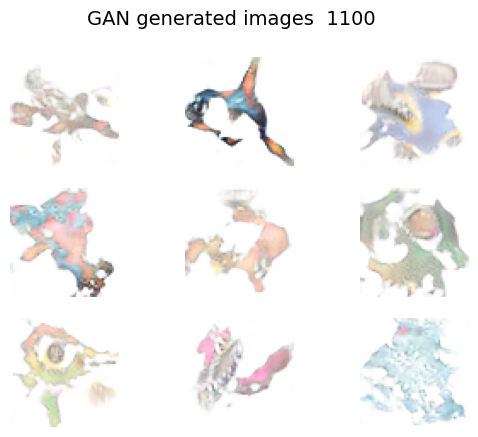

1/1 [==============================] - 0s 17ms/step


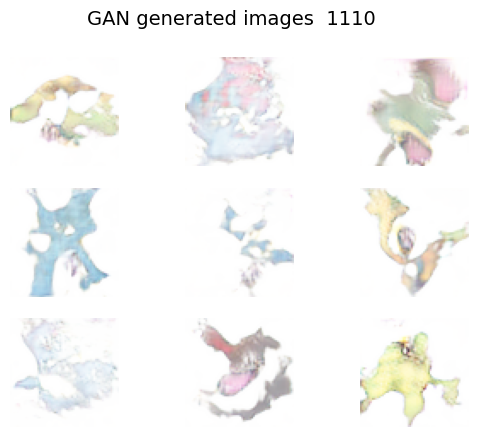

1/1 [==============================] - 0s 17ms/step


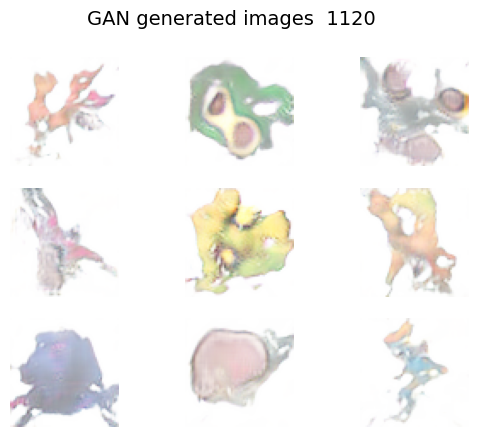

1/1 [==============================] - 0s 18ms/step


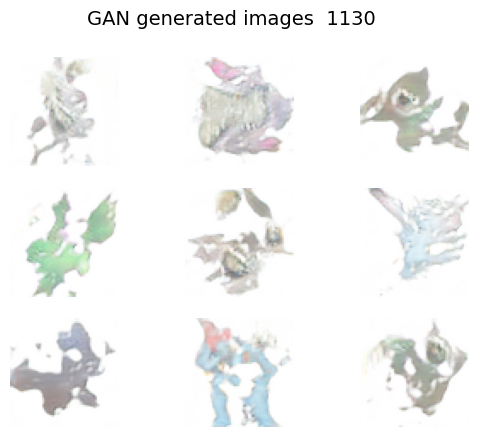

1/1 [==============================] - 0s 18ms/step


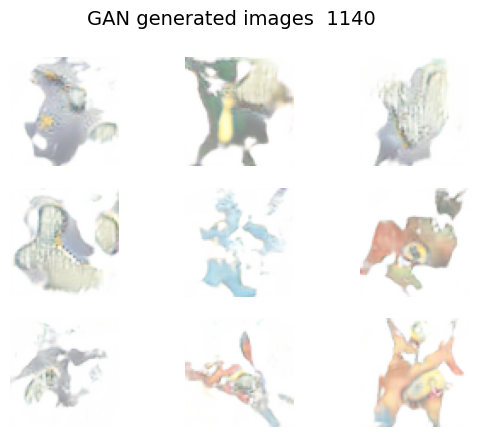

1/1 [==============================] - 0s 28ms/step


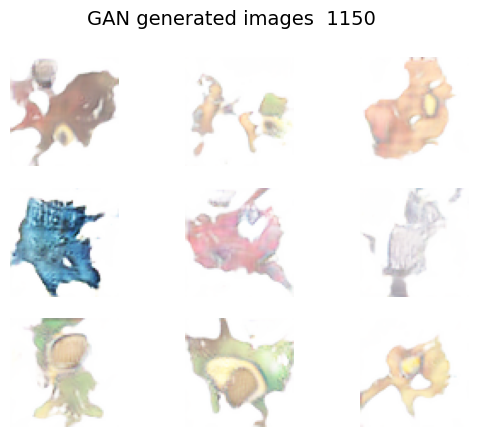

1/1 [==============================] - 0s 18ms/step


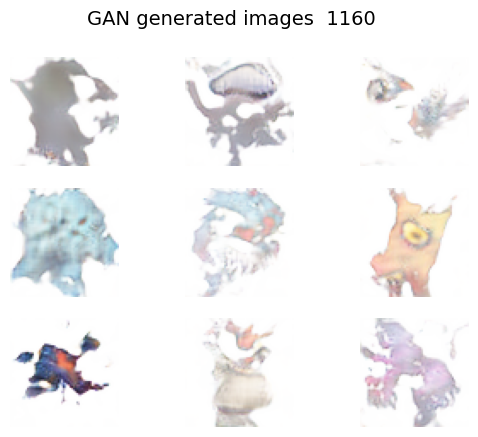

1/1 [==============================] - 0s 18ms/step


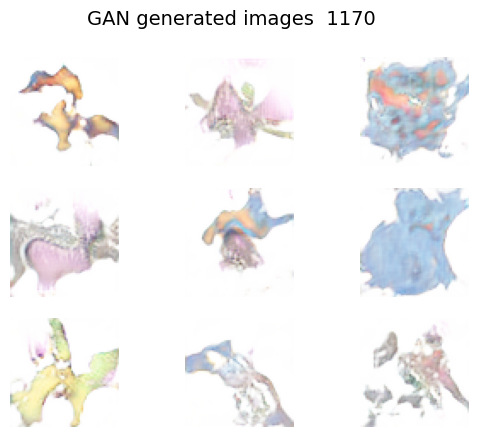

1/1 [==============================] - 0s 17ms/step


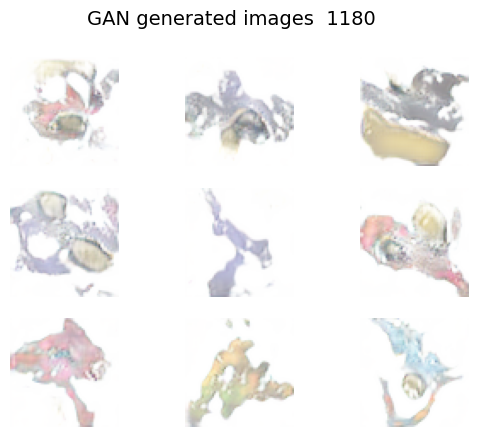

1/1 [==============================] - 0s 20ms/step


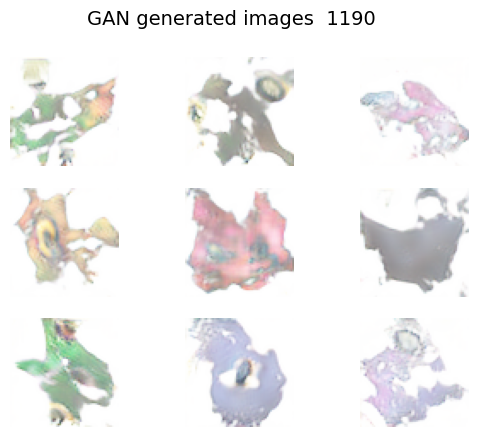

1/1 [==============================] - 0s 17ms/step


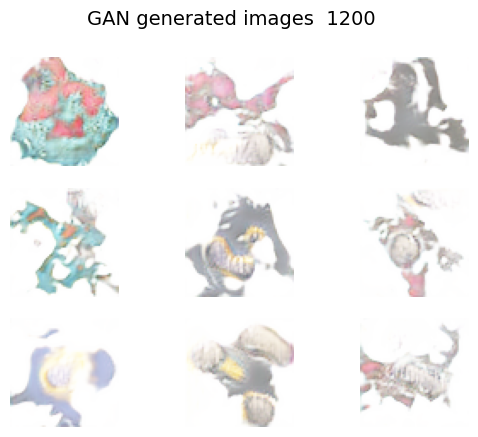

1/1 [==============================] - 0s 18ms/step


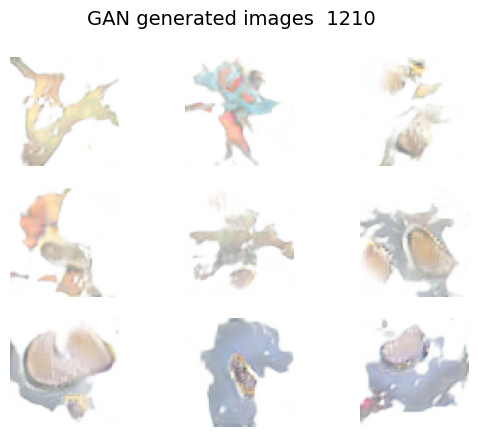

1/1 [==============================] - 0s 18ms/step


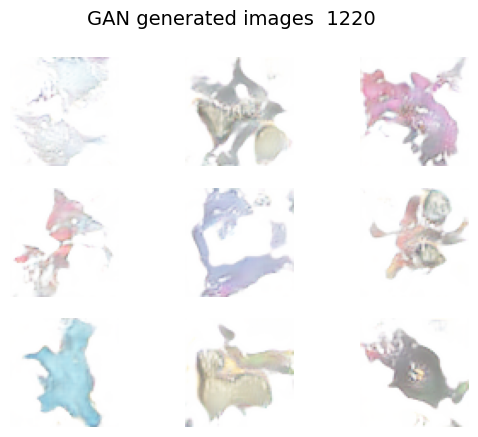

1/1 [==============================] - 0s 17ms/step


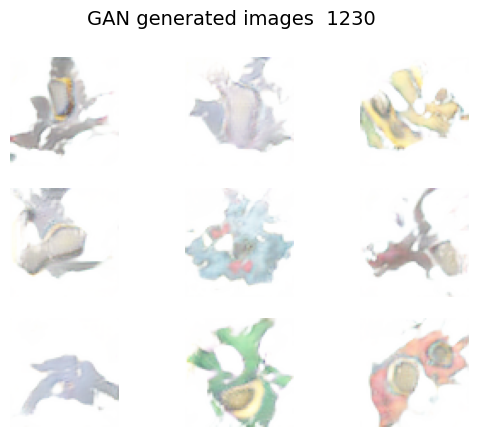

1/1 [==============================] - 0s 27ms/step


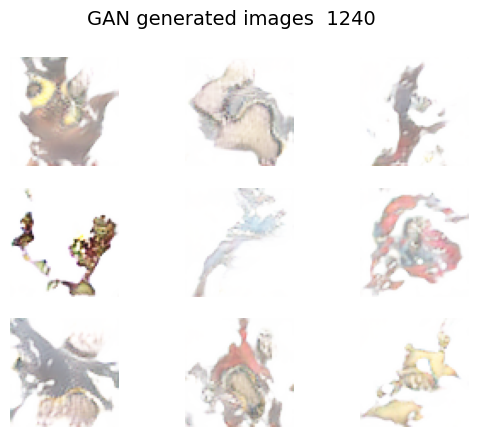

1/1 [==============================] - 0s 26ms/step


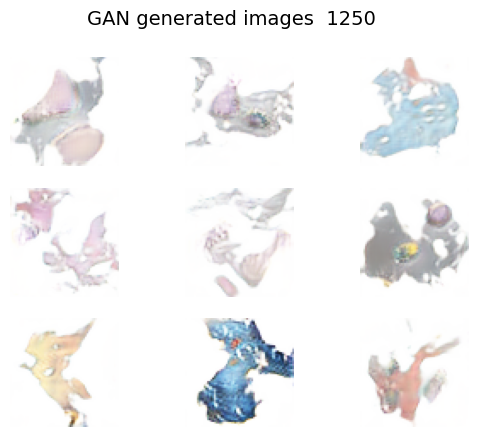

1/1 [==============================] - 0s 26ms/step


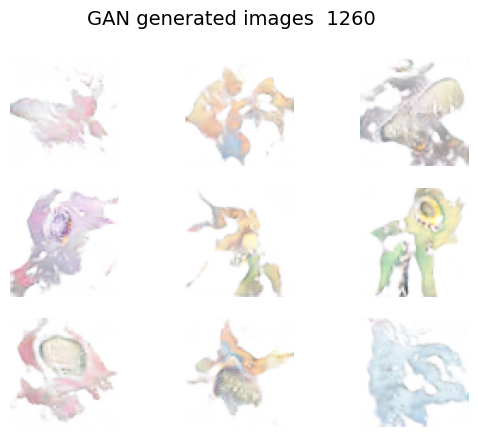

1/1 [==============================] - 0s 20ms/step


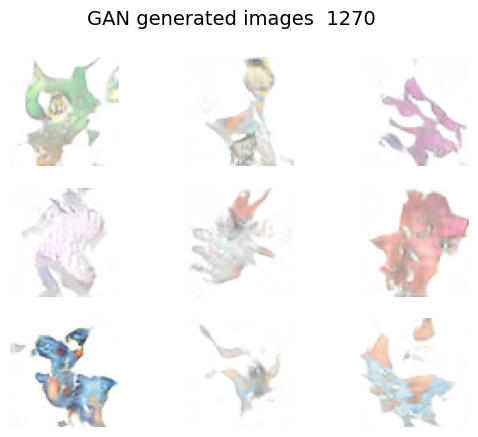

1/1 [==============================] - 0s 18ms/step


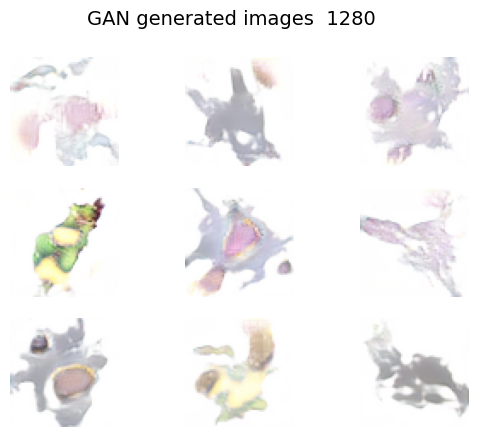

1/1 [==============================] - 0s 17ms/step


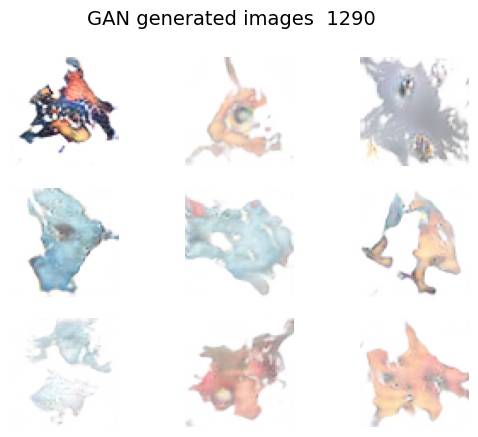

1/1 [==============================] - 0s 18ms/step


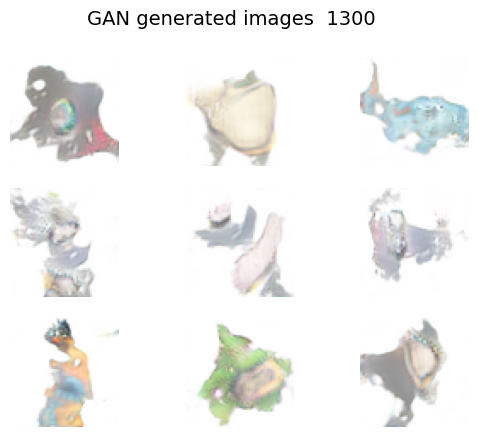

1/1 [==============================] - 0s 18ms/step


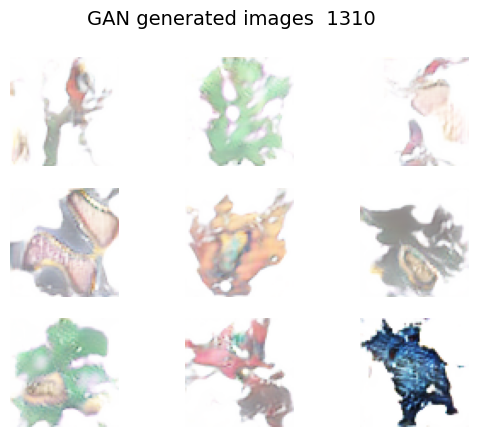

1/1 [==============================] - 0s 22ms/step


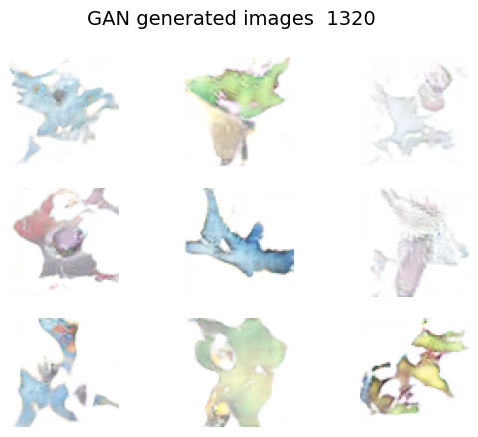

1/1 [==============================] - 0s 22ms/step


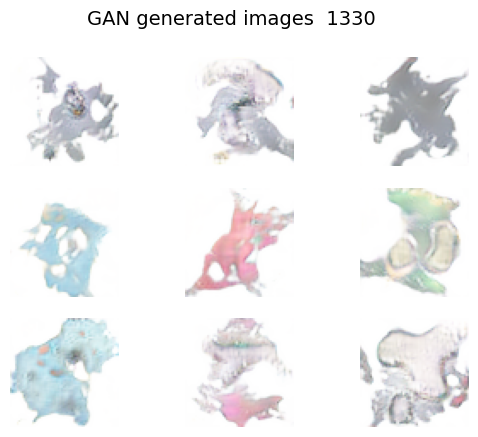

1/1 [==============================] - 0s 32ms/step


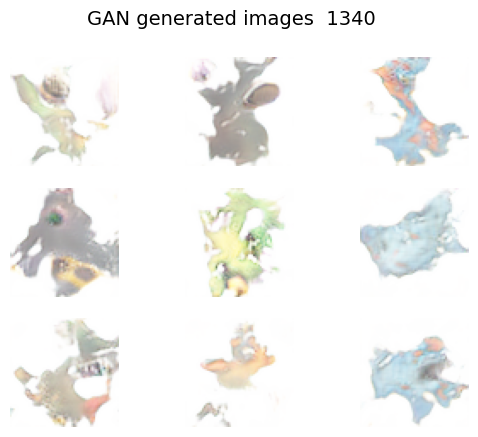

1/1 [==============================] - 0s 29ms/step


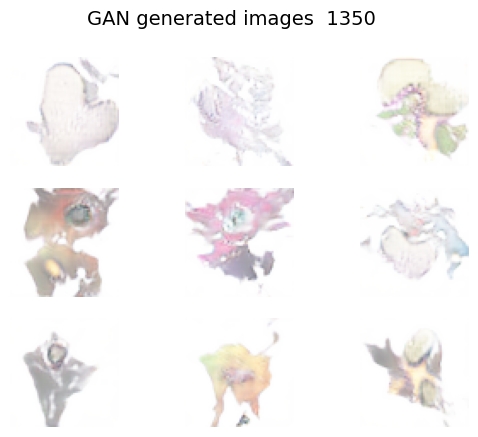

1/1 [==============================] - 0s 34ms/step


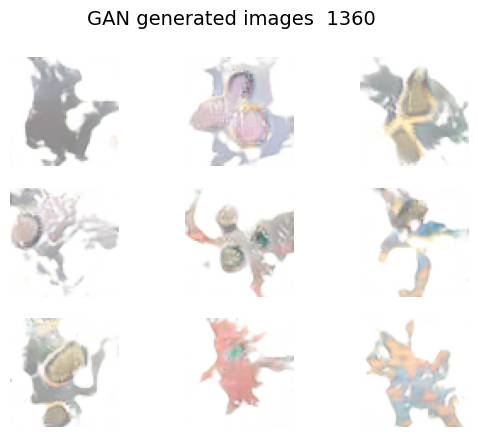

1/1 [==============================] - 0s 17ms/step


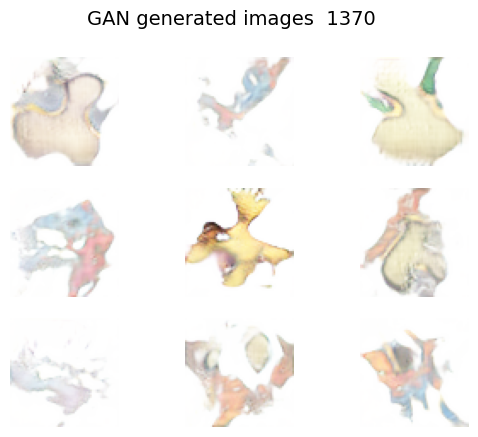

1/1 [==============================] - 0s 17ms/step


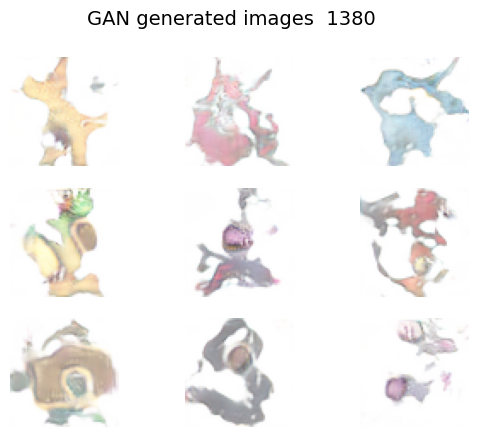

1/1 [==============================] - 0s 22ms/step


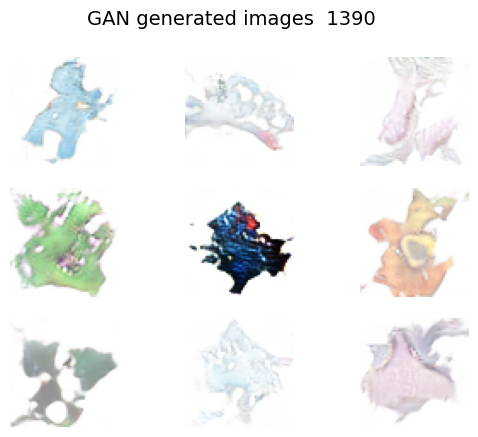

1/1 [==============================] - 0s 18ms/step


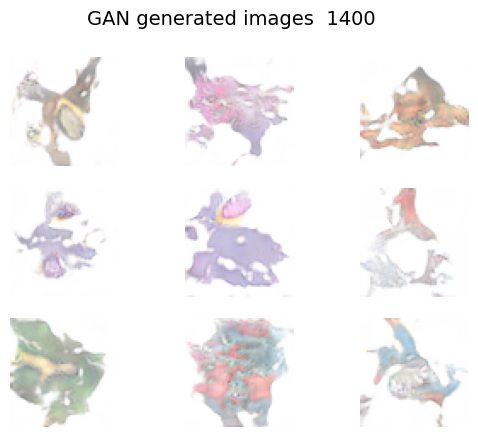

1/1 [==============================] - 0s 21ms/step


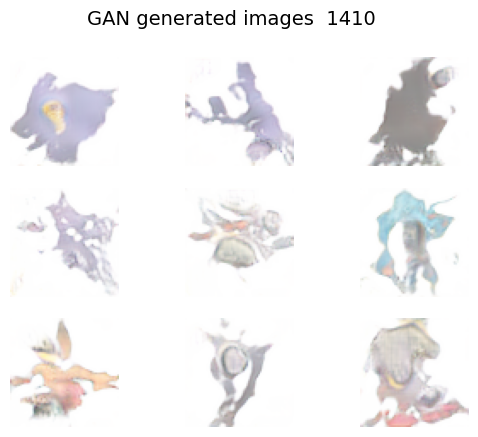

1/1 [==============================] - 0s 18ms/step


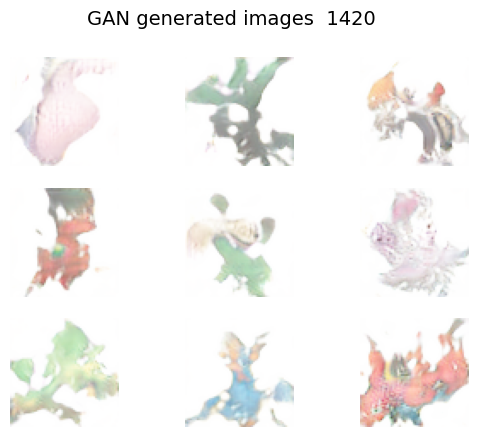

1/1 [==============================] - 0s 18ms/step


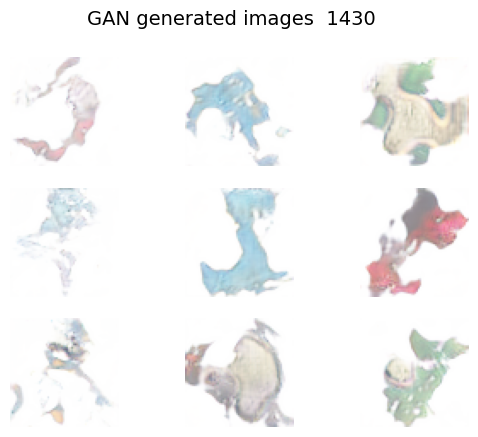

1/1 [==============================] - 0s 18ms/step


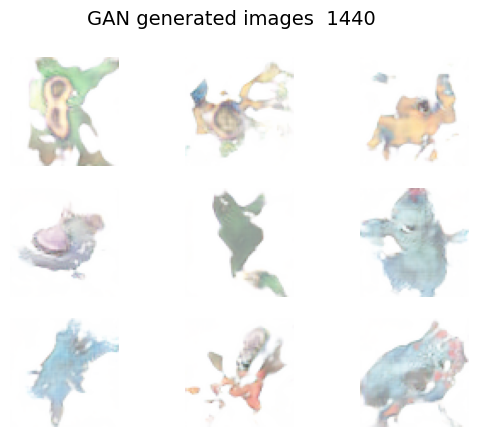

1/1 [==============================] - 0s 26ms/step


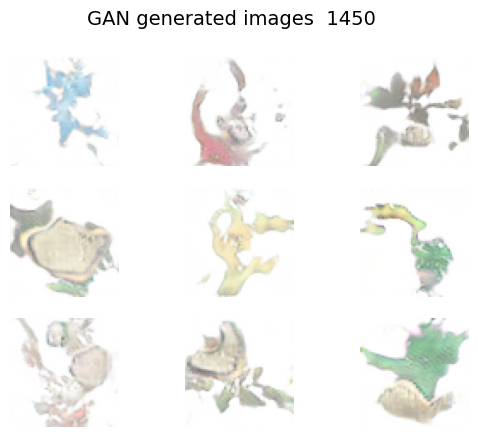

1/1 [==============================] - 0s 29ms/step


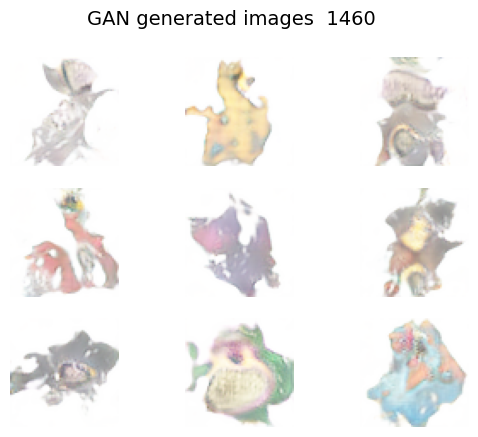

1/1 [==============================] - 0s 20ms/step


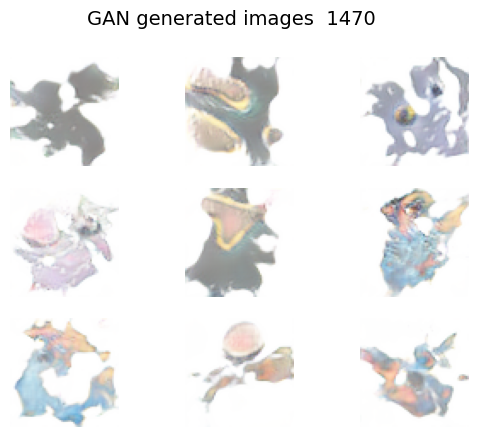

1/1 [==============================] - 0s 17ms/step


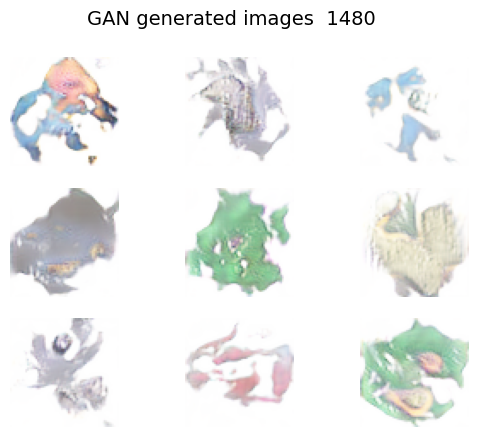

1/1 [==============================] - 0s 18ms/step


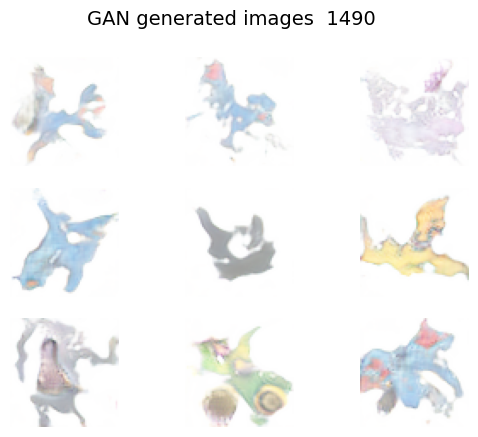

1/1 [==============================] - 0s 18ms/step


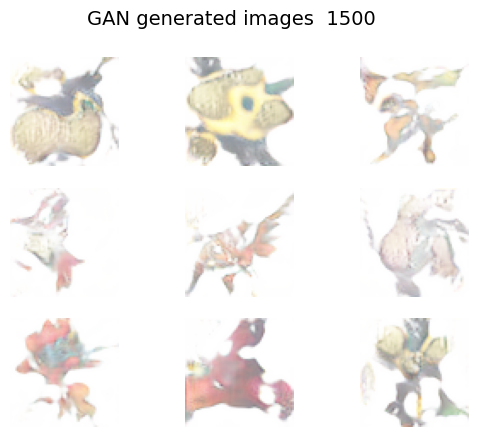

1/1 [==============================] - 0s 17ms/step


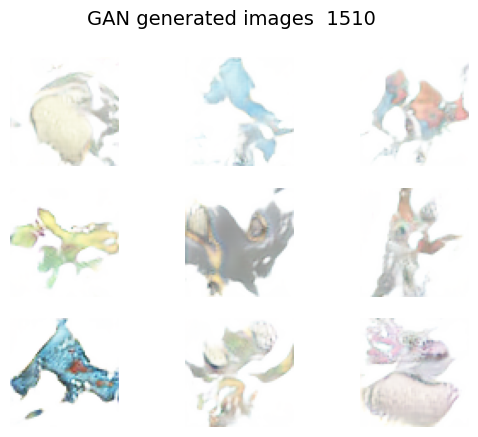

1/1 [==============================] - 0s 21ms/step


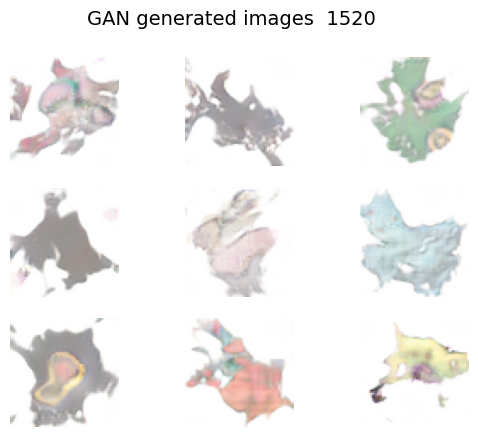

1/1 [==============================] - 0s 19ms/step


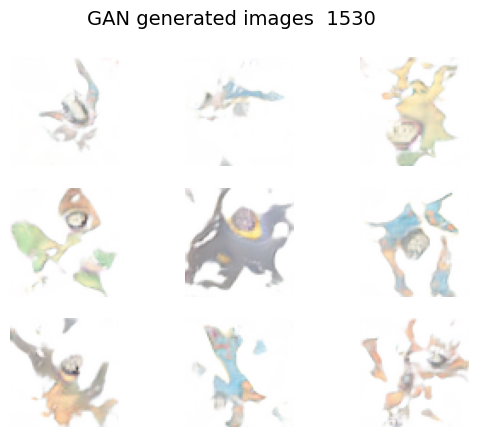

In [ ]:
## Build and train the model (gen_updates =3 and gen lr = 0.00001)
# Epoch 1-1500

latent_dim = 256
dataset_scaled = load_real_samples(scale=True)
combined_dataset = np.concatenate([dataset_scaled, augmented_data], axis=0)


train_gan(generator, discriminator, gan, combined_dataset, latent_dim, n_epochs=2001)

In [ ]:
## Build and train the model (gen_updates =3 and gen lr = 0.00001)
# Epoch 3000-4000

latent_dim = 256
dataset_scaled = load_real_samples(scale=True)
combined_dataset = np.concatenate([dataset_scaled, augmented_data], axis=0)


train_gan(generator, discriminator, gan, combined_dataset, latent_dim, n_epochs=1001)

generator.save_weights("/content/drive/My Drive/Colab Notebooks/best_model_4004epochs_gen_weights.h5")
discriminator.save_weights("/content/drive/My Drive/Colab Notebooks/best_model_4004epochs_disc_weights.h5")
gan.save_weights("/content/drive/My Drive/Colab Notebooks/best_model_4004epochs_gan_weights.h5")

In [ ]:
## Build and train the model (gen_updates =3 and gen lr = 0.00001)
# Epoch 4000-5000

latent_dim = 256
dataset_scaled = load_real_samples(scale=True)
combined_dataset = np.concatenate([dataset_scaled, augmented_data], axis=0)


train_gan(generator, discriminator, gan, combined_dataset, latent_dim, n_epochs=1001)

generator.save_weights("/content/drive/My Drive/Colab Notebooks/best_model_5005epochs_gen_weights.h5")
discriminator.save_weights("/content/drive/My Drive/Colab Notebooks/best_model_5005epochs_disc_weights.h5")
gan.save_weights("/content/drive/My Drive/Colab Notebooks/best_model_5005epochs_gan_weights.h5")

In [ ]:
## Build and train the model (gen_updates =3 and gen lr = 0.00001)
# Epoch 5000-6000

latent_dim = 256
dataset_scaled = load_real_samples(scale=True)
combined_dataset = np.concatenate([dataset_scaled, augmented_data], axis=0)


train_gan(generator, discriminator, gan, combined_dataset, latent_dim, n_epochs=1001)

generator.save_weights("/content/drive/My Drive/Colab Notebooks/best_model_6006epochs_gen_weights.h5")
discriminator.save_weights("/content/drive/My Drive/Colab Notebooks/best_model_6006epochs_disc_weights.h5")
gan.save_weights("/content/drive/My Drive/Colab Notebooks/best_model_6006epochs_gan_weights.h5")

# Interpolation

With interpolation, we gradually change the values of features between an interval.
We will first start by only interpolating one out of 256 features. This may highlight the fact that one specific feature has a discernible impact on the model.
We will interpolate between -3, 3 because the random values we used to train the GAN were mostly on interval [-3, 3], as we used a standard normal to generate the features.

# One feature

1/1 [==============================] - 0s 39ms/step


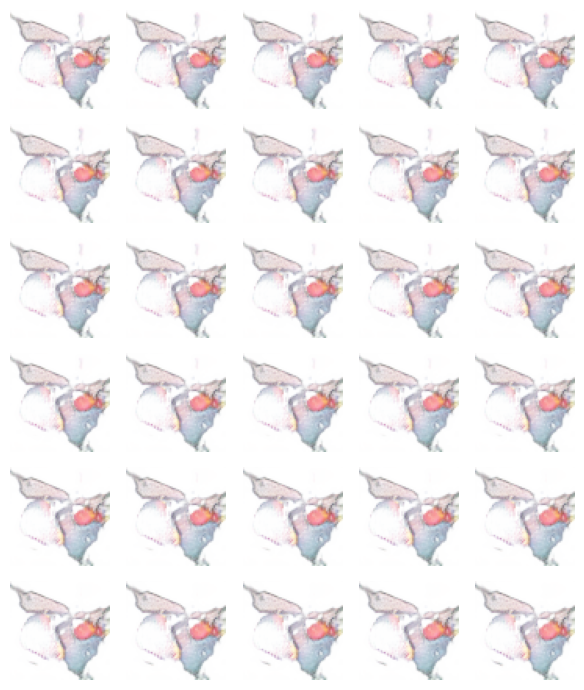

In [ ]:
latent_dim = 256
fixDim = np.random.randn(latent_dim-1) #generate 255 random features
interp = np.arange(-3, 3, 0.1) #range that covers ~99% values in standard normal support

def interp_generator(generator, modDim):

    generator_input = np.concatenate(([modDim], fixDim)) #join interpolated and random features
    generator_input = np.expand_dims(generator_input, axis=0)

    return generator.predict(generator_input)

# Generate images using interpolated latent vectors
generated_images = [interp_generator(generator, i)[0] for i in interp] #compute feature space for all increments

plot_images_in_grid(generated_images, 6, 5, (6,7))

We only observe a very minor change. Clearly, only changing one out of 256 values does not lead to a large difference, even over the entire interval.

## All features -3 to +3

This is the most extreme approach. We will apply the same interpolation as before to every feature. This approach has a certain structural nature, which may provide an interesting pattern.

1/1 [==============================] - 0s 38ms/step


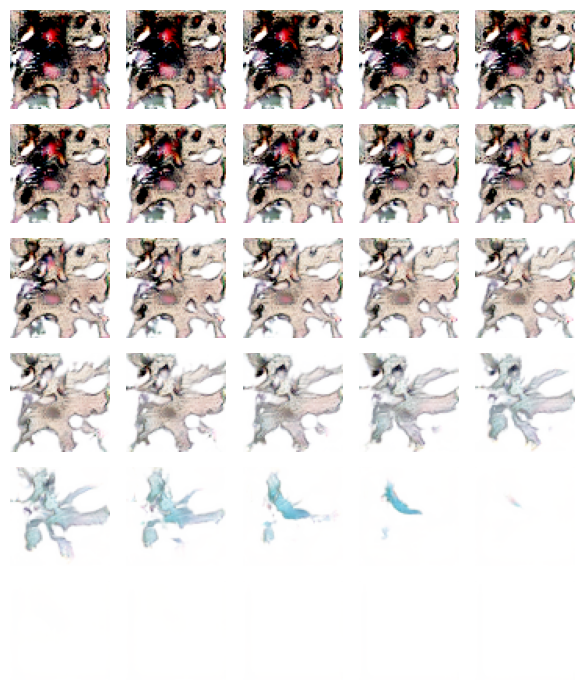

In [ ]:
latent_dim = 256
interp = np.arange(-3, 3, 0.1)

def interp_generator(generator, modDim):

    generator_input = np.full((latent_dim,), modDim) #make vector filled with only interpolation increment
    generator_input = np.expand_dims(generator_input, axis=0)

    return generator.predict(generator_input)

# Generate images using interpolated latent vectors
generated_images = [interp_generator(generator, i)[0] for i in interp] #compute for each increment

plot_images_in_grid(generated_images, 6, 5, (6,7))




What is somewhat noticeable is that the entire image is almost filled with dark colours at -3, and its entirely blank at +3
This suggests that the ranges of values that the GAN saw in training (which were mostly on interval [-3, 3]) have taught the weights that these are the two extremes approximately. Thus, inserting these values in their absolute form, will go between the two extremes that the model can generate; all black, all white

## Interpolation between two random images

Lastly, we will produce the perhaps most interesting interpolation. We will generate two random feature spaces and then linearly interpolate each feature separately between the two spaces.

1/1 [==============================] - 0s 67ms/step


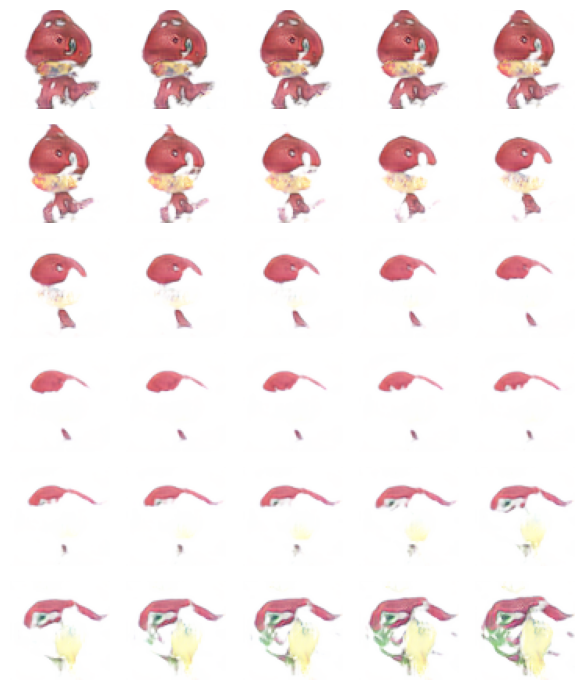

In [ ]:
latent_dim = 256
dim1 = np.random.randn(latent_dim) #make first random feature space
dim2 = np.random.randn(latent_dim) #make second random feature space

def valInterp(a, b, k): #function interpolates over k increments between two values a, b
    diff = b - a
    return [a + (diff / k) * i for i in range(0, k)]

def imgInterp(dim1, dim2, k): #does interpolation for each feature separately between two generated feature spaces
    return np.matrix([valInterp(dim1[i], dim2[i], k) for i in range(0, latent_dim)]).T

def interpGen(generator, latDim):
    return generator.predict(latDim)

# Generate images using interpolated latent vectors

latVecs = imgInterp(dim1, dim2, 30)

generated_images = [interpGen(generator, i) for i in latVecs] #generates image for each interpolation increment

# Reshape the images
generated_images = [np.reshape(img, (64, 64, 3)) for img in generated_images] #transformation

plot_images_in_grid(generated_images, 6, 5, (6,7))


By doing this, we see that the Pokémon gradually changes its shape, colour, and features. This is particularly fun in the realm of Pokémon, as it mimics the evolution of Pokémon.

# 3.5

CAE

At first, we were provided with a CAE, which is based on a convolutional and deconvolutional network, stitched together by a latent feature space, which reduces the image to a compressed representation.
The encoder consists of convolutional layers that gradually reduce the spatial dimensions of the input image while learning to capture important features and representations.
Using a mirrored structure, the decoder then upsamples the latent space representation using transposed convolutional layers to reconstruct the original input image.
Given the cross-entropy loss function, the CAE learns to minimise the difference between the input image and the reconstructed image. This loss encourages the model to learn a meaningful representation of the data in the latent space.

VAE

Based on this foundation, we proceeded with the VAE, which expands on these ideas by specifying probabilistic parameters. These distributions are used when training the latent features and are thus also applied in the decoding process. With this, the VAE uses a reparameterization trick to sample points from the learned distribution in a differentiable way, allowing backpropagation during training. This is achieved by approximating the latent vector by sampling from the prior distribution and adding a noise component based on the standard deviation of the distribution. By doing this, we also maintain the stochasticity of the latent vector. As we have incorporated probabalistic components, the loss function must also be modified. For this the Kullback-Leibler between the computed distribution and the prior is computed and scaled by the inverse of the latent vector's dimensionality. By doing this, the learned latent space distribution is encouraged to tend towards the prior distribution.

GAN

Lastly, we join some of the previous elements to develop a GAN. The GAN mainly consists of a generator and a discriminator. The generator network takes random noise as input and generates images based on the learned deconvolutional network. It aims to generate samples that are indistinguishable from real data. To assure said indistinguishability, the discriminator is trained. The discriminator network is (typically) a CNN tasked with classifying images as real or fake. Training of the GAN is achieved with a so-called adversarial approach. This two-step approach trains discriminator and generator separately.

In the first step, the discriminator network is trained, while the generator network is kept fixed. The discriminator is trained using a dataset that includes real data samples and fake data samples generated by the current state of the generator generator. The discriminator's loss is computed to guide it toward better discriminating between real and fake samples. This binary cross-entropy loss encourages the discriminator to output high values for real data and low values for fake data.

In the second step, the generator network is trained while the discriminator is fixed. The generator is trained to produce data samples that are more likely to fool the discriminator. The generator's loss is computed based on the output of the discriminator when provided with fake data samples generated by the generator. The generator seeks to optimise the discriminator's output for its generated samples, effectively minimising the discriminator's ability to distinguish between real and fake data.

This alternating process is repeated to optimise both the discerning abilities of the discriminator, and also the generating abilities of the generator.

Differences

These three models all have a slightly different objective: CAEs are used for dimensionality reduction and feature learning, as they aim to output the input as accurately as possible. VAEs are probabilistic and can use this to generate samples based on the latent space. GANs behave similarly, but have been found to be even stronger when it comes to image generation. This is in part due to the unique training approach; while CAEs and VAEs ultimately just compute loss based on the difference between input and output, GANs are trained through adversarial loss, which encourages the model to become very good and generating. In summation, all these models use a basis of convolutional networks to learn a latent feature space which aims to extract information from the source most efficiently. This space is then used in conjunction with a convolutional network to produce the desired data.

Using these techniques, we trained a GAN which produces images. These images were then analysed to see if they resemble a Pokémon. With this process, we manage to both train the weights of the GAN generator to make more convincing Pokémon, and also the accuracy of the GAN discriminator when discriminating between real and fake Pokémon.